# MEG Functional Connectivity Simulations

## Setup

Importage

In [1]:
# Generic stuff
import os,sys,glob, numpy as np, pandas as pd
from scipy.io import loadmat
from itertools import product
from scipy.interpolate import interp1d
from copy import deepcopy

# Viz stuff
%matplotlib inline
from matplotlib import pyplot as plt
from IPython.display import clear_output

# CTWC model code
sys.path.append('../ctwc')
from ctwc_model import run_net_sim

/nethome/kcni/jgriffiths/Software/miniconda3/envs/jupyter_py3/lib/python3.7/site-packages/sklearn/externals/joblib/__init__.py:15: DeprecationWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=DeprecationWarning)


In [14]:
ls ../ctwc/

ctwc_model.py  __pycache__/


Define some variables

In [2]:
cv = 4.

# this rearanges the l2k8 indices to match the sorted aparc labels used in the meg analysis

l2k8_to_aparc_sort_idx = np.array([22, 21, 20, 23, 18, 17, 19, 14, 24, 30, 16, 28, 10, 25, 15, 13, 29,
       32, 31,  9, 26, 33, 27,  8,  5, 12,  7,  4,  3, 11,  0,  1,  6,  2,
       64, 62, 63, 65, 60, 59, 61, 56, 66, 72, 58, 70, 67, 71, 52, 57, 55,
       74, 73, 51, 68, 75, 69, 50, 47, 54, 49, 46, 53, 42, 43, 45, 48, 44])

orig_to_abey_idx = np.array([46, 32, 50, 58, 16,  6, 22, 42, 26, 20, 12, 34, 16,  8, 64, 18, 60,
       66, 30,  0, 62, 44, 48,  4, 56,  2, 54, 36, 40, 38, 24, 28, 52, 10,
       47, 33, 51, 59, 15,  7, 23, 43, 27, 21, 13, 35, 17,  9, 65, 19, 61,
       67, 31,  1, 63, 45, 49,  5, 57,  3, 55, 37, 41, 39, 25, 29, 53, 11])

l2k8_to_abey_idx = np.array([13, 10, 19, 17, 28, 20, 22, 21, 23, 14, 24, 25, 28, 26, 27, 33, 31,
       32, 29, 30, 16, 15,  9,  8,  7, 12,  6,  5,  4,  1,  0,  3, 11,  2,
       55, 52, 61, 59, 60, 62, 64, 63, 65, 56, 66, 67, 70, 68, 69, 75, 73,
       74, 71, 72, 58, 57, 51, 50, 49, 54, 48, 47, 46, 43, 42, 45, 53, 44])

l2k8_in_orig = np.array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58,
       59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75])


sfreq = 1000.    
freq_bands = {'delta': (2, 4),
              'theta': (5, 7),
              'alpha': (8, 12),
              'beta': (15, 29),
              'gamma': (30, 45)}

freqs = freq_bands.keys()

Define some functions

In [3]:
# Neuronal response function
def sig_f(u,gain=25,threshold=0.):
        output= 1./(1.+exp(-gain*(u-threshold))); 
        return output 

In [4]:
def aec(data,sfreq,freq_bands):
    
    # data is  ROI x TIME
    # freq bands is a dict of (lower,upper) freq tuples

    # modified from 
    # https://martinos.org/mne/dev/auto_tutorials/plot_modifying_data_inplace.html
    
    nr = data.shape[0]

    ch_names = [str(s) for s in range(0,nr)]
    ch_types = ['eeg' for _ in ch_names]
    info = mne.create_info(ch_names, sfreq, ch_types=ch_types)
    raw = mne.io.RawArray(data.copy(),info)
    
    AEs = {}

    for freq_band,(lfreq,hfreq) in freq_bands.items():
        raw_band = raw.copy()
        raw_band.filter(lfreq, hfreq, l_trans_bandwidth=2., h_trans_bandwidth=2.,
                        fir_design='firwin')
        
        
        
        raw_hilb = raw_band.copy()
        hilb_picks = mne.pick_types(raw_band.info, meg=False, eeg=True)
        raw_hilb.apply_hilbert(hilb_picks)

        print(raw_hilb[0][0].dtype)

        # Take the amplitude and phase
        raw_amp = raw_hilb.copy()
        raw_amp.apply_function(np.abs, hilb_picks)
        raw_phase = raw_hilb.copy()
        raw_phase.apply_function(np.angle, hilb_picks)

        AEC = raw_amp.to_data_frame().corr()


        
        
        # leakage correction version
        raw_band_lc = raw_band.copy()
        raw_band_lc._data = closest_ortho_matrix(raw_band_lc.get_data().copy())
        
        clear_output()
        
        
        raw_hilb_lc = raw_band_lc.copy()
        hilb_picks = mne.pick_types(raw_band_lc.info, meg=False, eeg=True)
        raw_hilb_lc.apply_hilbert(hilb_picks)

        print(raw_hilb[0][0].dtype)

        # Take the amplitude and phase
        raw_amp_lc = raw_hilb_lc.copy()
        raw_amp_lc.apply_function(np.abs, hilb_picks)
        raw_phase_lc = raw_hilb_lc.copy()
        raw_phase_lc.apply_function(np.angle, hilb_picks)

        AEC_lc = raw_amp_lc.to_data_frame().corr()
        
        
        AEs[freq_band] = {'raw_filtered': raw_band, 
                          'ae': raw_amp, 
                          'phase': raw_phase,
                          'aec': AEC,
                          'raw_filtered_lc': raw_band_lc, 
                          'ae_lc': raw_amp_lc,
                          'phase_lc': raw_phase_lc,
                          'aec_lc': AEC_lc}

        
    return AEs,raw

## Load SC data

In [5]:
l2k8_w = np.loadtxt('../data/hcp_grpavg_l2k8_sc33_weights.npy')

l2k8_tl = np.loadtxt('../data/hcp_grpavg_l2k8_sc33_tractlengths.npy')

df_l2k8_w = pd.DataFrame(l2k8_w)

df_l2k8_tl = pd.DataFrame(l2k8_tl)

df_l2k8_w *= ((np.eye(83)*-1) + 1)
df_l2k8_wlog = np.log1p(df_l2k8_w)

df_l2k8_wlog_divmax = df_l2k8_wlog.copy()
df_l2k8_wlog_divmax/= df_l2k8_wlog.max()


df_l2k8_del = df_l2k8_tl / cv

_df_d = df_l2k8_del.copy()
_df_d[df_l2k8_wlog_divmax<0.2] = 0.

_df_w = df_l2k8_wlog_divmax.copy()
_df_w[_df_w<0.2] = 0

## Load MEG data

In [8]:
goodsubs = [912447,990366,898176,715950,105923]

subs = np.loadtxt('../data/S95_MEG.txt').astype(int)
#subs

freqs = ['delta', 'theta', 'alpha', 'beta', 'gamma']

"""
aec_mean = {f: np.zeros([68,68]) for f in freqs}
aec_abs_mean = {f: np.zeros([68,68]) for f in freqs}


wd_dir = '/hecuba/mcintosh_lab/john/VM_Code/libraries_of_mine/github/workdocs/masters/meeg/hcp'

cnt = 0
for sub in goodsubs:#subs:
    f1 = wd_dir + '/test3/%s_df_rs_aec_mean.pkl' %sub
    f2= wd_dir + '/test3/%s_df_rs_aec_abs_mean.pkl' %sub    
    if os.path.isfile(f1):
        cnt+=1
        df1 = pd.read_pickle(f1)
        df2 = pd.read_pickle(f2)        
        for freq in freqs:
            mat = df1.loc[freq].values
            aec_mean[freq] += mat
            mat = df2.loc[freq].values
            aec_abs_mean[freq] += mat
for freq in freqs:
    aec_mean[freq] /= cnt
    aec_abs_mean[freq] /= cnt
""";

In [9]:
fnamestr = '../data/all_aec_lc_means_mean_%s_test.npy'
all_aec_lc_means_mean = {k: np.load(fnamestr %k) for k in freqs}
    
#fnamestr = '../data/all_aec_means_mean_%s_test.npy'
#all_aec_means_mean = {k: np.load(fnamestr %k) for k in freqs}

In [10]:
def make_mat_plots(res_aecs,vmax=0.4):
    
    fig, ax = plt.subplots(ncols=5,nrows=3, figsize=(18,9))


    a1,a2,a3 = ax[0][0],ax[1][0],ax[2][0]
    freq = 'delta'
    mat1 = aec_mean[freq]
    mat1 = mat1[orig_to_abey_idx,:][:,orig_to_abey_idx]
    #fig, ax = plt.subplots(ncols=2,figsize=(8,3))
    sns.heatmap(mat1,xticklabels='',yticklabels='',ax=a1,vmin=0,vmax=0.2,cmap='viridis',mask=np.eye(68))#,mask=mat<0.1)
    a1.set_title('%s (%s-%sHz)\n' %(freq,freq_bands[freq][0],freq_bands[freq][1]),fontsize=20)
    mat2 = res_aecs[0][freq]['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
    sns.heatmap(mat2,xticklabels='',yticklabels='',ax=a2,cmap='viridis',mask=np.eye(68),vmin=0,vmax=vmax)
    mat3 = df_l2k8_wlog.values[l2k8_in_orig,:][:,l2k8_in_orig]
    df = pd.DataFrame([np.triu(mat1,1).ravel(), np.triu(mat2,1).ravel(), np.triu(mat3,1).ravel()],
                      index=['data', 'model', 'dwi']).T
    df = df[df.model>0]
    sns.regplot(x="data", y="model", data=df,scatter_kws={'alpha': 0.5,'s':1.,'marker': '.'},color='k', ax=a3)
    dfc = df[df.data.abs()>0.1].corr()['data']['model']
    a3.text(0.65,0.15, '$R^2 = %1.2f$' %dfc,fontsize=12)
    a1,a2,a3 = ax[0][1],ax[1][1],ax[2][1]
    
    freq = 'theta'
    mat1 = aec_mean[freq]
    mat1 = mat1[orig_to_abey_idx,:][:,orig_to_abey_idx]
    sns.heatmap(mat1,xticklabels='',yticklabels='',ax=a1,vmin=0,vmax=0.2,cmap='viridis',mask=np.eye(68))#,mask=mat<0.1)
    a1.set_title('%s (%s-%sHz)\n' %(freq,freq_bands[freq][0],freq_bands[freq][1]),fontsize=20)
    mat2 = res_aecs[0][freq]['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
    sns.heatmap(mat2,xticklabels='',yticklabels='',ax=a2,cmap='viridis',mask=np.eye(68),vmin=0,vmax=vmax)#0.9)
    mat3 = df_l2k8_wlog.values[l2k8_in_orig,:][:,l2k8_in_orig]
    df = pd.DataFrame([np.triu(mat1,1).ravel(), np.triu(mat2,1).ravel(), np.triu(mat3,1).ravel()],
                  index=['data', 'model', 'dwi']).T
    df = df[df.model>0]
    sns.regplot(x="data", y="model", data=df,scatter_kws={'alpha': 0.5,'s':1.,'marker': '.'},color='k', ax=a3)
    dfc = df[df.data.abs()>0.1].corr()['data']['model']
    a3.text(0.65,0.15, '$R^2 = %1.2f$' %dfc,fontsize=12)
    a1,a2,a3 = ax[0][2],ax[1][2],ax[2][2]
    
    
    freq = 'alpha'
    mat1 = aec_mean[freq]
    mat1 = mat1[orig_to_abey_idx,:][:,orig_to_abey_idx]
    sns.heatmap(mat1,xticklabels='',yticklabels='',ax=a1,vmin=0,vmax=0.2,cmap='viridis',mask=np.eye(68))#,mask=mat<0.1)
    a1.set_title('%s (%s-%sHz)\n' %(freq,freq_bands[freq][0],freq_bands[freq][1]),fontsize=20)
    mat2 = res_aecs[0][freq]['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
    sns.heatmap(mat2,xticklabels='',yticklabels='',ax=a2,cmap='viridis',mask=np.eye(68),vmin=0,vmax=vmax)
    mat3 = df_l2k8_wlog.values[l2k8_in_orig,:][:,l2k8_in_orig]
    df = pd.DataFrame([np.triu(mat1,1).ravel(), np.triu(mat2,1).ravel(), np.triu(mat3,1).ravel()],
                  index=['data', 'model', 'dwi']).T
    df = df[df.model>0]
    sns.regplot(x="data", y="model", data=df,scatter_kws={'alpha': 0.5,'s':1.,'marker': '.'},color='k', ax=a3)
    dfc = df[df.data.abs()>0.1].corr()['data']['model']
    a3.text(0.65,0.15, '$R^2 = %1.2f$' %dfc,fontsize=12)
    a1,a2,a3 = ax[0][3],ax[1][3],ax[2][3]

    freq = 'beta'
    mat1 = aec_mean[freq]
    mat1 = mat1[orig_to_abey_idx,:][:,orig_to_abey_idx]
    sns.heatmap(mat1,xticklabels='',yticklabels='',ax=a1,vmin=0,vmax=0.2,cmap='viridis',mask=np.eye(68))#,mask=mat<0.1)
    a1.set_title('%s (%s-%sHz)\n' %(freq,freq_bands[freq][0],freq_bands[freq][1]),fontsize=20)
    mat2 = res_aecs[0][freq]['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
    sns.heatmap(mat2,xticklabels='',yticklabels='',ax=a2,cmap='viridis',mask=np.eye(68),vmin=0,vmax=vmax)#0.9)
    mat3 = df_l2k8_wlog.values[l2k8_in_orig,:][:,l2k8_in_orig]
    df = pd.DataFrame([np.triu(mat1,1).ravel(), np.triu(mat2,1).ravel(), np.triu(mat3,1).ravel()],
                  index=['data', 'model', 'dwi']).T
    df = df[df.model>0]
    sns.regplot(x="data", y="model", data=df,scatter_kws={'alpha': 0.5,'s':1.,'marker': '.'},color='k', ax=a3)
    dfc = df[df.data.abs()>0.1].corr()['data']['model']
    a3.text(0.65,0.15, '$R^2 = %1.2f$' %dfc,fontsize=12)
    a1,a2,a3 = ax[0][4],ax[1][4],ax[2][4]

    freq = 'gamma'
    mat1 = aec_mean[freq]
    mat1 = mat1[orig_to_abey_idx,:][:,orig_to_abey_idx]
    sns.heatmap(mat1,xticklabels='',yticklabels='',ax=a1,vmin=0,vmax=0.2,cmap='viridis',mask=np.eye(68))#,mask=mat<0.1)
    a1.set_title('%s (%s-%sHz)\n' %(freq,freq_bands[freq][0],freq_bands[freq][1]),fontsize=20)
    mat2 = res_aecs[0][freq]['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
    sns.heatmap(mat2,xticklabels='',yticklabels='',ax=a2,cmap='viridis',mask=np.eye(68),vmin=0,vmax=vmax)
    mat3 = df_l2k8_wlog.values[l2k8_in_orig,:][:,l2k8_in_orig]
    df = pd.DataFrame([np.triu(mat1,1).ravel(), np.triu(mat2,1).ravel(), np.triu(mat3,1).ravel()],
                  index=['data', 'model', 'dwi']).T
    df = df[df.model>0]
    sns.regplot(x="data", y="model", data=df,scatter_kws={'alpha': 0.5,'s':1.,'marker': '.'},color='k', ax=a3)
    dfc = df[df.data.abs()>0.1].corr()['data']['model']
    a3.text(0.65,0.15, '$R^2 = %1.2f$' %dfc,fontsize=12)
    ax[0][0].set_ylabel('Data\n',fontsize=20)
    ax[1][0].set_ylabel('Model\n',fontsize=20)
    plt.tight_layout()

## Do it

In [12]:
%%time

# good FC from high I_o and gamma rhythms

T = 1024*20

ssX_params = dict(I_o=None,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00001,D_i= .00001,D_th = 0.00001,D_rtn = 0.00001,
            T=T,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.9, a_i = 0.9, 
            a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 0.
res_Io_0 = run_net_sim(**theseparams)
res_Io_0_aecs =  aec(res_Io_0[0]['e'].values.T.copy(),sfreq,freq_bands)

theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 0.5
res_Io_0p5 = run_net_sim(**theseparams)
res_Io_0p5_aecs =  aec(res_Io_0p5[0]['e'].values.T.copy(),sfreq,freq_bands)

theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 1.0
res_Io_1p0 = run_net_sim(**theseparams)
res_Io_1p0_aecs =  aec(res_Io_1p0[0]['e'].values.T.copy(),sfreq,freq_bands)

theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 1.5
res_Io_1p5 = run_net_sim(**theseparams)
res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


deltamat_Io_0 = res_Io_0_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_0 = res_Io_0_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_0 = res_Io_0_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_0 = res_Io_0_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_0 = res_Io_0_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_0p5 = res_Io_0p5_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_0p5 = res_Io_0p5_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_0p5 = res_Io_0p5_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_0p5 = res_Io_0p5_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_0p5 = res_Io_0p5_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_1p0 = res_Io_1p0_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_1p0 = res_Io_1p0_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_1p0 = res_Io_1p0_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_1p0 = res_Io_1p0_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_1p0 = res_Io_1p0_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_1p5 = res_Io_1p5_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_1p5 = res_Io_1p5_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_1p5 = res_Io_1p5_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_1p5 = res_Io_1p5_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_1p5 = res_Io_1p5_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]




deltamat_meg = aec_mean['delta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
thetamat_meg = aec_mean['theta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
alphamat_meg = aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
betamat_meg = aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
gammamat_meg = aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()


Creating RawArray with float64 data, n_channels=83, n_times=20480
    Range : 0 ... 20479 =      0.000 ...    20.479 secs
Ready.
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 2 - 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 2.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.00 Hz)
- Upper passband edge: 4.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 5.00 Hz)
- Filter length: 1651 samples (1.651 sec)

complex128
Converting "time" to "<class 'numpy.int64'>"...


NameError: name 'closest_ortho_matrix' is not defined

In [13]:
final_mats = {}
for freq in freqs:
    for io in ['0', '0p5', '1p0', '1p5']:
        matname = '%smat_Io_%s' %(freq,io)
        exec "final_mats[matname] = eval(matname).copy()"
final_mats

SyntaxError: invalid syntax (<ipython-input-13-efb1e22928ae>, line 5)

In [ ]:
# TUESDAY UP TO HERE - ARE THESE FIGURES PRODUCES...

In [ ]:
fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')



fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')



fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')


fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')





fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')

In [ ]:
fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_0[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_0[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)




fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_0p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_0p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_0p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_0p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)



fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p0[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p0[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)



fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

In [ ]:
from mne.time_frequency import psd_welch,psd_multitaper

from mne.io import RawArray
from mne import create_info

def get_mne_psd(dat,fmin=0.,fmax=100.):
    
    #dat = df_all #     sim9a1[0]['e']
    nchan = dat.shape[1]# meg.shape[0]
    #ch_names  = ['%s_%s' %(a,b) for a,b in np.array(dat.columns)]
    ch_names = list(dat.columns.values.astype(str))
    #ch_names = list(dat.columns.values.astype(str))
    ch_types = ['mag' for _ in range(nchan)]
    raw = RawArray(dat.T.values/1e9, 
               create_info(ch_names,1e3/(dat.index[1] - dat.index[0]),ch_types),verbose=False)
    tmin = 0; tmax = raw.times[-1]
    #fmin,fmax = filt_freqs
    raw.filter(fmin,fmax)
    n_fft = min(np.diff(raw.time_as_index([tmin, tmax]))[0] + 1, 2048)
    # probably will return 2048
    psds,freqs = psd_welch(raw,n_fft=n_fft,fmin=fmin,fmax=fmax,verbose=False)
    df_wel = pd.DataFrame(psds.T,index=freqs)#blah[0].T,index=blah[1])
    #df_wel.columns = df_all.columns
    
    psds,freqs = psd_multitaper(raw,fmin=fmin,fmax=fmax,verbose=False)
    df_mt = pd.DataFrame(psds.T,index=freqs)#blah[0].T,index=blah[1])
    
    
    return df_wel,df_mt,raw

# MNE Plot
dat = res_Io_0[0]['e']
psds_Io_0 = get_mne_psd(dat)

dat = res_Io_0p5[0]['e']
psds_Io_0p5 = get_mne_psd(dat)

dat = res_Io_1p0[0]['e']
psds_Io_1p0 = get_mne_psd(dat)

dat = res_Io_1p5[0]['e']
psds_Io_1p5 = get_mne_psd(dat)

sns.set_style('white')

fname = 'res_Io_0_mnewelpsd.png'
fig, ax = plt.subplots(figsize=(3,2))
psds_Io_0[0].loc[:60].plot(legend=False,c='k', alpha=0.05,logy=True,ax=ax)
psds_Io_0[0].loc[:60].mean(axis=1).plot(legend=False,c='r',linewidth=1.,logy=True,logx=True,ax=ax)
#plt.savefig(fname,transparent=True,bbox_inches='tight')
#plt.close()

fname = 'res_Io_0p5_mnewelpsd.png'
fig, ax = plt.subplots(figsize=(3,2))
psds_Io_0p5[0].loc[:60].plot(legend=False,c='k', alpha=0.05,logy=True,ax=ax)
psds_Io_0p5[0].loc[:60].mean(axis=1).plot(legend=False,c='r',linewidth=1.,logy=True,logx=True,ax=ax)
#plt.savefig(fname,transparent=True,bbox_inches='tight')
#plt.close()

fname = 'res_Io_1p0_mnewelpsd.png'
fig, ax = plt.subplots(figsize=(3,2))
psds_Io_1p0[0].loc[:60].plot(legend=False,c='k', alpha=0.05,logy=True,ax=ax)
psds_Io_1p0[0].loc[:60].mean(axis=1).plot(legend=False,c='r',linewidth=1.,logy=True,logx=True,ax=ax)
#plt.savefig(fname,transparent=True,bbox_inches='tight')
#plt.close()

fname = 'res_Io_1p5_mnewelpsd.png'
fig, ax = plt.subplots(figsize=(3,2))
psds_Io_1p5[0].loc[:60].plot(legend=False,c='k', alpha=0.05,logy=True,ax=ax)
psds_Io_1p5[0].loc[:60].mean(axis=1).plot(legend=False,c='r',linewidth=1.,logy=True,logx=True,ax=ax)
#plt.savefig(fname,transparent=True,bbox_inches='tight')
#plt.close()

In [ ]:
# TUESDAY - ARE THE FIGURES ABOVE PRODUCED?

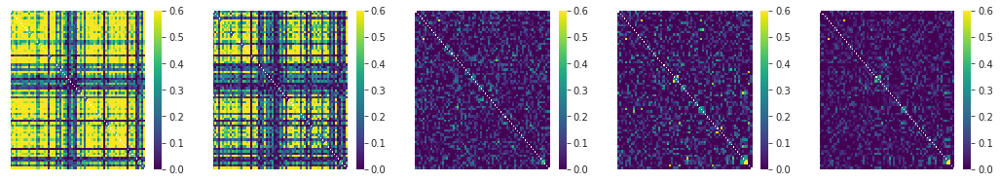

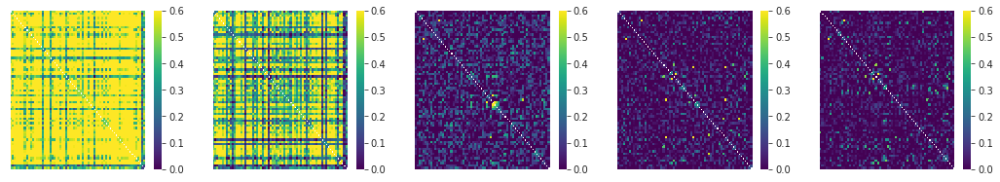

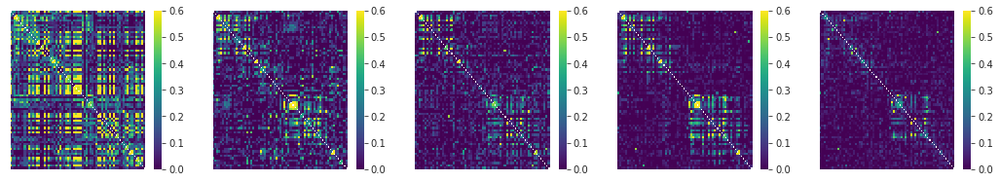

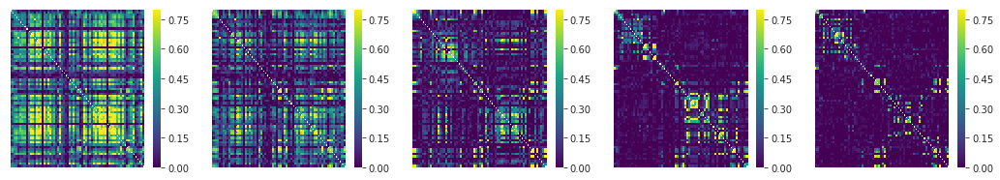

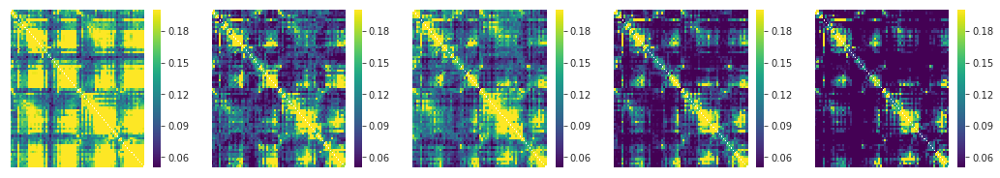

In [45]:
fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')



fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')



fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')


fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')





fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')

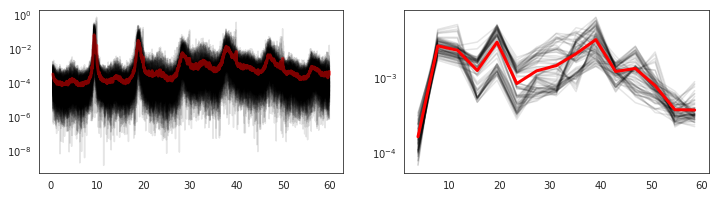

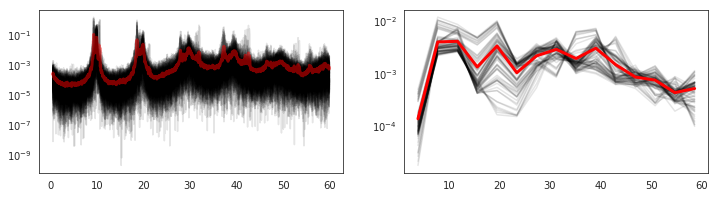

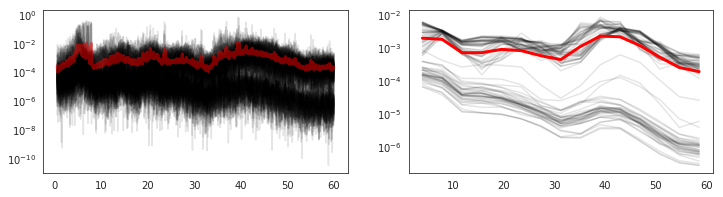

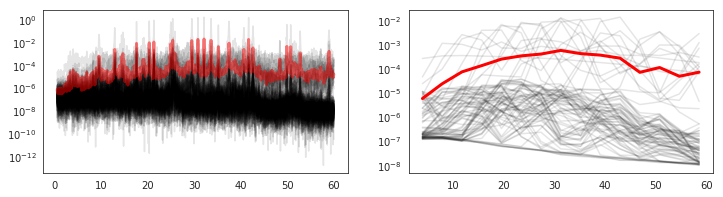

In [46]:
fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_0[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_0[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)




fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_0p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_0p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_0p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_0p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)



fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p0[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p0[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)



fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

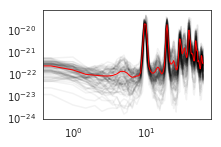

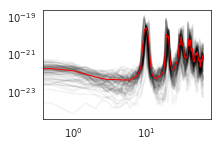

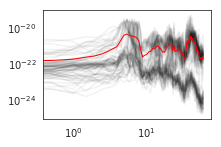

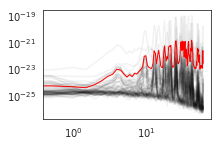

In [43]:
from mne.time_frequency import psd_welch,psd_multitaper

from mne.io import RawArray
from mne import create_info

def get_mne_psd(dat,fmin=0.,fmax=100.):
    
    #dat = df_all #     sim9a1[0]['e']
    nchan = dat.shape[1]# meg.shape[0]
    #ch_names  = ['%s_%s' %(a,b) for a,b in np.array(dat.columns)]
    ch_names = list(dat.columns.values.astype(str))
    #ch_names = list(dat.columns.values.astype(str))
    ch_types = ['mag' for _ in range(nchan)]
    raw = RawArray(dat.T.values/1e9, 
               create_info(ch_names,1e3/(dat.index[1] - dat.index[0]),ch_types),verbose=False)
    tmin = 0; tmax = raw.times[-1]
    #fmin,fmax = filt_freqs
    raw.filter(fmin,fmax)
    n_fft = min(np.diff(raw.time_as_index([tmin, tmax]))[0] + 1, 2048)
    # probably will return 2048
    psds,freqs = psd_welch(raw,n_fft=n_fft,fmin=fmin,fmax=fmax,verbose=False)
    df_wel = pd.DataFrame(psds.T,index=freqs)#blah[0].T,index=blah[1])
    #df_wel.columns = df_all.columns
    
    psds,freqs = psd_multitaper(raw,fmin=fmin,fmax=fmax,verbose=False)
    df_mt = pd.DataFrame(psds.T,index=freqs)#blah[0].T,index=blah[1])
    
    
    return df_wel,df_mt,raw

# MNE Plot
dat = res_Io_0[0]['e']
psds_Io_0 = get_mne_psd(dat)

dat = res_Io_0p5[0]['e']
psds_Io_0p5 = get_mne_psd(dat)

dat = res_Io_1p0[0]['e']
psds_Io_1p0 = get_mne_psd(dat)

dat = res_Io_1p5[0]['e']
psds_Io_1p5 = get_mne_psd(dat)

sns.set_style('white')

fname = 'res_Io_0_mnewelpsd.png'
fig, ax = plt.subplots(figsize=(3,2))
psds_Io_0[0].loc[:60].plot(legend=False,c='k', alpha=0.05,logy=True,ax=ax)
psds_Io_0[0].loc[:60].mean(axis=1).plot(legend=False,c='r',linewidth=1.,logy=True,logx=True,ax=ax)
#plt.savefig(fname,transparent=True,bbox_inches='tight')
#plt.close()

fname = 'res_Io_0p5_mnewelpsd.png'
fig, ax = plt.subplots(figsize=(3,2))
psds_Io_0p5[0].loc[:60].plot(legend=False,c='k', alpha=0.05,logy=True,ax=ax)
psds_Io_0p5[0].loc[:60].mean(axis=1).plot(legend=False,c='r',linewidth=1.,logy=True,logx=True,ax=ax)
#plt.savefig(fname,transparent=True,bbox_inches='tight')
#plt.close()

fname = 'res_Io_1p0_mnewelpsd.png'
fig, ax = plt.subplots(figsize=(3,2))
psds_Io_1p0[0].loc[:60].plot(legend=False,c='k', alpha=0.05,logy=True,ax=ax)
psds_Io_1p0[0].loc[:60].mean(axis=1).plot(legend=False,c='r',linewidth=1.,logy=True,logx=True,ax=ax)
#plt.savefig(fname,transparent=True,bbox_inches='tight')
#plt.close()

fname = 'res_Io_1p5_mnewelpsd.png'
fig, ax = plt.subplots(figsize=(3,2))
psds_Io_1p5[0].loc[:60].plot(legend=False,c='k', alpha=0.05,logy=True,ax=ax)
psds_Io_1p5[0].loc[:60].mean(axis=1).plot(legend=False,c='r',linewidth=1.,logy=True,logx=True,ax=ax)
#plt.savefig(fname,transparent=True,bbox_inches='tight')
#plt.close()

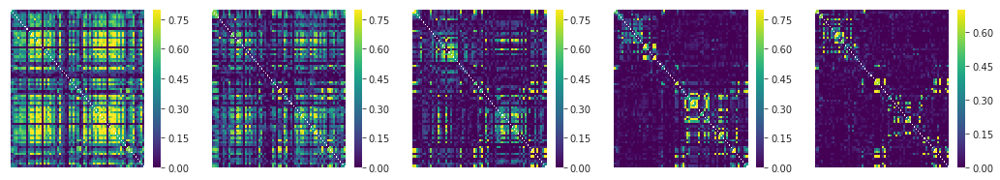

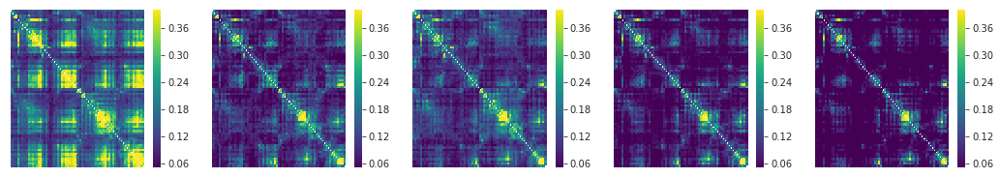

In [44]:
fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.7,ax=a,xticklabels='',yticklabels='')





fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.4,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.4,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.4,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.4,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.4,ax=a,xticklabels='',yticklabels='')


## Graveyard

## Run sims

Run for several different I_o values

Hypothesis = 'better' fc for gamma state...

In [ ]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=0., # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res1 = run_net_sim(**ssX_params)

res_aecs_1 =  aec(res1[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res1[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res1[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res1[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res1[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_aecs_1)

complex64
Converting time column to int64...
CPU times: user 7min 24s, sys: 5min 50s, total: 13min 14s
Wall time: 4min 24s


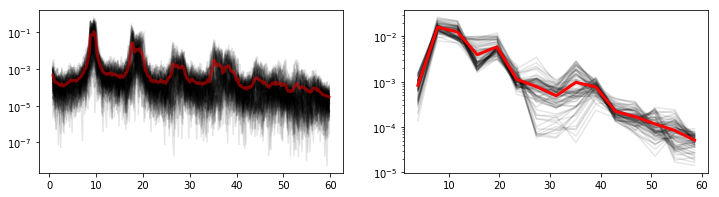

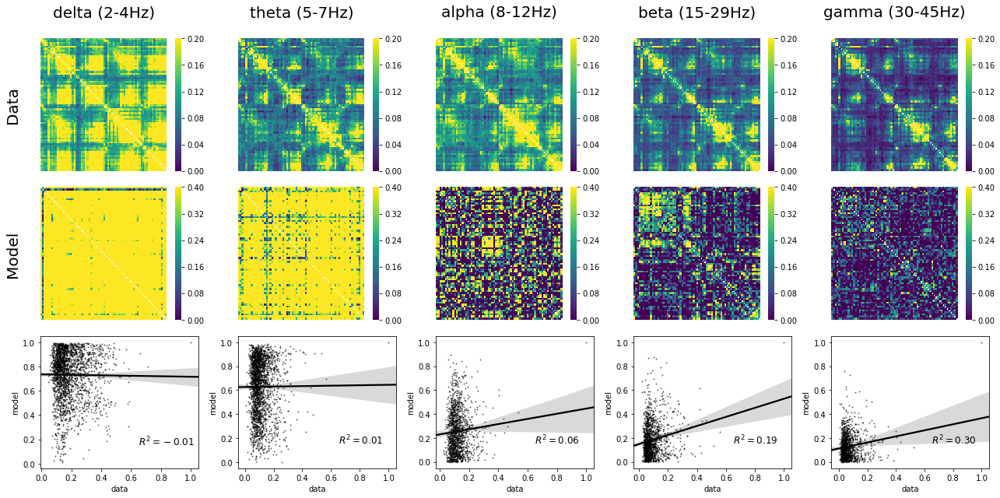

In [14]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=0.5, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res2 = run_net_sim(**ssX_params)

res_aecs_2 =  aec(res2[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res2[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res2[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res2[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res2[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_aecs_2)

complex64
Converting time column to int64...
CPU times: user 6min 40s, sys: 4min 47s, total: 11min 28s
Wall time: 4min 9s


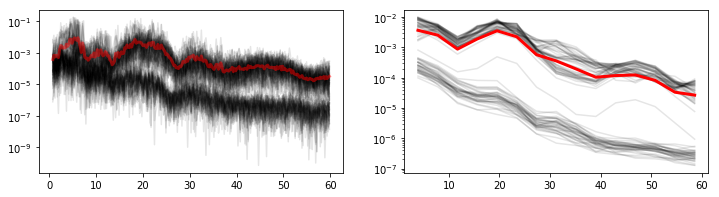

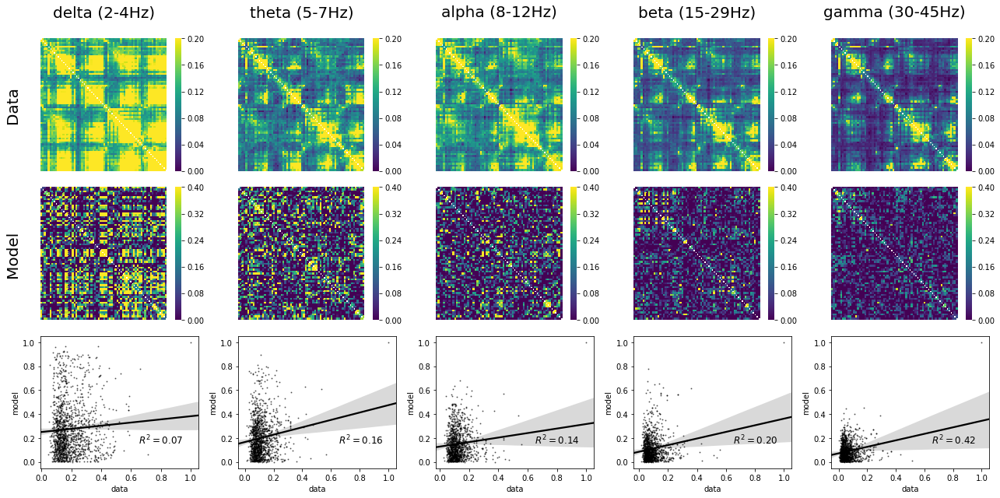

In [15]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=1.0, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res3 = run_net_sim(**ssX_params)

res_aecs_3 =  aec(res3[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res3[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res3[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res3[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res3[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_aecs_3)

complex64
Converting time column to int64...
CPU times: user 9min 8s, sys: 6min 58s, total: 16min 6s
Wall time: 4min 47s


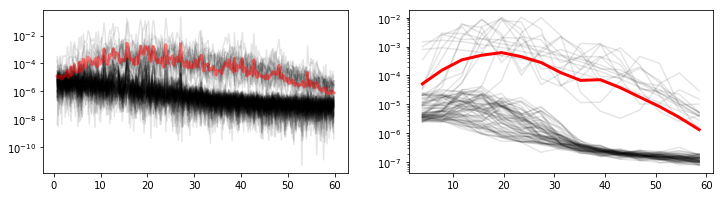

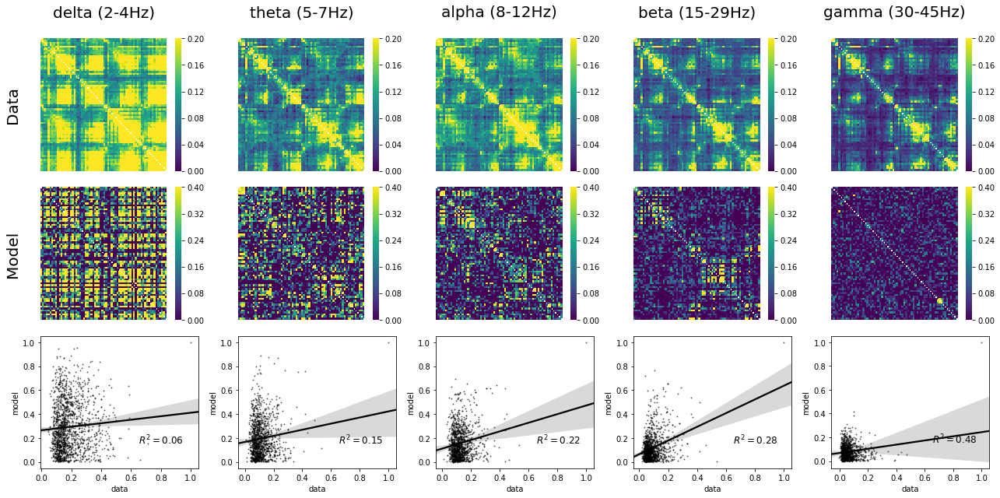

In [16]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=4.0, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res4 = run_net_sim(**ssX_params)

res_aecs_4 =  aec(res4[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res4[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res4[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res4[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res4[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_aecs_4)

complex64
Converting time column to int64...
CPU times: user 8min 51s, sys: 5min 5s, total: 13min 56s
Wall time: 4min 18s


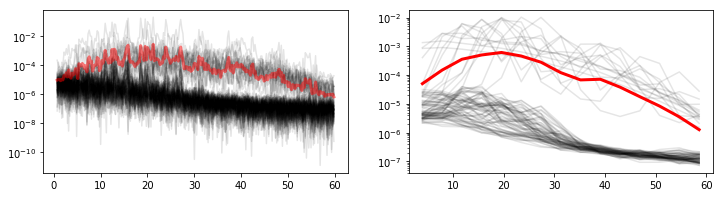

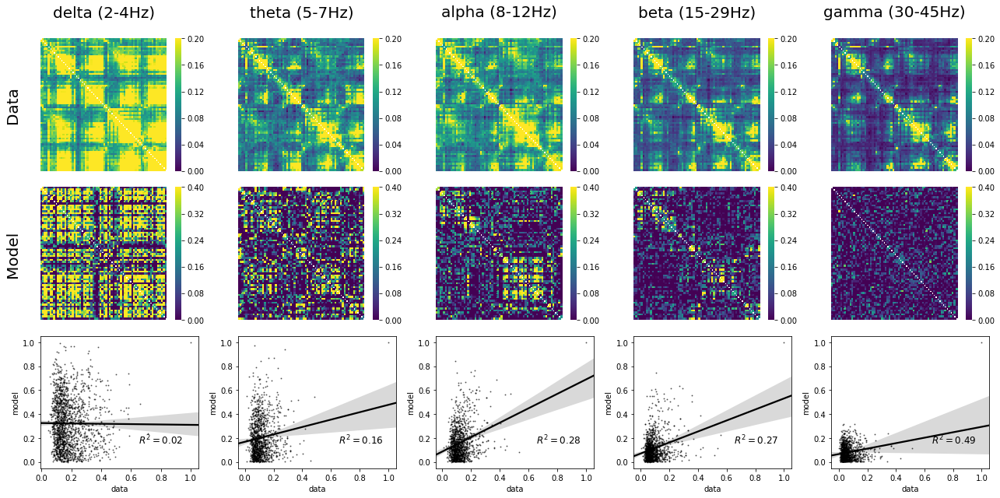

In [17]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=4.0, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res5 = run_net_sim(**ssX_params)

res_aecs_5 =  aec(res5[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_aecs_5)

complex64
Converting time column to int64...
CPU times: user 8min 39s, sys: 5min 9s, total: 13min 48s
Wall time: 4min 19s


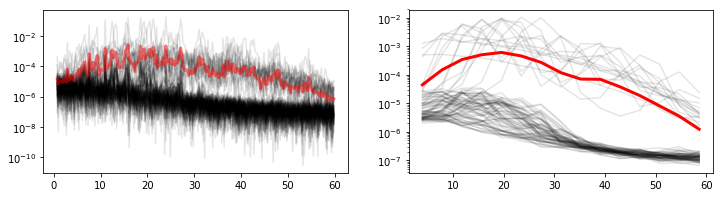

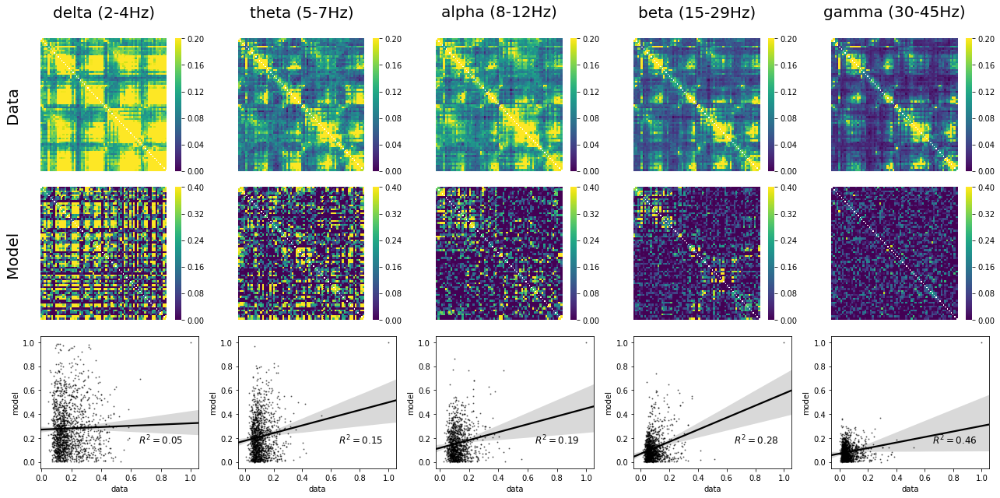

In [19]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=10.0, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res6 = run_net_sim(**ssX_params)

res_aecs_6 =  aec(res6[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res6[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res6[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res6[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res6[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_aecs_6)

favourite pset - good fc with alpha peak...

...reducing noise level

complex64
Converting time column to int64...
CPU times: user 9min 8s, sys: 4min 42s, total: 13min 50s
Wall time: 4min 20s


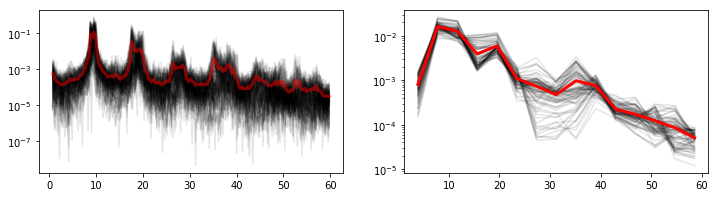

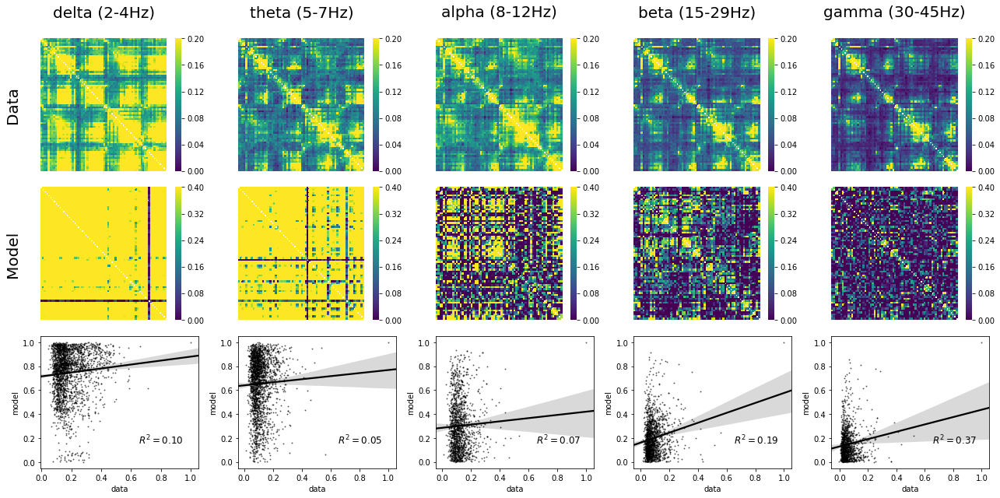

In [20]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=0.5, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .000001,D_i= .000001,D_th = 0.000001,D_rtn = 0.000001,
            T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res2 = run_net_sim(**ssX_params)

res_aecs_2 =  aec(res2[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res2[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res2[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res2[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res2[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_aecs_2)

complex64
Converting time column to int64...
CPU times: user 8min 30s, sys: 6min 27s, total: 14min 58s
Wall time: 4min 48s


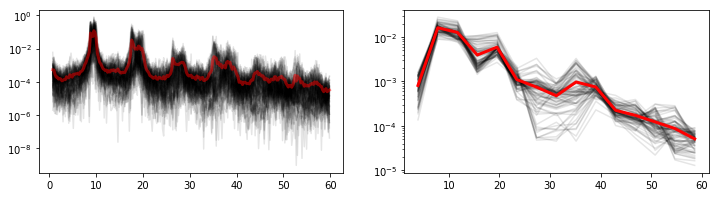

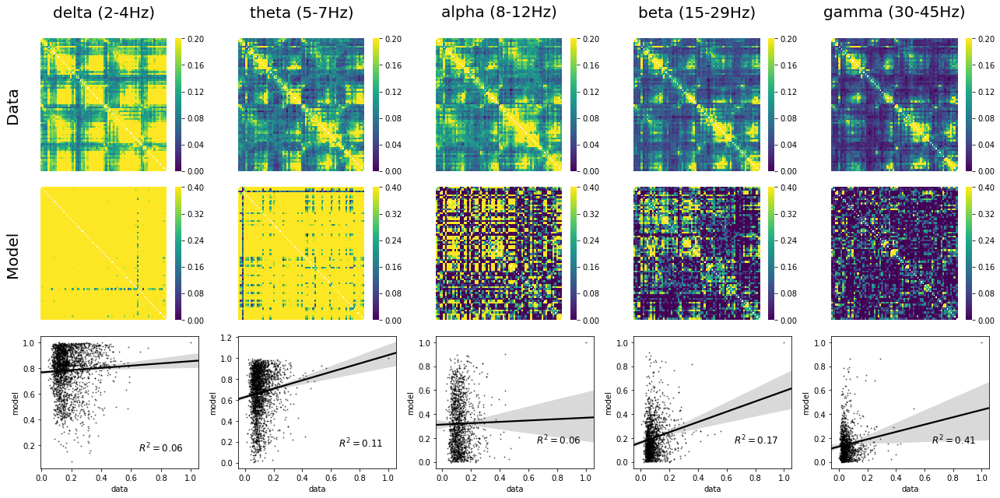

In [22]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=0.5, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00000001,D_i= .00000001,D_th = 0.00000001,D_rtn = 0.00000001,
            T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res2 = run_net_sim(**ssX_params)

res_aecs_2 =  aec(res2[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res2[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res2[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res2[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res2[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_aecs_2)

slightly play around with g

complex64
Converting time column to int64...
CPU times: user 8min 43s, sys: 4min 46s, total: 13min 30s
Wall time: 4min 41s


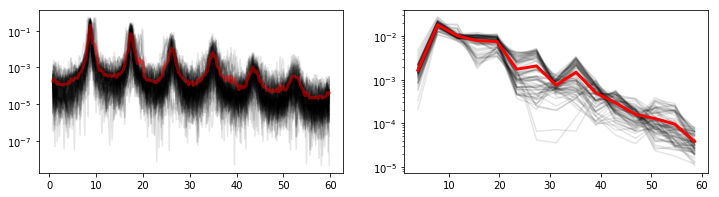

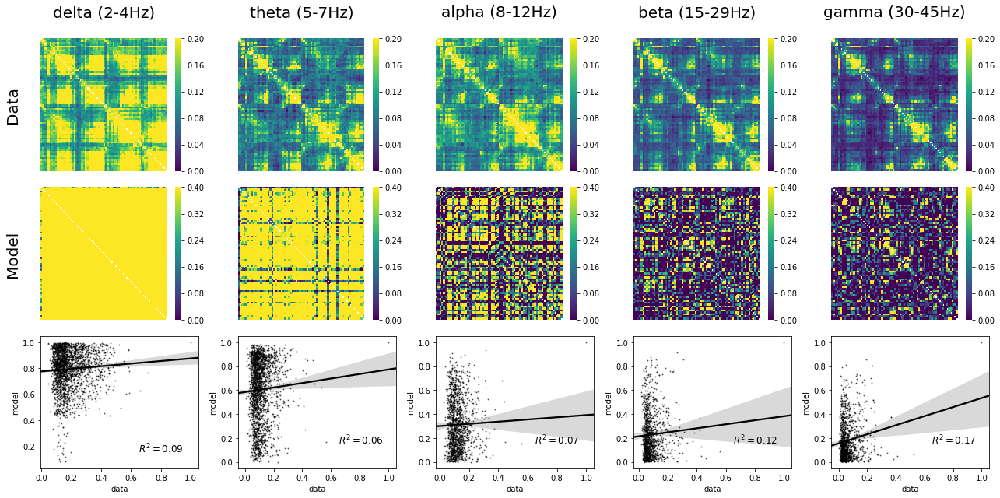

In [119]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=0.5, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 7.5, # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res2 = run_net_sim(**ssX_params)

res_aecs_2 =  aec(res2[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res2[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res2[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res2[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res2[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_aecs_2)

complex64
Converting time column to int64...
CPU times: user 8min 54s, sys: 5min 15s, total: 14min 10s
Wall time: 4min 35s


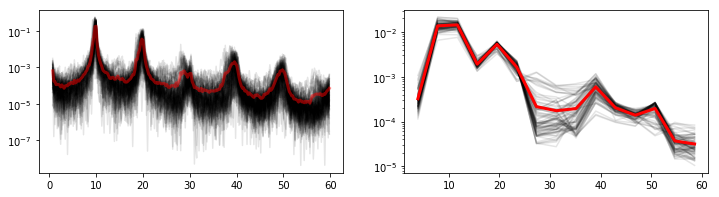

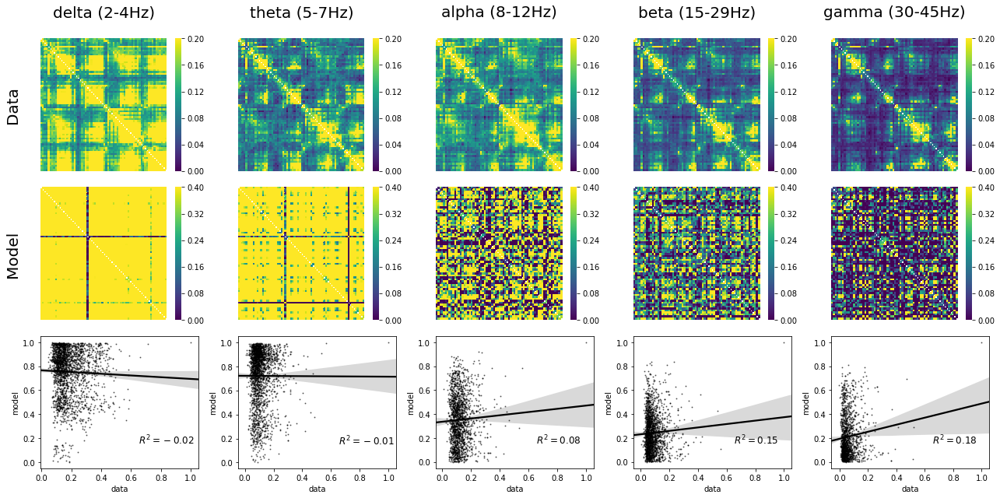

In [117]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=0.5, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 3., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res2 = run_net_sim(**ssX_params)

res_aecs_2 =  aec(res2[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res2[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res2[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res2[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res2[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_aecs_2)

complex64
Converting time column to int64...
CPU times: user 8min 32s, sys: 5min 10s, total: 13min 43s
Wall time: 4min 43s


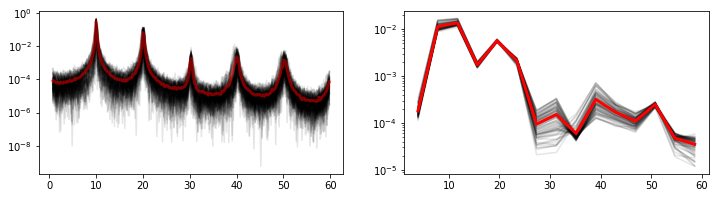

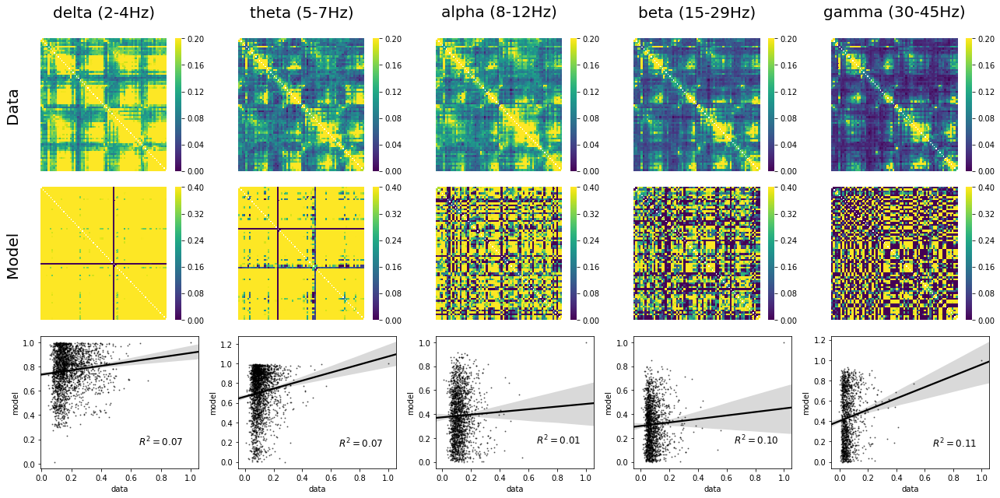

In [118]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=0.5, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 1.5, # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res2 = run_net_sim(**ssX_params)

res_aecs_2 =  aec(res2[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res2[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res2[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res2[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res2[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_aecs_2)

favourite pset - longer runs

complex64
Converting time column to int64...
CPU times: user 28min, sys: 14min 44s, total: 42min 45s
Wall time: 14min 10s


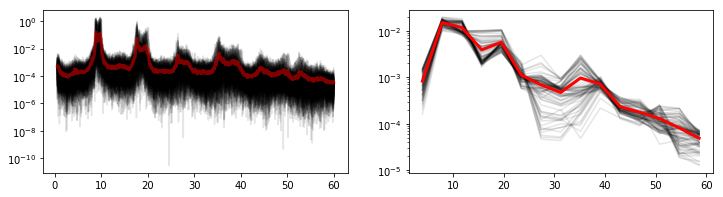

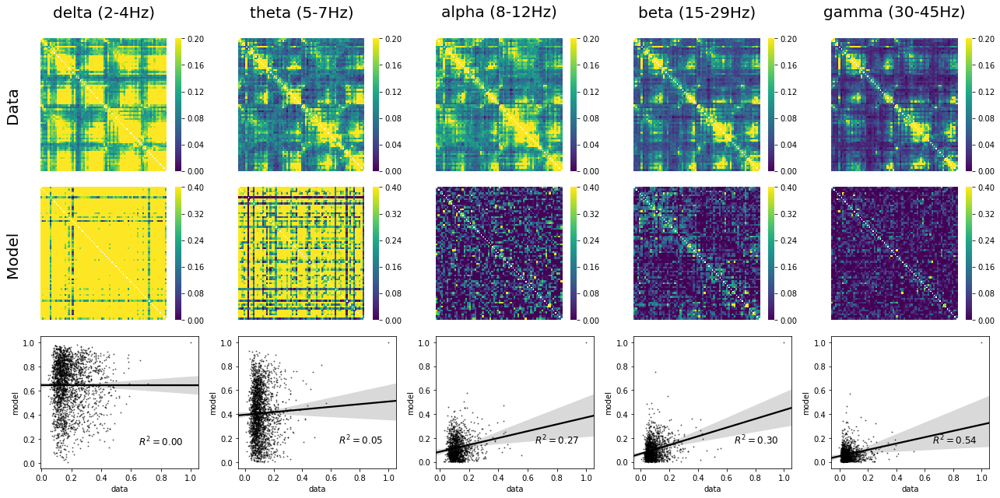

In [23]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=0.5, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*16,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res2 = run_net_sim(**ssX_params)

res_aecs_2 =  aec(res2[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res2[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res2[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res2[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res2[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_aecs_2)

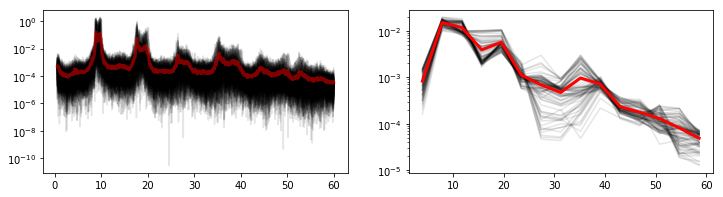

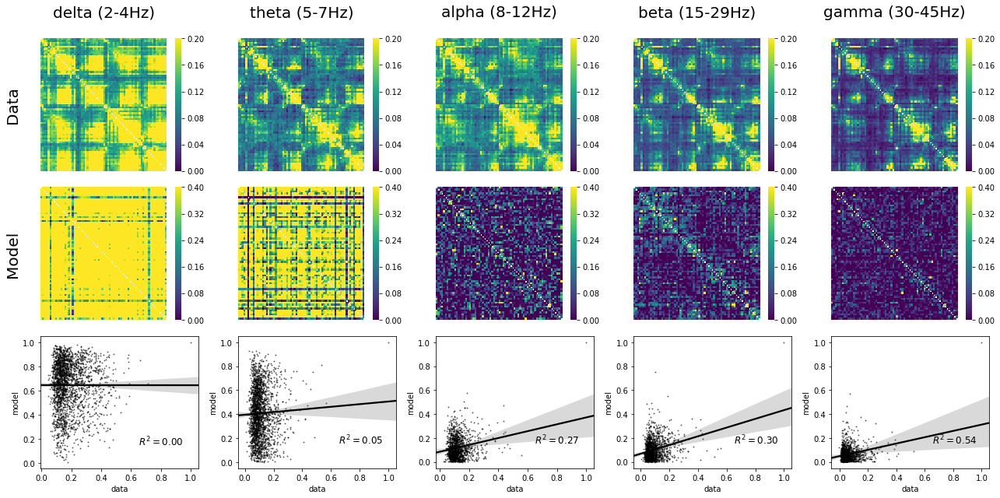

In [27]:
fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res2[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res2[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)#,vmax=0.2)

res2[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res2[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)#,vmax=0.2)

make_mat_plots(res_aecs_2)

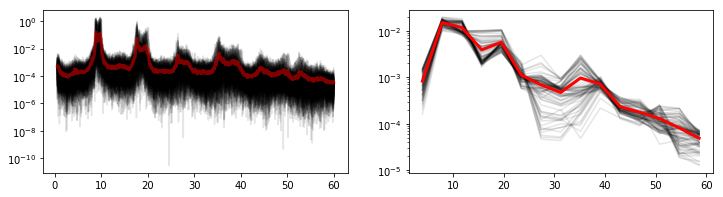

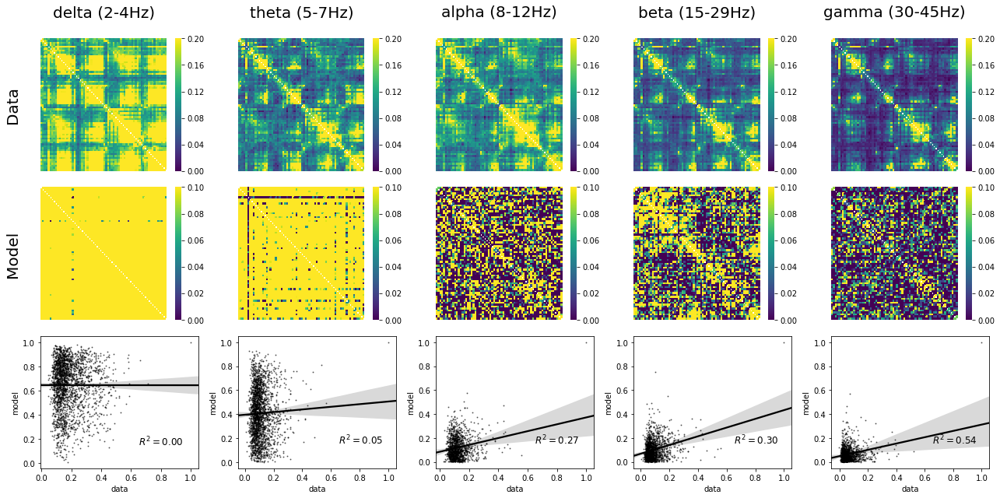

In [30]:
fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res2[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res2[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)#,vmax=0.2)

res2[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res2[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)#,vmax=0.2)

make_mat_plots(res_aecs_2,vmax=0.1)

complex64
Converting time column to int64...
CPU times: user 1h 5min 30s, sys: 26min 19s, total: 1h 31min 49s
Wall time: 28min 31s


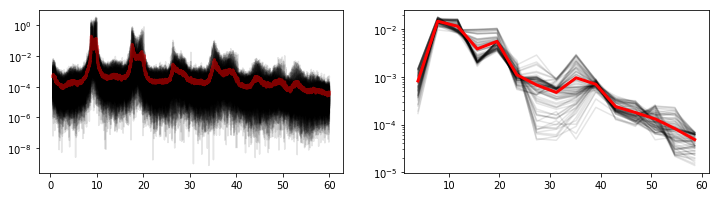

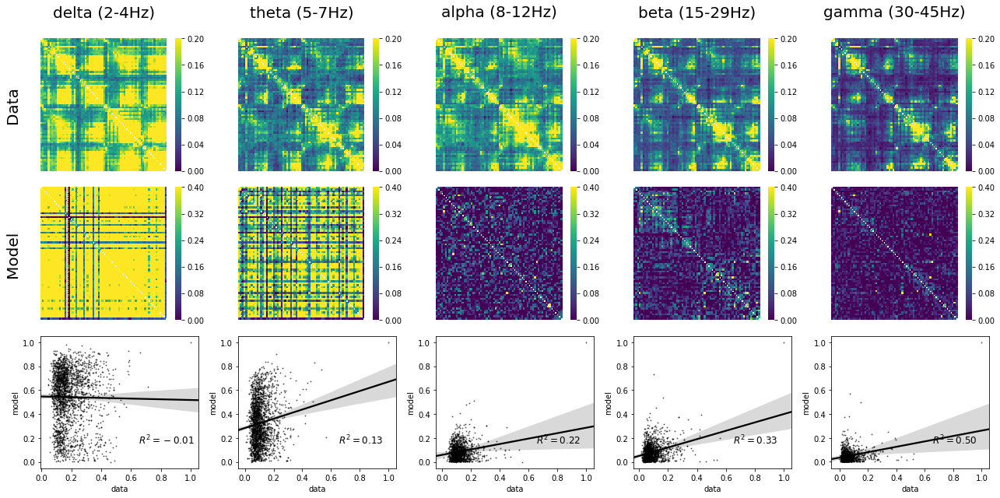

In [31]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=0.5, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*32,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res2 = run_net_sim(**ssX_params)

res_aecs_2 =  aec(res2[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res2[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res2[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res2[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res2[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_aecs_2)

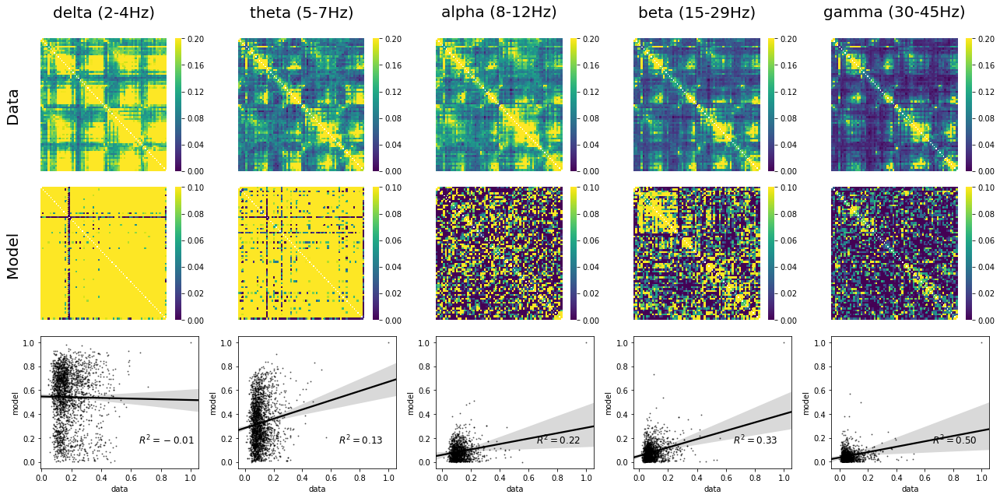

In [33]:
make_mat_plots(res_aecs_2,vmax=0.1)

try next: several shorter runs with averaging...

In [34]:
%%time

many_aecs = []
for r in range(10):
    
    # this should give clean isolated gamma rhythms
    ssX_params = dict(I_o=0.5, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)

    res = run_net_sim(**ssX_params)
    many_aecs.append(aec(res[0]['e'].values.T.copy(),sfreq,freq_bands))

complex64
Converting time column to int64...
CPU times: user 1h 29min 35s, sys: 38min 16s, total: 2h 7min 51s
Wall time: 44min 14s


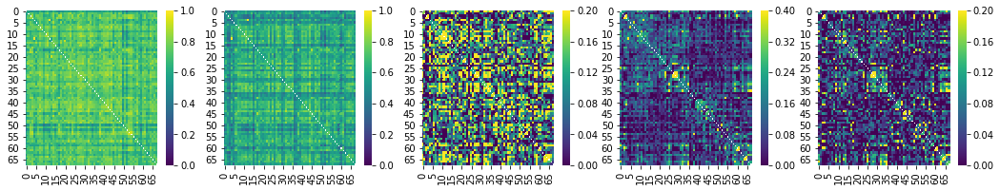

In [115]:
deltamat = many_aecs[0][0]['delta']['aec'].values
for a in many_aecs[1:]:
    delta = a[0]['delta']['aec'].values
    deltamat+=delta
deltamat/=len(many_aecs)

thetamat = many_aecs[0][0]['theta']['aec'].values
for a in many_aecs[1:]:
    theta = a[0]['theta']['aec'].values
    thetamat+=theta
thetamat/=len(many_aecs)

alphamat = many_aecs[0][0]['alpha']['aec'].values
for a in many_aecs[1:]:
    alpha = a[0]['alpha']['aec'].values
    alphamat+=alpha
alphamat/=len(many_aecs)

betamat = many_aecs[0][0]['beta']['aec'].values
for a in many_aecs[1:]:
    beta = a[0]['beta']['aec'].values
    betamat+=beta    
betamat/=len(many_aecs)

gammamat = many_aecs[0][0]['gamma']['aec'].values
for a in many_aecs[1:]:
    gamma = a[0]['gamma']['aec'].values
    gammamat+=gamma
gammamat/=len(many_aecs)

fig, ax = plt.subplots(ncols=5, figsize=(18,3))

a = ax[0]
sns.heatmap(deltamat[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx],mask=np.eye(68),
            cmap='viridis',vmin=0.,vmax=1.,ax=a)

a = ax[1]
sns.heatmap(thetamat[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx],mask=np.eye(68),
            cmap='viridis',vmin=0.,vmax=1.,ax=a)

a = ax[2]
sns.heatmap(alphamat[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx],mask=np.eye(68),#vmin=0,vmax=0.8,
            cmap='viridis',vmin=0.,vmax=0.2,ax=a)

a = ax[3]
sns.heatmap(betamat[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx],mask=np.eye(68),#vmin=0,vmax=0.8,
            cmap='viridis',vmin=0.,vmax=0.4,ax=a)

a = ax[4]
sns.heatmap(gammamat[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx],mask=np.eye(68),#vmin=0,vmax=0.8,
            cmap='viridis',vmin=0.,vmax=0.2,ax=a)


---

Another thing to do - what do the sims look like that produce these plots - they are good (?)

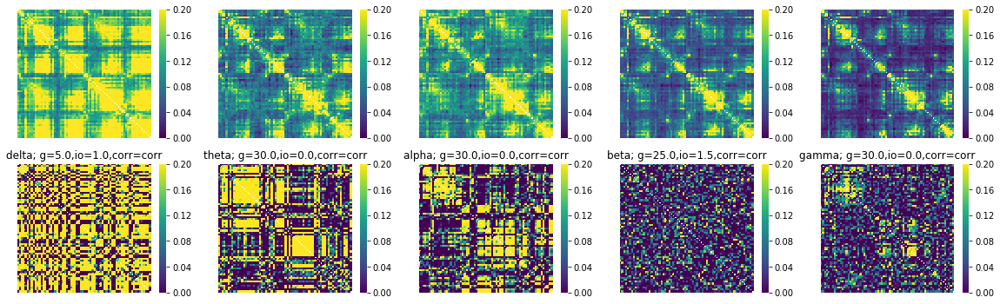

In [212]:
fig, ax = plt.subplots(ncols=5, nrows=2,figsize=(20,6))

for freq_it,freq in enumerate(['delta', 'theta', 'alpha', 'beta', 'gamma']):
    _,g,io = df_sim_emp_corrs.unstack(['g', 'io']).idxmax(axis=1).loc[freq]
    anaec = psweep[g,io][1][0][freq]['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
    a = ax[1][freq_it]
    sns.heatmap(anaec,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,
                xticklabels='',yticklabels='')
    a.set_title('%s; g=%s,io=%s,corr=%s' %(freq,g,io,'corr'))
    
    a = ax[0][freq_it]
    anaec = aec_mean[freq][orig_to_abey_idx,:][:,orig_to_abey_idx]
    sns.heatmap(anaec,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,
                xticklabels='',yticklabels='')
    

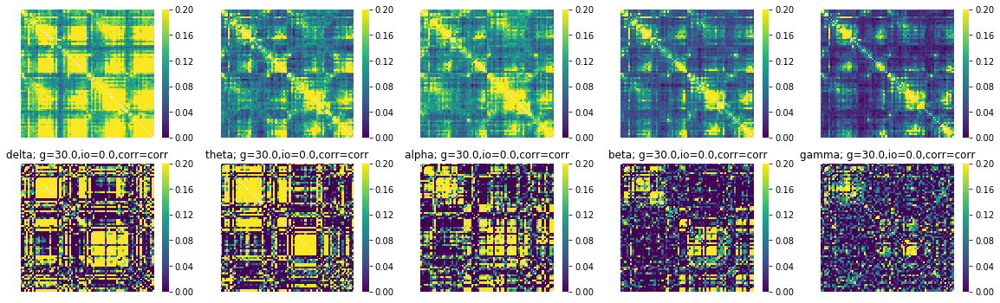

In [218]:
fig, ax = plt.subplots(ncols=5, nrows=2,figsize=(20,6))

for freq_it,freq in enumerate(['delta', 'theta', 'alpha', 'beta', 'gamma']):
    #_,g,io = df_sim_emp_corrs.unstack(['g', 'io']).idxmax(axis=1).loc[freq]
    g = 30.
    io = 0.
    anaec = psweep[g,io][1][0][freq]['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
    a = ax[1][freq_it]
    sns.heatmap(anaec,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,
                xticklabels='',yticklabels='')
    a.set_title('%s; g=%s,io=%s,corr=%s' %(freq,g,io,'corr'))
    
    a = ax[0][freq_it]
    anaec = aec_mean[freq][orig_to_abey_idx,:][:,orig_to_abey_idx]
    sns.heatmap(anaec,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,
                xticklabels='',yticklabels='')
    

---

#### Final figures

complex64
Converting time column to int64...
CPU times: user 2h 19min 14s, sys: 1h 18min 6s, total: 3h 37min 21s
Wall time: 1h 7min 16s


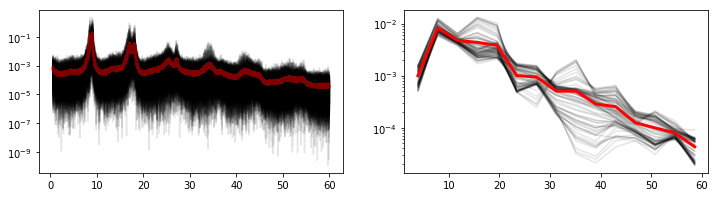

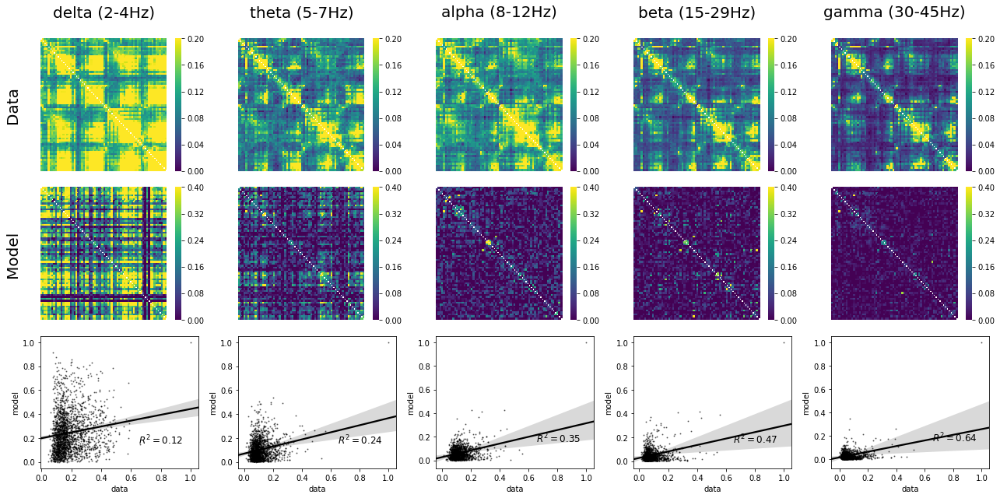

In [172]:
%%time

# bad good FC from low I_o and alpha rhythms

ssX_params = dict(I_o=0.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*60,# 15, # 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res_Io_0 = run_net_sim(**ssX_params)

res_Io_0_aecs =  aec(res_Io_0[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_0[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_0[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_Io_0_aecs)

complex64
Converting time column to int64...
CPU times: user 2h 22min 32s, sys: 52min 36s, total: 3h 15min 8s
Wall time: 59min 26s


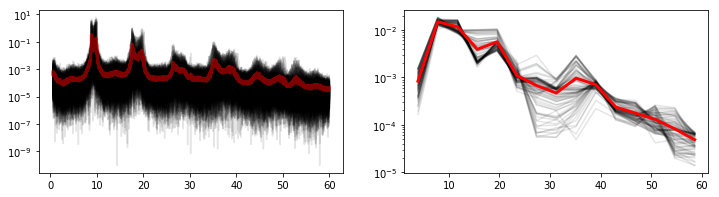

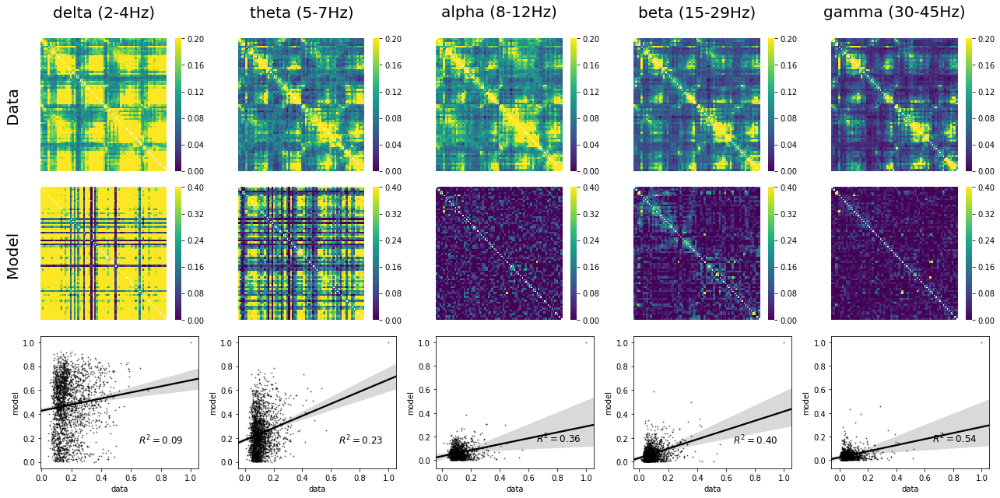

In [173]:
%%time

# good0ish FC from medium I_o and alpha rhythms

ssX_params = dict(I_o=0.5,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T=1024*60, # T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res_Io_0p5 = run_net_sim(**ssX_params)

res_Io_0p5_aecs =  aec(res_Io_0p5[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_0p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_0p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_0p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_0p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_Io_0p5_aecs)

complex64
Converting time column to int64...
CPU times: user 2h 21min 56s, sys: 1h 3min 14s, total: 3h 25min 11s
Wall time: 1h 47s


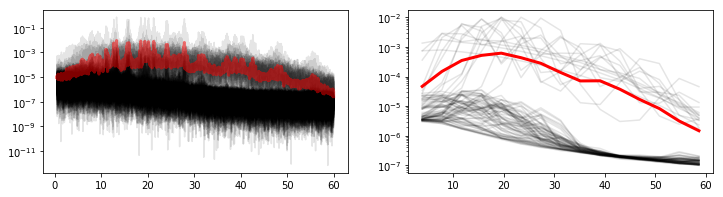

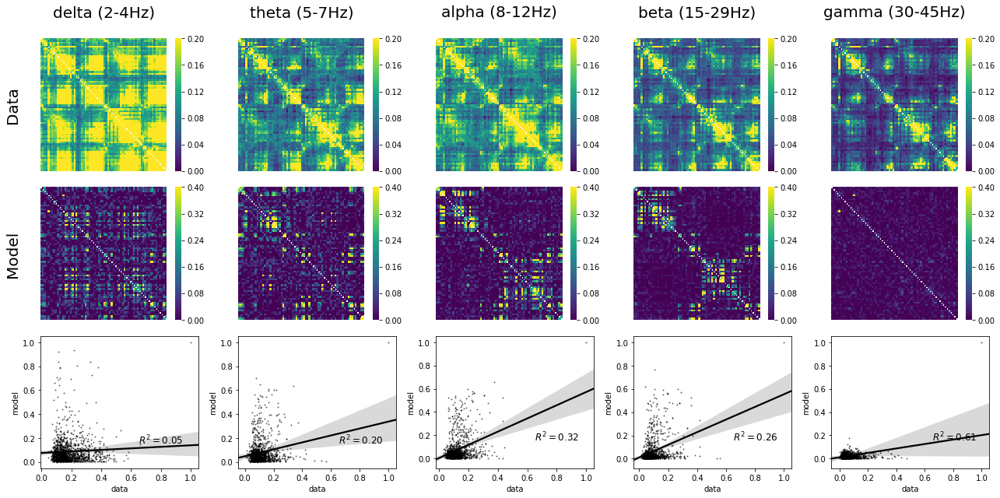

In [174]:
%%time

# good FC from high I_o and gamma rhythms

ssX_params = dict(I_o=1.5,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T=1024*60,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res_Io_1p5 = run_net_sim(**ssX_params)

res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_Io_1p5_aecs)

In [175]:
deltamat_Io_0 = res_Io_0_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_0 = res_Io_0_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_0 = res_Io_0_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_0 = res_Io_0_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_0 = res_Io_0_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_0p5 = res_Io_0p5_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_0p5 = res_Io_0p5_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_0p5 = res_Io_0p5_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_0p5 = res_Io_0p5_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_0p5 = res_Io_0p5_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_1p5 = res_Io_1p5_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_1p5 = res_Io_1p5_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_1p5 = res_Io_1p5_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_1p5 = res_Io_1p5_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_1p5 = res_Io_1p5_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]




---

This is one option for one of the final figures. A 'complete one'.

Although we might prefer to e.g. only show gamma matrix or something. Only the best ones. 

Also need to add an empirical MEEG power spectrum in top right. 


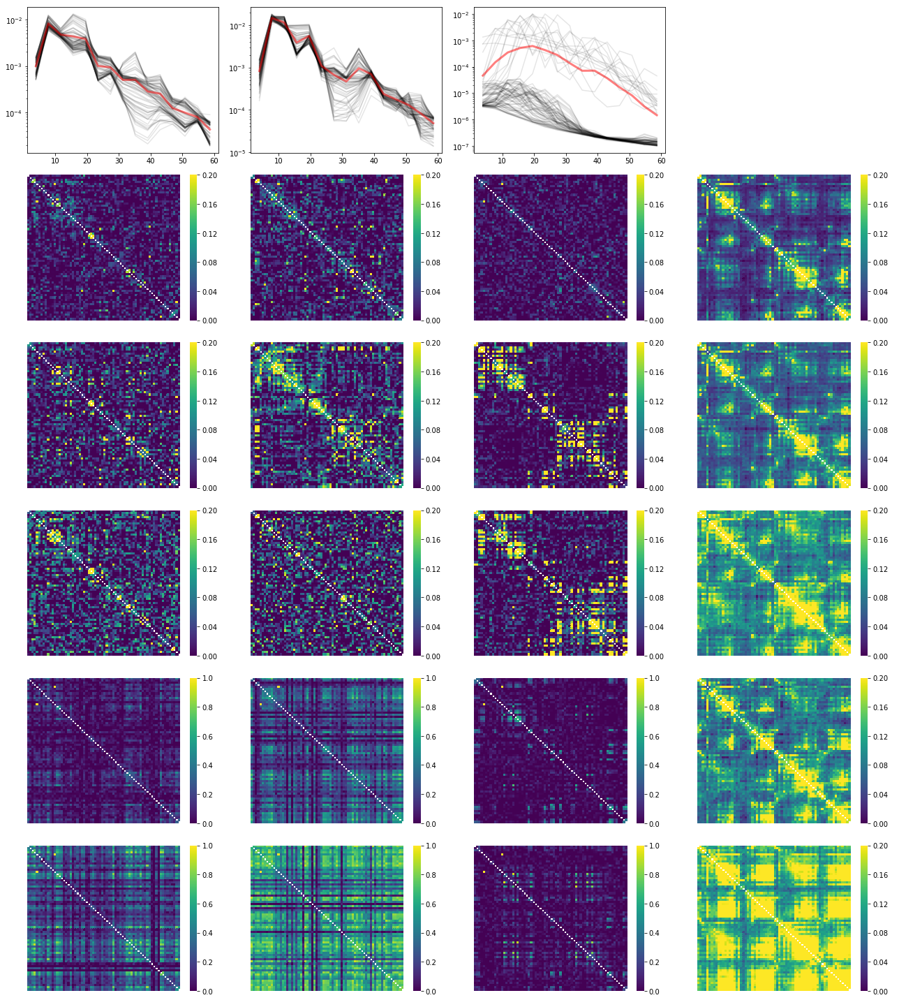

In [176]:
fig, ax = plt.subplots(ncols=4,nrows=6, figsize=(18,20))

a = ax[0][0]
res_Io_0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=a,alpha=0.1)
res_Io_0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=a,alpha=0.5,linewidth=3.)

a = ax[0][1]
res_Io_0p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=a,alpha=0.1)
res_Io_0p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=a,alpha=0.5,linewidth=3.)

a = ax[0][2]
res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=a,alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=a,alpha=0.5,linewidth=3.)

a = ax[0][3]
a.axis('off')



a = ax[1][0]
sns.heatmap(gammamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[1][1]
sns.heatmap(gammamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[1][2]
sns.heatmap(gammamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[1][3]
sns.heatmap(aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx],
            cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')





a = ax[2][0]
sns.heatmap(betamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[2][1]
sns.heatmap(betamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[2][2]
sns.heatmap(betamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[2][3]
sns.heatmap(aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx],
            cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')






a = ax[3][0]
sns.heatmap(alphamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[3][1]
sns.heatmap(alphamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[3][2]
sns.heatmap(alphamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[3][3]
sns.heatmap(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx],
            cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')


a = ax[4][0]
sns.heatmap(thetamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[4][1]
sns.heatmap(thetamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[4][2]
sns.heatmap(thetamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[4][3]
sns.heatmap(aec_mean['theta'][orig_to_abey_idx,:][:,orig_to_abey_idx],
            cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')



a = ax[5][0]
sns.heatmap(deltamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[5][1]
sns.heatmap(deltamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[5][2]
sns.heatmap(deltamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[5][3]
sns.heatmap(aec_mean['delta'][orig_to_abey_idx,:][:,orig_to_abey_idx],
            cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')






plt.tight_layout()

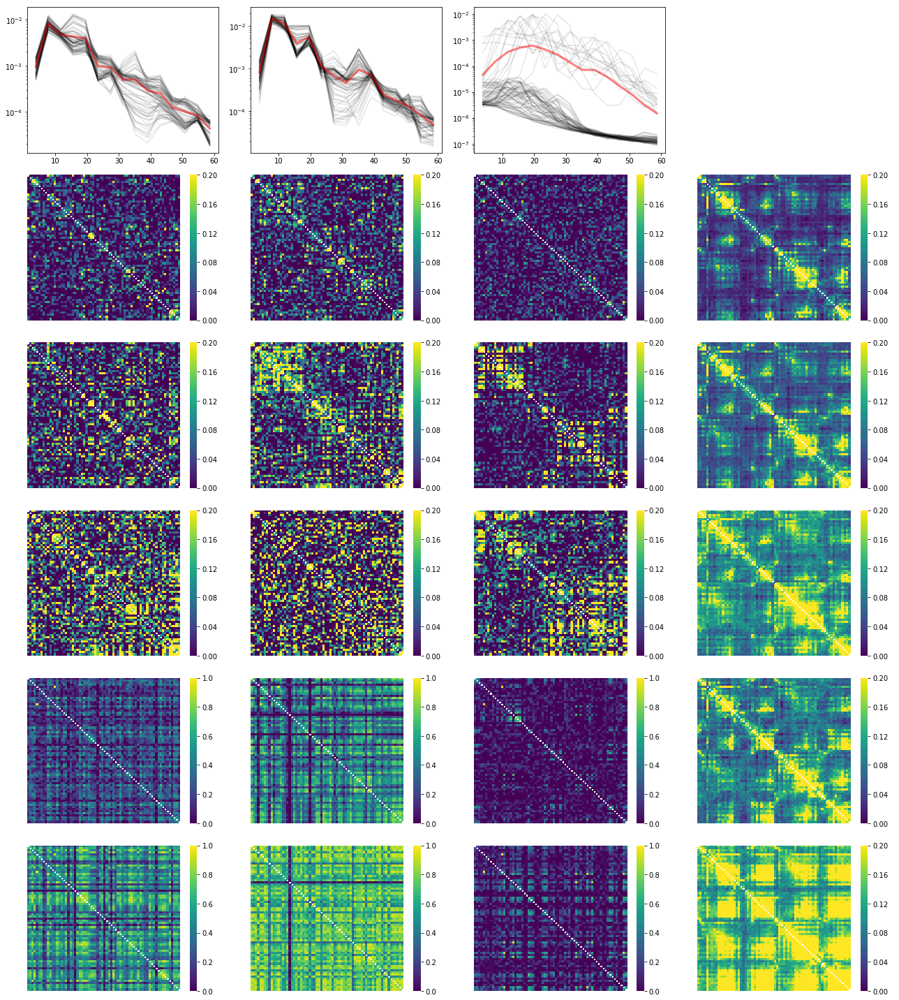

In [165]:
fig, ax = plt.subplots(ncols=4,nrows=6, figsize=(18,20))

a = ax[0][0]
res_Io_0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=a,alpha=0.1)
res_Io_0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=a,alpha=0.5,linewidth=3.)

a = ax[0][1]
res_Io_0p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=a,alpha=0.1)
res_Io_0p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=a,alpha=0.5,linewidth=3.)

a = ax[0][2]
res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=a,alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=a,alpha=0.5,linewidth=3.)

a = ax[0][3]
a.axis('off')



a = ax[1][0]
sns.heatmap(gammamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[1][1]
sns.heatmap(gammamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[1][2]
sns.heatmap(gammamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[1][3]
sns.heatmap(aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx],
            cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')





a = ax[2][0]
sns.heatmap(betamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[2][1]
sns.heatmap(betamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[2][2]
sns.heatmap(betamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[2][3]
sns.heatmap(aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx],
            cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')






a = ax[3][0]
sns.heatmap(alphamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[3][1]
sns.heatmap(alphamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[3][2]
sns.heatmap(alphamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[3][3]
sns.heatmap(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx],
            cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')


a = ax[4][0]
sns.heatmap(thetamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[4][1]
sns.heatmap(thetamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[4][2]
sns.heatmap(thetamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[4][3]
sns.heatmap(aec_mean['theta'][orig_to_abey_idx,:][:,orig_to_abey_idx],
            cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')



a = ax[5][0]
sns.heatmap(deltamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[5][1]
sns.heatmap(deltamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[5][2]
sns.heatmap(deltamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[5][3]
sns.heatmap(aec_mean['delta'][orig_to_abey_idx,:][:,orig_to_abey_idx],
            cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')






plt.tight_layout()

smaller final figures...

In [312]:
dat2

array([[0.        , 0.2894302 , 0.18401088, ..., 0.06257015, 0.07507864,
        0.07581432],
       [0.2894302 , 0.        , 0.20256115, ..., 0.05405589, 0.06787269,
        0.05439755],
       [0.18401088, 0.20256115, 0.        , ..., 0.08763105, 0.0884389 ,
        0.06111429],
       ...,
       [0.06257015, 0.05405589, 0.08763105, ..., 0.        , 0.43780447,
        0.25238668],
       [0.07507864, 0.06787269, 0.0884389 , ..., 0.43780447, 0.        ,
        0.19658169],
       [0.07581432, 0.05439755, 0.06111429, ..., 0.25238668, 0.19658169,
        0.        ]])

(0, 0.4)

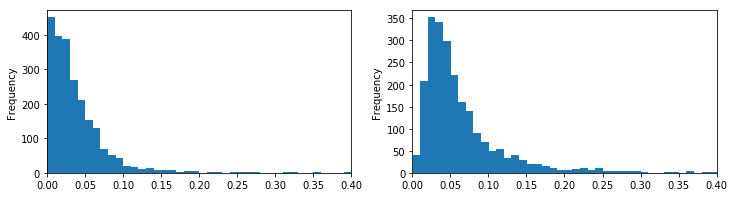

In [323]:
fig, ax = plt.subplots(ncols=2, figsize=(12,3))

dat1 = np.abs(gammamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas

dat1_nzidx = np.triu(np.abs(dat1),1).ravel()>0.
dat2_nzidx = np.triu(np.abs(dat2),1).ravel()>0.

pd.DataFrame(dat1.ravel()[dat1_nzidx])[0].plot(kind='hist', ax=ax[0],bins=100)#,xmin=0.,xmax=0.5)
ax[0].set_xlim([0,0.4])

pd.DataFrame(dat2.ravel()[dat2_nzidx])[0].plot(kind='hist', ax=ax[1],bins=100)#,xmin=0.,xmax=0.5)
ax[1].set_xlim([0,0.4])


In [331]:
def plot_these_hists(dat1,dat2,xmax=0.4):
    
  
    fig, ax = plt.subplots(ncols=2, figsize=(12,3))

    dat1_nzidx = np.triu(np.abs(dat1),1).ravel()>0.
    dat2_nzidx = np.triu(np.abs(dat2),1).ravel()>0.

    pd.DataFrame(dat1.ravel()[dat1_nzidx])[0].plot(kind='hist', ax=ax[0],bins=100)#,xmin=0.,xmax=0.5)
    ax[0].set_xlim([0,xmax])

    pd.DataFrame(dat2.ravel()[dat2_nzidx])[0].plot(kind='hist', ax=ax[1],bins=100)#,xmin=0.,xmax=0.5)
    ax[1].set_xlim([0,xmax])


array([[ 0.08148567,  0.1265937 ,  0.13753912, ...,  0.13936296,
        -0.80777234, -0.55646216],
       [ 0.02085899,  0.11465179,  0.11213754, ...,  0.17484964,
        -0.82439953, -0.5518772 ],
       [-0.0570103 ,  0.09603634,  0.08640685, ...,  0.18038353,
        -0.83017387, -0.5380306 ],
       ...,
       [-0.27932015, -0.446427  , -0.52063086, ...,  0.11594867,
        -0.37288727,  0.20018375],
       [-0.27870881, -0.4367735 , -0.51100587, ...,  0.10199727,
        -0.36728052,  0.1737602 ],
       [-0.27773657, -0.43253321, -0.49956961, ...,  0.08255583,
        -0.36666336,  0.15061977]])

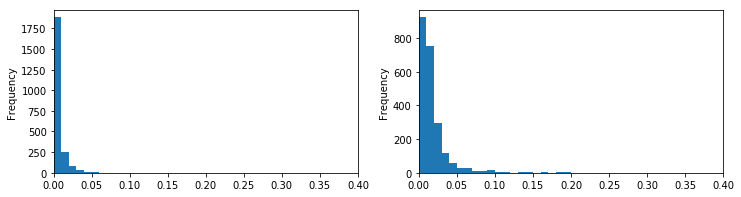

In [341]:
dat1 = np.abs(alphamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas
plot_these_hists(dat1**2,dat2**2,xmax=0.4)

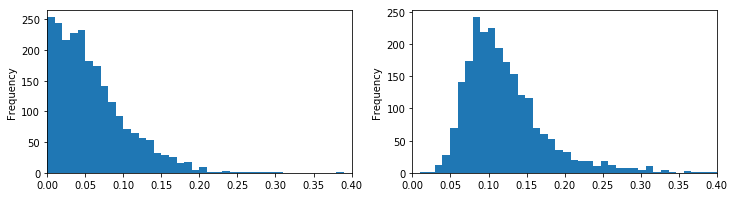

In [342]:
dat1 = np.abs(alphamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas
plot_these_hists(dat1,dat2,xmax=0.4)

In [ ]:
dat1 = np.log1p(np.abs(alphamat_Io_0p5)*mas)
dat2 = np.log1p(np.abs(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas)
plot_these_hists(dat1,dat2,xmax=0.4)

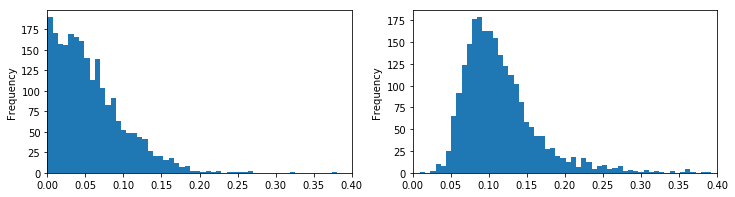

In [338]:
dat1 = np.log1p(np.abs(alphamat_Io_0p5)*mas)
dat2 = np.log1p(np.abs(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas)
plot_these_hists(dat1,dat2,xmax=0.4)

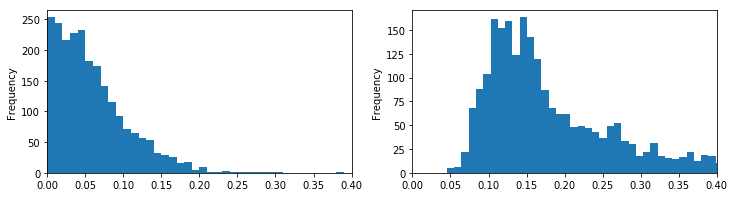

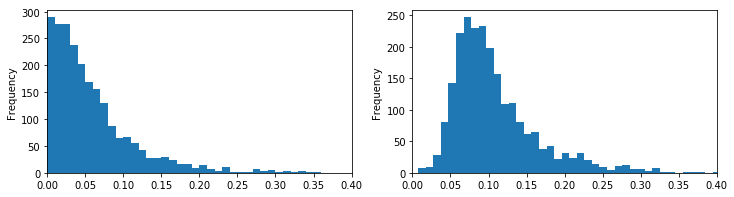

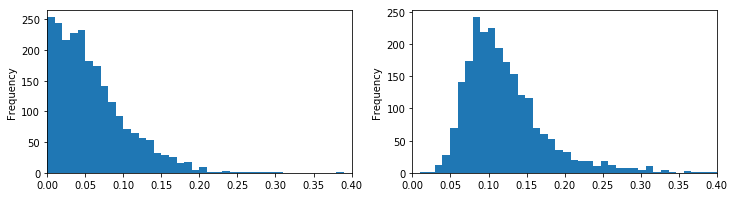

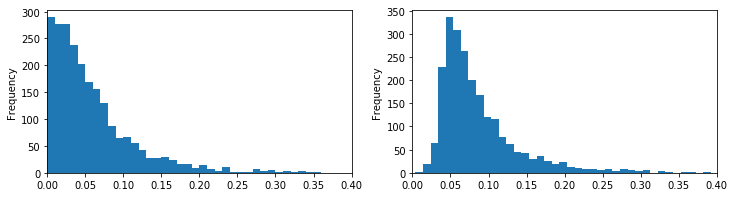

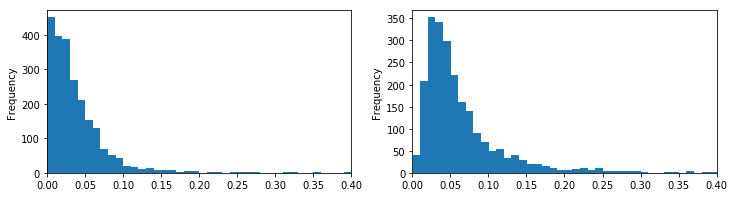

In [335]:

dat1 = np.abs(alphamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['delta'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas
plot_these_hists(dat1,dat2,xmax=0.4)

dat1 = np.abs(betamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['theta'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas
plot_these_hists(dat1,dat2,xmax=0.4)

dat1 = np.abs(alphamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas
plot_these_hists(dat1,dat2,xmax=0.4)

dat1 = np.abs(betamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas
plot_these_hists(dat1,dat2,xmax=0.4)

dat1 = np.abs(gammamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas
plot_these_hists(dat1,dat2,xmax=0.4)

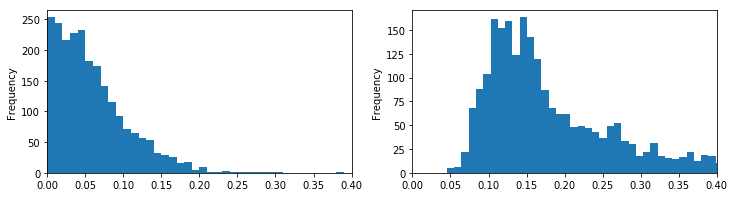

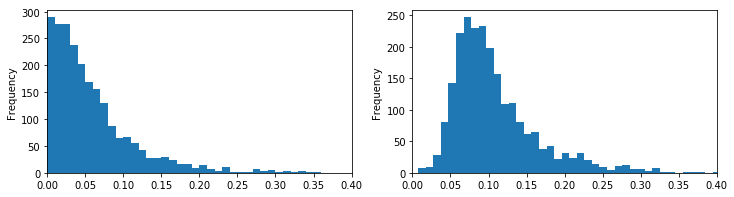

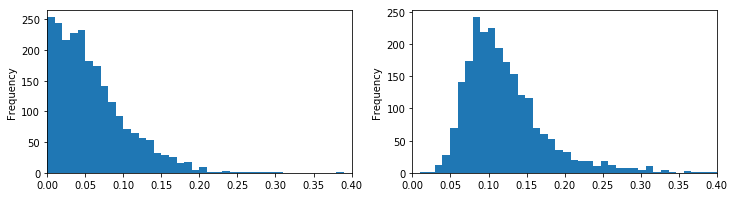

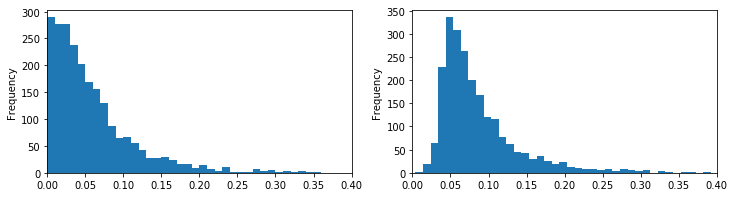

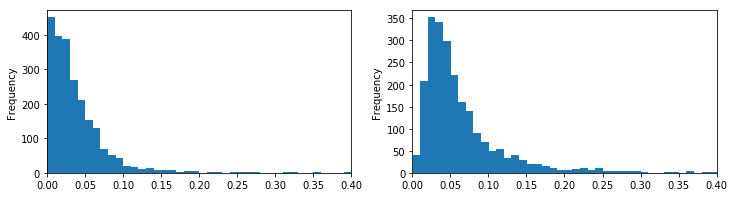

In [334]:

dat1 = np.abs(alphamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['delta'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas
plot_these_hists(dat1,dat2,xmax=0.4)

dat1 = np.abs(betamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['theta'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas
plot_these_hists(dat1,dat2,xmax=0.4)

dat1 = np.abs(gammamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas
plot_these_hists(dat1,dat2,xmax=0.4)
dat1 = np.abs(alphamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas
plot_these_hists(dat1,dat2,xmax=0.4)

dat1 = np.abs(betamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas
plot_these_hists(dat1,dat2,xmax=0.4)

dat1 = np.abs(gammamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas
plot_these_hists(dat1,dat2,xmax=0.4)

In [ ]:
plot_these_hists(dat1,dat2,xmax=0.4)

(0, 0.4)

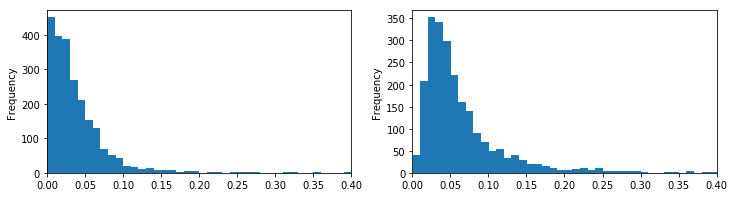

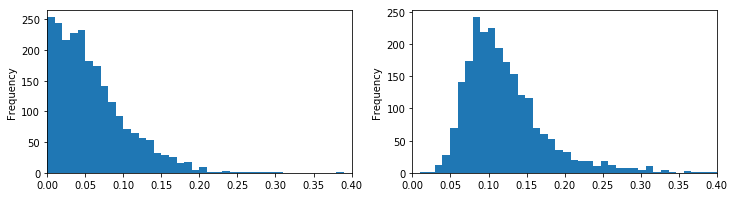

In [322]:
fig, ax = plt.subplots(ncols=2, figsize=(12,3))

dat1 = np.abs(alphamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas

dat1_nzidx = np.triu(np.abs(dat1),1).ravel()>0.
dat2_nzidx = np.triu(np.abs(dat2),1).ravel()>0.

pd.DataFrame(dat1.ravel()[dat1_nzidx])[0].plot(kind='hist', ax=ax[0],bins=100)#,xmin=0.,xmax=0.5)
ax[0].set_xlim([0,0.4])

pd.DataFrame(dat2.ravel()[dat2_nzidx])[0].plot(kind='hist', ax=ax[1],bins=100)#,xmin=0.,xmax=0.5)
ax[1].set_xlim([0,0.4])


(0, 0.4)

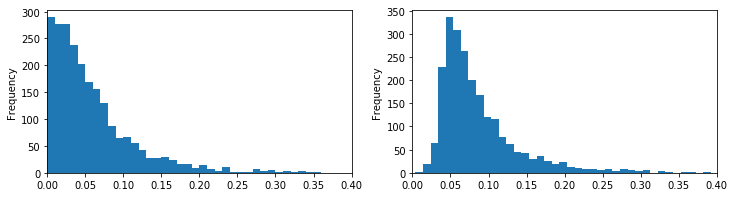

In [321]:
fig, ax = plt.subplots(ncols=2, figsize=(12,3))

dat1 = np.abs(betamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas

dat1_nzidx = np.triu(np.abs(dat1),1).ravel()>0.
dat2_nzidx = np.triu(np.abs(dat2),1).ravel()>0.

pd.DataFrame(dat1.ravel()[dat1_nzidx])[0].plot(kind='hist', ax=ax[0],bins=100)#,xmin=0.,xmax=0.5)
ax[0].set_xlim([0,0.4])

pd.DataFrame(dat2.ravel()[dat2_nzidx])[0].plot(kind='hist', ax=ax[1],bins=100)#,xmin=0.,xmax=0.5)
ax[1].set_xlim([0,0.4])




fig, ax = plt.subplots(ncols=2, figsize=(12,3))

dat1 = np.abs(alphamat_Io_0p5)*mas
dat2 = np.abs(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas

dat1_nzidx = np.triu(np.abs(dat1),1).ravel()>0.
dat2_nzidx = np.triu(np.abs(dat2),1).ravel()>0.

pd.DataFrame(dat1.ravel()[dat1_nzidx])[0].plot(kind='hist', ax=ax[0],bins=100)#,xmin=0.,xmax=0.5)
ax[0].set_xlim([0,0.4])

pd.DataFrame(dat2.ravel()[dat2_nzidx])[0].plot(kind='hist', ax=ax[1],bins=100)#,xmin=0.,xmax=0.5)
ax[1].set_xlim([0,0.4])


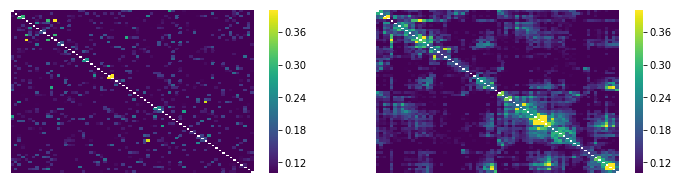

In [307]:
thr = 0.05

dat1 = np.abs(alphamat_Io_0p5)*mas
dat1[dat1<thr] = 0.

dat2 = np.abs(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx]*mas)*mas
dat2[dat2<thr] = 0.

fig, ax = plt.subplots(ncols=2,figsize=(12,3))

sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),xticklabels='',yticklabels='',ax=ax[0],
            vmin=0.1,vmax=0.4)
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),xticklabels='',yticklabels='',ax=ax[1],
            vmin=0.1,vmax=0.4)

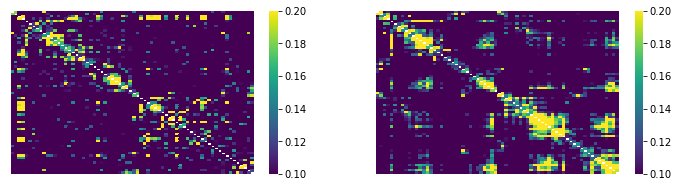

In [292]:
thr = 0.05

dat1 = np.abs(betamat_Io_0p5)*mas
dat1[dat1<thr] = 0.

dat2 = np.abs(aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx]*mas)*mas
dat2[dat2<thr] = 0.

fig, ax = plt.subplots(ncols=2,figsize=(12,3))

sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),xticklabels='',yticklabels='',ax=ax[0],
            vmin=0.1,vmax=0.2)
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),xticklabels='',yticklabels='',ax=ax[1],
            vmin=0.1,vmax=0.2)

In [303]:
dat1_nzidx = np.triu(np.abs(dat1),1).ravel()>0.
dat2_nzidx = np.triu(np.abs(dat2),1).ravel()>0.


In [304]:
print np.corrcoef(dat1.ravel()[dat1_nzidx],  dat2.ravel()[dat1_nzidx])[0,1]
print np.corrcoef(dat1.ravel()[dat2_nzidx],  dat2.ravel()[dat2_nzidx])[0,1]


0.3867016470977187
0.31781409487919404


In [298]:
np.corrcoef(dat1_n)

np.corrcoef(np.triu(dat1,1).ravel(),np.triu(dat2,1).ravel())

array([[1.        , 0.48420093],
       [0.48420093, 1.        ]])

In [295]:
np.corrcoef(dat1.ravel(),dat2.ravel())

array([[1.        , 0.30896814],
       [0.30896814, 1.        ]])

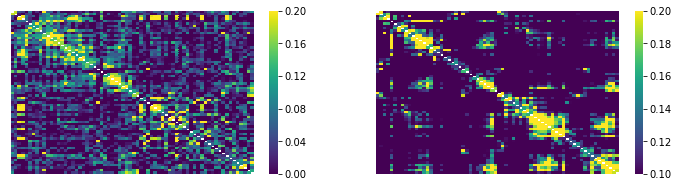

In [291]:
fig, ax = plt.subplots(ncols=2,figsize=(12,3))

sns.heatmap(betamat_Io_0p5,cmap='viridis',mask=np.eye(68),
            vmin=0.,vmax=0.2,
            xticklabels='',yticklabels='',ax=ax[0])
sns.heatmap(aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx]*mas,
            cmap='viridis',mask=np.eye(68),
            vmin=0.1,vmax=0.2,
            xticklabels='',yticklabels='',ax=ax[1])

In [ ]:
ax[0][0].imshow(betamat_Io_0p5*mas,vmin=0,vmax=0.2,interpolation='spline36')

In [219]:
mas = (np.eye(68)*-1)+1.

In [222]:
sns.heatmap?

In [223]:
plt.imshow?

In [ ]:
plt.imshow(betamat_Io_0p5*mas,vmin=0,vmax=0.2,interpolation='spline36')

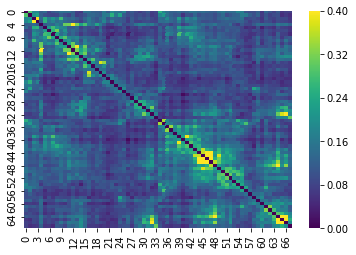

In [242]:
sns.heatmap(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx]*mas,cmap='viridis',
           vmin=0,vmax=0.4)#            vmin=0,vmax=0.2)


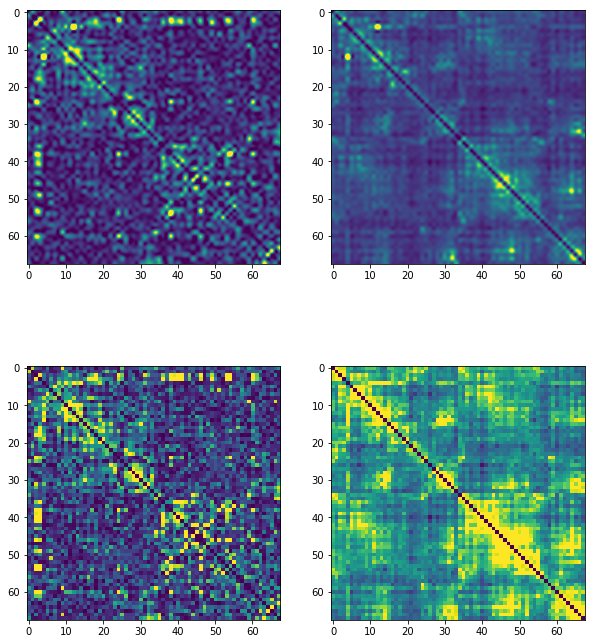

In [260]:
fig, ax = plt.subplots(ncols=2,nrows=2,figsize=(10,12))

ax[0][0].imshow(np.abs(betamat_Io_0p5)*mas,
                vmin=0,vmax=0.3,interpolation='spline36')#,interpolation='spline36')
ax[0][1].imshow(np.abs(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas,
                vmin=0.,vmax=0.5,interpolation='spline36')

ax[1][0].imshow(np.abs(betamat_Io_0p5)*mas,
                vmin=0,vmax=0.2)#, interpolation='spline36')
ax[1][1].imshow(np.abs(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx])*mas,
                vmin=0,vmax=0.2)


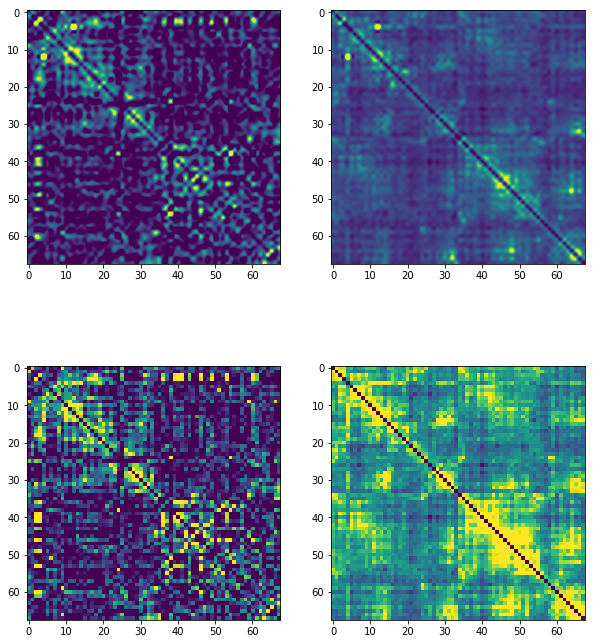

In [258]:
fig, ax = plt.subplots(ncols=2,nrows=2,figsize=(10,12))

ax[1][0].imshow(betamat_Io_0p5*mas,
                vmin=0,vmax=0.2)#, interpolation='spline36')
ax[1][1].imshow(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx]*mas,
                vmin=0,vmax=0.2)

ax[0][0].imshow(betamat_Io_0p5*mas,
                vmin=0,vmax=0.3,interpolation='spline36')#,interpolation='spline36')
ax[0][1].imshow(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx]*mas,
                vmin=0.,vmax=0.54,interpolation='spline36')

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58,
       59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75])

In [ ]:
betamat_Io_0[orig_to_abey_idx]

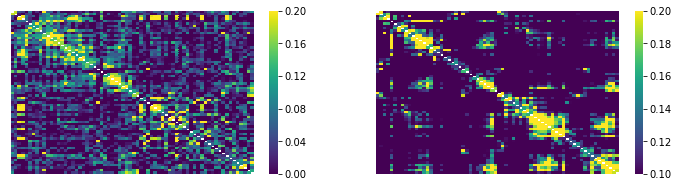

In [276]:
fig, ax = plt.subplots(ncols=2,figsize=(12,3))

sns.heatmap(betamat_Io_0p5,cmap='viridis',mask=np.eye(68),
            vmin=0.,vmax=0.2,
            xticklabels='',yticklabels='',ax=ax[0])
sns.heatmap(aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx]*mas,
            cmap='viridis',mask=np.eye(68),
            vmin=0.1,vmax=0.2,
            xticklabels='',yticklabels='',ax=ax[1])

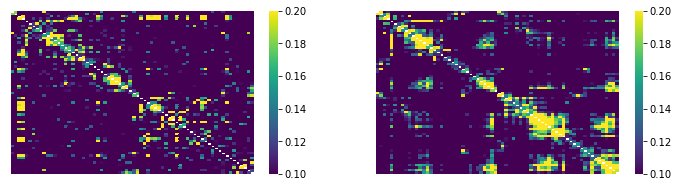

In [290]:
thr = 0.05

dat1 = np.abs(betamat_Io_0p5)*mas
dat1[dat1<thr] = 0.

dat2 = np.abs(aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx]*mas)*mas
dat2[dat2<thr] = 0.


fig, ax = plt.subplots(ncols=2,figsize=(12,3))


sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),xticklabels='',yticklabels='',ax=ax[0],
            vmin=0.1,vmax=0.2)
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),xticklabels='',yticklabels='',ax=ax[1],
            vmin=0.1,vmax=0.2)

In [ ]:
fig, ax = plt.subplots(ncols=2,figsize=(12,3))


sns.heatmap(betamat_Io_0p5,cmap='viridis',mask=np.eye(68),
            vmin=0.,vmax=0.2,
            xticklabels='',yticklabels='',ax=ax[0])
sns.heatmap(aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx]*mas,
            cmap='viridis',mask=np.eye(68),
            vmin=0.1,vmax=0.2,
            xticklabels='',yticklabels='',ax=ax[1])

---

In [197]:
run_net_sim??

In [187]:
from scipy.signal import welch
thing = welch(res_Io_0[0]['e'].T)

In [198]:
run_net_sim??

In [200]:
Dt=0.001
dat = res_Io_0[0]['e'].values
tmp = welch(dat.T,fs= 1./Dt)#,nperseg=welch_nperseg,noverlap=welch_noverlap)
df_wel = pd.DataFrame(tmp[1].T,index=tmp[0])
#df_wel.columns = df_all.columns


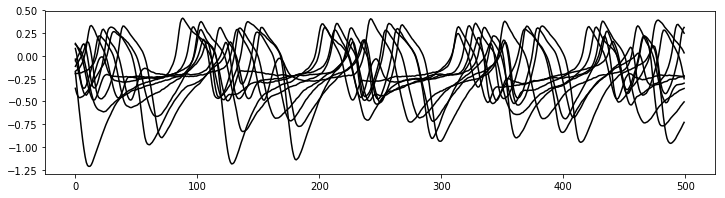

In [212]:
res_Io_0[0]['e'].iloc[:500,:10].plot(legend=False,figsize=(12,3),c='k')

In [205]:
dat.shape

(61440, 83)

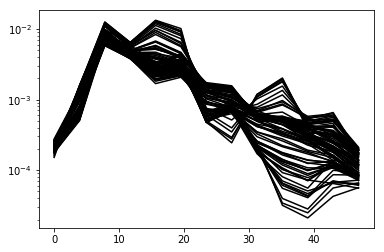

In [204]:
df_wel.loc[:50].plot(legend=False,c='k', logy=True)

In [191]:
_idx,_psd = thing

In [193]:
_df = pd.DataFrame(_psd.T,index=_idx)

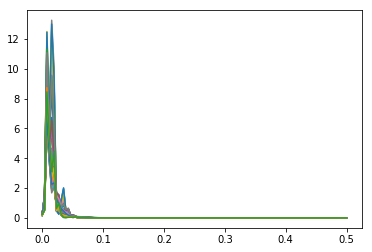

In [196]:
_df.loc[:5].plot(legend=False)

In [213]:
run_net_sim??

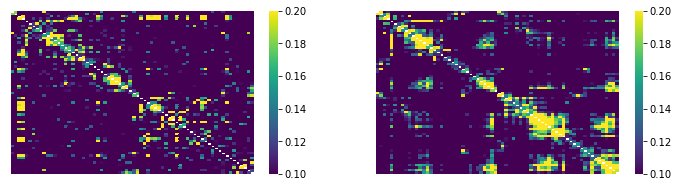

In [343]:
thr = 0.05

dat1 = np.abs(betamat_Io_0p5)*mas
dat1[dat1<thr] = 0.

dat2 = np.abs(aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx]*mas)*mas
dat2[dat2<thr] = 0.

fig, ax = plt.subplots(ncols=2,figsize=(12,3))

sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),xticklabels='',yticklabels='',ax=ax[0],
            vmin=0.1,vmax=0.2)
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),xticklabels='',yticklabels='',ax=ax[1],
            vmin=0.1,vmax=0.2)

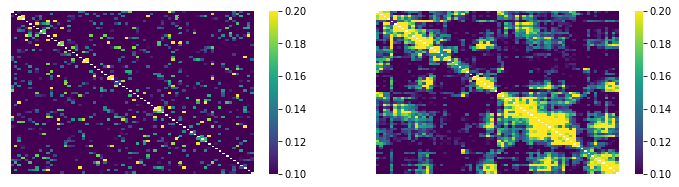

In [344]:
thr = 0.05

dat1 = np.abs(alphamat_Io_0p5)*mas
dat1[dat1<thr] = 0.

dat2 = np.abs(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx]*mas)*mas
dat2[dat2<thr] = 0.

fig, ax = plt.subplots(ncols=2,figsize=(12,3))

sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),xticklabels='',yticklabels='',ax=ax[0],
            vmin=0.1,vmax=0.2)
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),xticklabels='',yticklabels='',ax=ax[1],
            vmin=0.1,vmax=0.2)

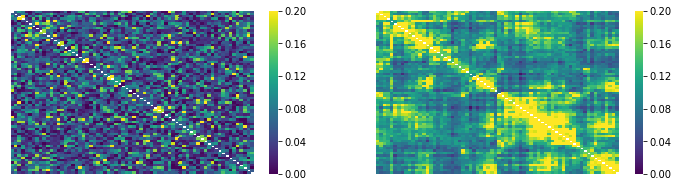

In [351]:
thr = 0.#05

dat1 = np.abs(alphamat_Io_0p5)*mas
dat1[dat1<thr] = 0.
dat2 = np.abs(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx]*mas)*mas
dat2[dat2<thr] = 0.

fig, ax = plt.subplots(ncols=2,figsize=(12,3))

sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),xticklabels='',yticklabels='',ax=ax[0],
            vmin=0.,vmax=0.2)
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),xticklabels='',yticklabels='',ax=ax[1],
            vmin=0.,vmax=0.2)

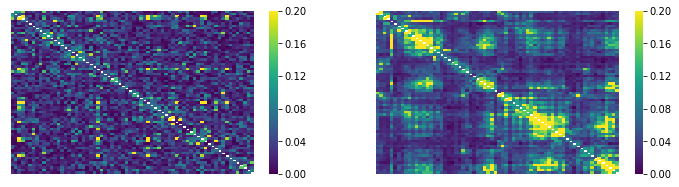

In [357]:
thr = 0.#05

dat1 = np.abs(gammamat_Io_0p5)*mas
dat1[dat1<thr] = 0.
dat2 = np.abs(aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx]*mas)*mas
dat2[dat2<thr] = 0.

fig, ax = plt.subplots(ncols=2,figsize=(12,3))

sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),xticklabels='',yticklabels='',ax=ax[0],
            vmin=0.,vmax=0.2)
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),xticklabels='',yticklabels='',ax=ax[1],
            vmin=0.,vmax=0.2)

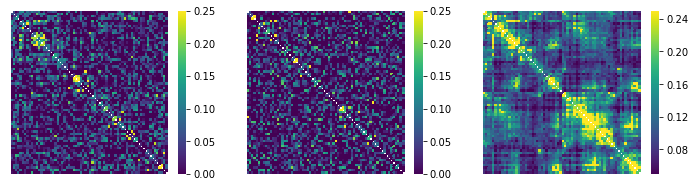

In [381]:
fig, ax = plt.subplots(ncols=3, figsize=(12,3))

dat1 = alphamat_Io_0.copy()
dat2 = alphamat_Io_0p5.copy()
dat3 = aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()

a = ax[0]
sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.25,ax=a,xticklabels='',yticklabels='')

a = ax[1]
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.25,ax=a,xticklabels='',yticklabels='')

a = ax[2]
sns.heatmap(dat3,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.25,ax=a,xticklabels='',yticklabels='')



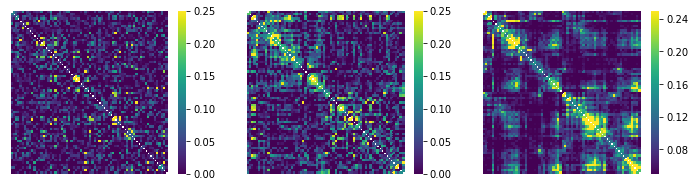

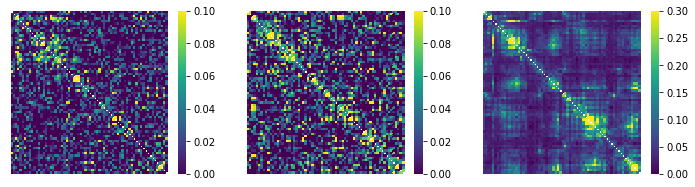

In [380]:
fig, ax = plt.subplots(ncols=3, figsize=(12,3))

dat1 = betamat_Io_0.copy()
dat2 = betamat_Io_0p5.copy()
dat3 = aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()

a = ax[0]
sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.25,ax=a,xticklabels='',yticklabels='')

a = ax[1]
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.25,ax=a,xticklabels='',yticklabels='')

a = ax[2]
sns.heatmap(dat3,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.25,ax=a,xticklabels='',yticklabels='')







fig, ax = plt.subplots(ncols=3, figsize=(12,3))

a = ax[0]
sns.heatmap(gammamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.1,ax=a,xticklabels='',yticklabels='')

a = ax[1]
sns.heatmap(gammamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.1,ax=a,xticklabels='',yticklabels='')

a = ax[2]
sns.heatmap(aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx],
            cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.3,ax=a,xticklabels='',yticklabels='')


In [ ]:
fig, ax = plt.subplots(ncols=4,nrows=6, figsize=(18,20))

a = ax[0][0]
res_Io_0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=a,alpha=0.1)
res_Io_0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=a,alpha=0.5,linewidth=3.)

a = ax[0][1]
res_Io_0p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=a,alpha=0.1)
res_Io_0p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=a,alpha=0.5,linewidth=3.)

a = ax[0][2]
res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=a,alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=a,alpha=0.5,linewidth=3.)

a = ax[0][3]
a.axis('off')



a = ax[1][0]
sns.heatmap(gammamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[1][1]
sns.heatmap(gammamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[1][2]
sns.heatmap(gammamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[1][3]
sns.heatmap(aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx],
            cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')





a = ax[2][0]
sns.heatmap(betamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[2][1]
sns.heatmap(betamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[2][2]
sns.heatmap(betamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[2][3]
sns.heatmap(aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx],
            cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')






a = ax[3][0]
sns.heatmap(alphamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[3][1]
sns.heatmap(alphamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[3][2]
sns.heatmap(alphamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')

a = ax[3][3]
sns.heatmap(aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx],
            cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')


a = ax[4][0]
sns.heatmap(thetamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[4][1]
sns.heatmap(thetamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[4][2]
sns.heatmap(thetamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[4][3]
sns.heatmap(aec_mean['theta'][orig_to_abey_idx,:][:,orig_to_abey_idx],
            cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')



a = ax[5][0]
sns.heatmap(deltamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[5][1]
sns.heatmap(deltamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[5][2]
sns.heatmap(deltamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.,ax=a,xticklabels='',yticklabels='')

a = ax[5][3]
sns.heatmap(aec_mean['delta'][orig_to_abey_idx,:][:,orig_to_abey_idx],
            cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')






plt.tight_layout()

In [ ]:
fig, ax = plt.subplots(ncols=2, figsize=(12,3))
dat1 = alphamat_Io_0.copy()
dat2 = alphamat_Io_0p5.copy()
dat3 = aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
a = ax[0]
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.25,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(dat3,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.25,ax=a,xticklabels='',yticklabels='')

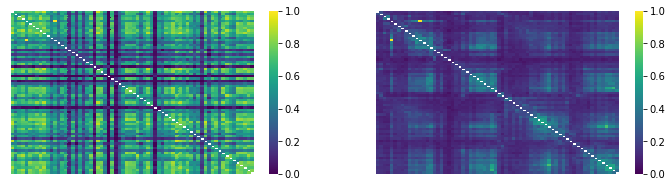

In [412]:
dat1 = deltamat_Io_0.copy()
dat2 = deltamat_Io_0p5.copy()
dat3 = aec_mean['delta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
fig, ax = plt.subplots(ncols=2, figsize=(12,3))
a = ax[0]
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.0,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(dat3,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=1.0,ax=a,xticklabels='',yticklabels='')


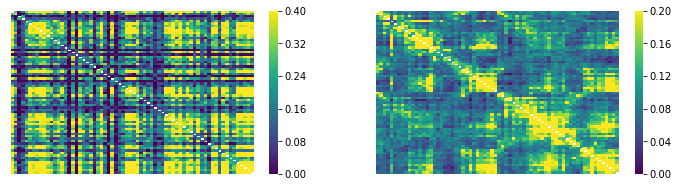

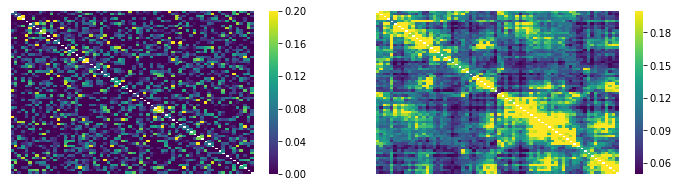

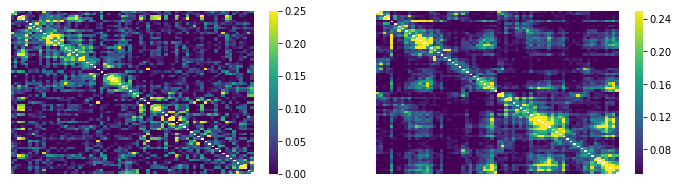

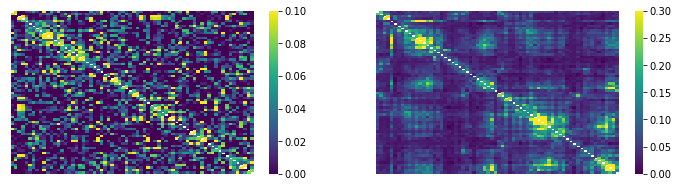

In [462]:
dat1 = thetamat_Io_0.copy()
dat2 = thetamat_Io_0p5.copy()
dat3 = aec_mean['theta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
fig, ax = plt.subplots(ncols=2, figsize=(12,3))
a = ax[0]
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.4,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(dat3,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')


dat1 = alphamat_Io_0.copy()
dat2 = alphamat_Io_0p5.copy()
dat3 = aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
fig, ax = plt.subplots(ncols=2, figsize=(12,3))
a = ax[0]
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(dat3,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')



dat1 = betamat_Io_0.copy()
dat2 = betamat_Io_0p5.copy()
dat3 = aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
fig, ax = plt.subplots(ncols=2, figsize=(12,3))
a = ax[0]
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.25,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(dat3,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.25,ax=a,xticklabels='',yticklabels='')


dat1 = gammamat_Io_0.copy()
dat2 = gammamat_Io_0p5.copy()
dat3 = aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
fig, ax = plt.subplots(ncols=2, figsize=(12,3))
a = ax[0]
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(dat3,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.3,ax=a,xticklabels='',yticklabels='')



0.288503322196372
0.2636403447469485
0.23416519451580034


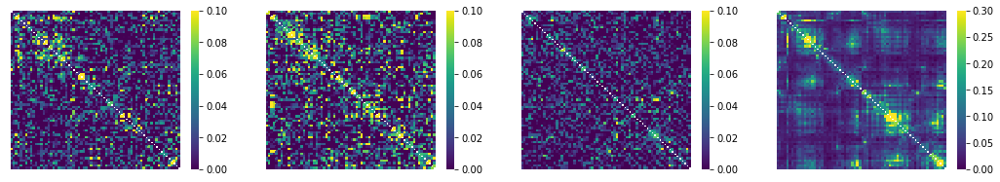

In [484]:
dat1 = gammamat_Io_0.copy()
dat2 = gammamat_Io_0p5.copy()
dat3 = gammamat_Io_1p5.copy()
dat4 = aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()

dat1_ut = np.triu(dat1,1)
dat2_ut = np.triu(dat2,1)
dat3_ut = np.triu(dat3,1)
dat4_ut = np.triu(dat4,1)

dat1_nzidx = np.abs(dat1_ut).ravel()>0
dat2_nzidx = np.abs(dat2_ut).ravel()>0
dat3_nzidx = np.abs(dat3_ut).ravel()>0
dat4_nzidx = np.abs(dat4_ut).ravel()>0

print '%s' %np.corrcoef(dat1.ravel()[dat1_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

print '%s' %np.corrcoef(dat2.ravel()[dat2_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

print '%s' %np.corrcoef(dat3.ravel()[dat3_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

dat1 = gammamat_Io_0.copy()
dat2 = gammamat_Io_0p5.copy()
dat3 = gammamat_Io_1p5.copy()
dat4 = aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()

dat1_ut = np.triu(dat1,1)
dat2_ut = np.triu(dat2,1)
dat3_ut = np.triu(dat3,1)
dat4_ut = np.triu(dat4,1)

dat1_nzidx = np.abs(dat1_ut).ravel()>0
dat2_nzidx = np.abs(dat2_ut).ravel()>0
dat3_nzidx = np.abs(dat3_ut).ravel()>0
dat4_nzidx = np.abs(dat4_ut).ravel()>0


fig, ax = plt.subplots(ncols=4, figsize=(18,3))
a = ax[0]
sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(dat3,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(dat4,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.3,ax=a,xticklabels='',yticklabels='')


Figure X. Gamma-frequency functional connectivity in model vs. experiment. Figure shows FC for I_o = 0 and I        

_o=0.5, and from empirical meg data. I_o = 0.5 is better 



In [ ]:

dat1 = gammamat_Io_0.copy()
dat2 = gammamat_Io_0p5.copy()
dat3 = gammamat_Io_1p5.copy()
dat4 = aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()

dat1_ut = np.triu(dat1,1)
dat2_ut = np.triu(dat2,1)
dat3_ut = np.triu(dat3,1)
dat4_ut = np.triu(dat4,1)

dat1_nzidx = np.abs(dat1_ut).ravel()>0
dat2_nzidx = np.abs(dat2_ut).ravel()>0
dat3_nzidx = np.abs(dat3_ut).ravel()>0
dat4_nzidx = np.abs(dat4_ut).ravel()>0


fig, ax = plt.subplots(ncols=4, figsize=(18,3))
a = ax[0]
sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.25,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.25,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(dat3,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.25,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(dat4,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.25,ax=a,xticklabels='',yticklabels='')


0.2178684957186838
0.10875189309037969
0.249688397278841
0.20090152270903602
0.32735315925923075
0.28750894996044
0.288503322196372
0.2636403447469485
0.23416519451580034


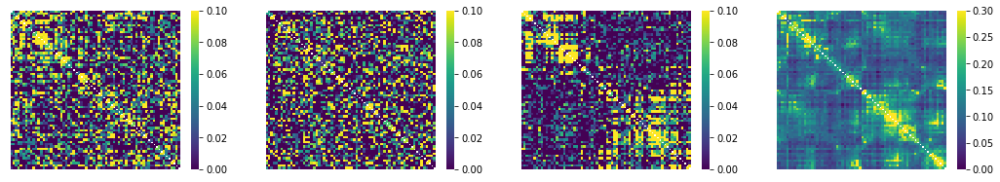

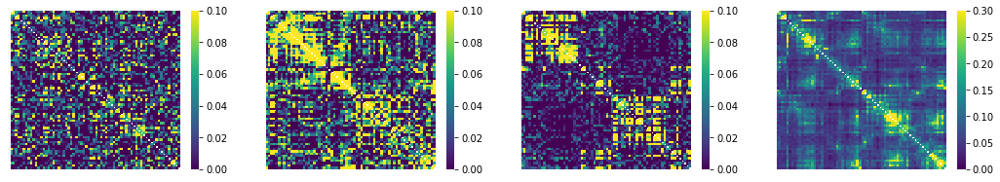

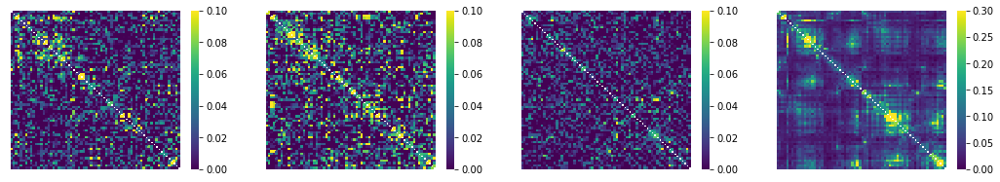

In [485]:
dat1 = alphamat_Io_0.copy()
dat2 = alphamat_Io_0p5.copy()
dat3 = alphamat_Io_1p5.copy()
dat4 = aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()

dat1_ut = np.triu(dat1,1)
dat2_ut = np.triu(dat2,1)
dat3_ut = np.triu(dat3,1)
dat4_ut = np.triu(dat4,1)

dat1_nzidx = np.abs(dat1_ut).ravel()>0
dat2_nzidx = np.abs(dat2_ut).ravel()>0
dat3_nzidx = np.abs(dat3_ut).ravel()>0
dat4_nzidx = np.abs(dat4_ut).ravel()>0

print '%s' %np.corrcoef(dat1.ravel()[dat1_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

print '%s' %np.corrcoef(dat2.ravel()[dat2_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

print '%s' %np.corrcoef(dat3.ravel()[dat3_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]


fig, ax = plt.subplots(ncols=4, figsize=(18,3))
a = ax[0]
sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(dat3,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(dat4,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.3,ax=a,xticklabels='',yticklabels='')








dat1 = betamat_Io_0.copy()
dat2 = betamat_Io_0p5.copy()
dat3 = betamat_Io_1p5.copy()
dat4 = aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()

dat1_ut = np.triu(dat1,1)
dat2_ut = np.triu(dat2,1)
dat3_ut = np.triu(dat3,1)
dat4_ut = np.triu(dat4,1)

dat1_nzidx = np.abs(dat1_ut).ravel()>0
dat2_nzidx = np.abs(dat2_ut).ravel()>0
dat3_nzidx = np.abs(dat3_ut).ravel()>0
dat4_nzidx = np.abs(dat4_ut).ravel()>0

print '%s' %np.corrcoef(dat1.ravel()[dat1_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

print '%s' %np.corrcoef(dat2.ravel()[dat2_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

print '%s' %np.corrcoef(dat3.ravel()[dat3_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]


fig, ax = plt.subplots(ncols=4, figsize=(18,3))
a = ax[0]
sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(dat3,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(dat4,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.3,ax=a,xticklabels='',yticklabels='')







dat1 = gammamat_Io_0.copy()
dat2 = gammamat_Io_0p5.copy()
dat3 = gammamat_Io_1p5.copy()
dat4 = aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()

dat1_ut = np.triu(dat1,1)
dat2_ut = np.triu(dat2,1)
dat3_ut = np.triu(dat3,1)
dat4_ut = np.triu(dat4,1)

dat1_nzidx = np.abs(dat1_ut).ravel()>0
dat2_nzidx = np.abs(dat2_ut).ravel()>0
dat3_nzidx = np.abs(dat3_ut).ravel()>0
dat4_nzidx = np.abs(dat4_ut).ravel()>0

print '%s' %np.corrcoef(dat1.ravel()[dat1_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

print '%s' %np.corrcoef(dat2.ravel()[dat2_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

print '%s' %np.corrcoef(dat3.ravel()[dat3_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

fig, ax = plt.subplots(ncols=4, figsize=(18,3))
a = ax[0]
sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(dat3,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(dat4,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.3,ax=a,xticklabels='',yticklabels='')


In [669]:
matsdict = {}
matsdict[('t', 'i0')] = thetamat_Io_0.copy()
matsdict[('t', 'i0p5')] = thetamat_Io_0p5.copy()
matsdict[('t', 'i1p5')] = thetamat_Io_1p5.copy()
matsdict[('t', 'ed')]  = aec_mean['theta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
matsdict[('a', 'i0')] = alphamat_Io_0.copy()
matsdict[('a', 'i0p5')] = alphamat_Io_0p5.copy()
matsdict[('a', 'i1p5')] = alphamat_Io_1p5.copy()
matsdict[('a', 'ed')]  = aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
matsdict[('b', 'i0')] = betamat_Io_0.copy()
matsdict[('b', 'i0p5')] = betamat_Io_0p5.copy()
matsdict[('b', 'i1p5')] = betamat_Io_1p5.copy()
matsdict[('b', 'ed')]  = aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
matsdict[('g', 'i0')] =  gammamat_Io_0.copy()
matsdict[('g', 'i0p5')] = gammamat_Io_0p5.copy()
matsdict[('g', 'i1p5')] = gammamat_Io_1p5.copy()
matsdict[('g', 'ed')] = aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()

dfm = pd.DataFrame({k: v.ravel() for k,v in matsdict.items()})#.corr()

In [674]:
#dfm==1

In [675]:
cols_idx_nz = np.nonzero(cols_idx)[0]

In [683]:
dfm.corr()['g']['ed']

a  ed      0.972663
   i0      0.806539
   i0p5    0.772562
   i1p5    0.734172
b  ed      0.990252
   i0      0.820930
   i0p5    0.821390
   i1p5    0.783749
g  ed      1.000000
   i0      0.880568
   i0p5    0.854643
   i1p5    0.884182
t  ed      0.971618
   i0      0.739648
   i0p5    0.527030
   i1p5    0.719207
Name: ed, dtype: float64

In [677]:
dfm.corr().values[cols_idx_nz,:][:,cols_idx_nz]

IndexError: index 16 is out of bounds for axis 0 with size 16

In [664]:
cols_idx_nz

array([   1,    2,    3, ..., 4620, 4621, 4622])

In [668]:
dfmc.iloc[cols_idx_nz,:]['g'].corr()['e']

KeyError: 'e'

In [659]:
cols_idx_nz

array([   1,    2,    3, ..., 4620, 4621, 4622])

In [684]:
cols_idx = ((dfmc==1).sum(axis=1)==0.).values
cols_idx_nz = np.nonzero(cols_idx)[0]
#dfmc.iloc[cols_idx_nz,cols_idx_nz]

In [636]:
dfmc[dfmc.sum(axis=1)!=16]['g'].corr()['ed']

ed      1.000000
i0      0.155196
i0p5    0.161459
i1p5    0.039340
Name: ed, dtype: float64

In [639]:
dfmc['b'].corr()['ed']

ed      1.000000
i0      0.813224
i0p5    0.817275
i1p5    0.781562
Name: ed, dtype: float64

In [638]:
dfmc['g'].corr()['ed']

ed      1.000000
i0      0.880568
i0p5    0.854643
i1p5    0.884182
Name: ed, dtype: float64

In [617]:
dfmc.drop??

In [623]:
dfmc.values==1.0

array([[ True,  True,  True, ...,  True,  True,  True],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [ True,  True,  True, ...,  True,  True,  True]])

In [619]:
dfmc.drop(dfmc.values==1.0)#,axis=1)

KeyError: '[(True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True)\n (False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False)\n (False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False)\n ...\n (False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False)\n (False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False)\n (True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True)] not found in axis'

In [603]:
dfmc['a']['ed'].unstack()[['i0', 'i0p5', 'i1p5']].loc['a']

i0      0.796433
i0p5    0.756041
i1p5    0.742090
Name: a, dtype: float64

In [604]:
dfmc['b']['ed'].unstack()[['i0', 'i0p5', 'i1p5']].loc['b']

i0      0.813224
i0p5    0.817275
i1p5    0.781562
Name: b, dtype: float64

In [605]:
dfmc['g']['ed'].unstack()[['i0', 'i0p5', 'i1p5']].loc['g']

i0      0.880568
i0p5    0.854643
i1p5    0.884182
Name: g, dtype: float64

In [ ]:
dfmc['a']['ed'].unstack()[['i0', 'i0p5', 'i1p5']].loc['a']

In [593]:
dfmc['g']['ed']

a  ed      0.972663
   i0      0.806539
   i0p5    0.772562
   i1p5    0.734172
b  ed      0.990252
   i0      0.820930
   i0p5    0.821390
   i1p5    0.783749
g  ed      1.000000
   i0      0.880568
   i0p5    0.854643
   i1p5    0.884182
t  ed      0.971618
   i0      0.739648
   i0p5    0.527030
   i1p5    0.719207
Name: ed, dtype: float64

In [591]:
dfmc['g']['ed'].unstack()[['i0', 'i0p5', 'i1p5']].loc[['t', 'a', 'b', 'g']]

,i0,i0p5,i1p5
t,0.739648,0.527030,0.719207
a,0.806539,0.772562,0.734172
b,0.820930,0.821390,0.783749
g,0.880568,0.854643,0.884182


In [571]:
matsarr = np.array([v.ravel() for k,v in matsdict.items()])
df_matsarr = pd.DataFrame(matsarr,index=matsdict.keys()).T
dfm = df_matsarr.copy()
dfmc = dfm.corr()
dfmc[dfmc==1.0] = 0.
#dfmc.max().sort_values(ascending=False)

In [575]:
dfmc = dfmc[[c for c in dfmc.columns if '_ed' in c]].loc[[c for c in dfmc.columns if '_ed' not in c]]

In [576]:
dfmc

,dat4_a_ed,dat4_b_ed,dat4_t_ed,dat4_g_ed
dat3_a_i1p5,0.742090,0.736221,0.725643,0.734172
dat3_g_i1p5,0.867306,0.874868,0.862872,0.884182
dat1_b_i0,0.809279,0.813224,0.801981,0.820930
dat1_a_i0,0.796433,0.798801,0.784288,0.806539
dat2_a_i0p5,0.756041,0.762722,0.750192,0.772562
dat3_t_i1p5,0.711145,0.715857,0.704725,0.719207
dat2_t_i0p5,0.504224,0.527894,0.514651,0.527030
dat1_t_i0,0.734609,0.735144,0.721607,0.739648
dat1_g_i0,0.864331,0.872696,0.857076,0.880568
dat2_g_i0p5,0.840178,0.847651,0.836484,0.854643


In [570]:
dfmc.corr()

,dat3_a_i1p5,dat3_g_i1p5,dat1_b_i0,dat4_a_ed,dat1_a_i0,dat2_a_i0p5,dat4_b_ed,dat4_t_ed,dat3_t_i1p5,dat2_t_i0p5,dat1_t_i0,dat1_g_i0,dat4_g_ed,dat2_g_i0p5,dat3_b_i1p5,dat2_b_i0p5
dat3_a_i1p5,0.000000,0.784472,0.703616,0.742090,0.703778,0.664450,0.736221,0.725643,0.773567,0.383063,0.603222,0.763841,0.734172,0.746928,0.831985,0.742737
dat3_g_i1p5,0.784472,0.000000,0.868055,0.867306,0.847876,0.831171,0.874868,0.862872,0.768832,0.482297,0.751671,0.935288,0.884182,0.902923,0.811817,0.834248
dat1_b_i0,0.703616,0.868055,0.000000,0.809279,0.820931,0.752498,0.813224,0.801981,0.702512,0.458242,0.721673,0.910704,0.820930,0.835390,0.723670,0.773849
dat4_a_ed,0.742090,0.867306,0.809279,0.000000,0.796433,0.756041,0.979439,0.972549,0.711145,0.504224,0.734609,0.864331,0.972663,0.840178,0.780852,0.815612
dat1_a_i0,0.703778,0.847876,0.820931,0.796433,0.000000,0.739532,0.798801,0.784288,0.685047,0.429377,0.694041,0.857593,0.806539,0.819458,0.742387,0.787834
dat2_a_i0p5,0.664450,0.831171,0.752498,0.756041,0.739532,0.000000,0.762722,0.750192,0.647532,0.447528,0.659262,0.821335,0.772562,0.813181,0.698389,0.764648
dat4_b_ed,0.736221,0.874868,0.813224,0.979439,0.798801,0.762722,0.000000,0.978741,0.715857,0.527894,0.735144,0.872696,0.990252,0.847651,0.781562,0.817275
dat4_t_ed,0.725643,0.862872,0.801981,0.972549,0.784288,0.750192,0.978741,0.000000,0.704725,0.514651,0.721607,0.857076,0.971618,0.836484,0.768872,0.805229
dat3_t_i1p5,0.773567,0.768832,0.702512,0.711145,0.685047,0.647532,0.715857,0.704725,0.000000,0.413297,0.628401,0.760754,0.719207,0.724146,0.748988,0.707223
dat2_t_i0p5,0.383063,0.482297,0.458242,0.504224,0.429377,0.447528,0.527894,0.514651,0.413297,0.000000,0.600828,0.490118,0.527030,0.497546,0.401841,0.461521


In [569]:
dfmc['dat4_a_ed'].sort_values(ascending=False)

dat4_b_ed      0.979439
dat4_g_ed      0.972663
dat4_t_ed      0.972549
dat3_g_i1p5    0.867306
dat1_g_i0      0.864331
dat2_g_i0p5    0.840178
dat2_b_i0p5    0.815612
dat1_b_i0      0.809279
dat1_a_i0      0.796433
dat3_b_i1p5    0.780852
dat2_a_i0p5    0.756041
dat3_a_i1p5    0.742090
dat1_t_i0      0.734609
dat3_t_i1p5    0.711145
dat2_t_i0p5    0.504224
dat4_a_ed      0.000000
Name: dat4_a_ed, dtype: float64

In [566]:
dfmc['dat3_a_ed']

KeyError: 'dat3_a_ed'

In [556]:
dfmc.max()

dat3_a_i1p5    1.0
dat3_g_i1p5    1.0
dat1_b_i0      1.0
dat4_a_ed      1.0
dat1_a_i0      1.0
dat2_a_i0p5    1.0
dat4_b_ed      1.0
dat4_t_ed      1.0
dat3_t_i1p5    1.0
dat2_t_i0p5    1.0
dat1_t_i0      1.0
dat1_g_i0      1.0
dat4_g_ed      1.0
dat2_g_i0p5    1.0
dat3_b_i1p5    1.0
dat2_b_i0p5    1.0
dtype: float64

In [554]:
dfmc.sort_values(ascending=False)

TypeError: sort_values() takes at least 2 arguments (2 given)

In [551]:
dfm.corr()

,dat3_a_i1p5,dat3_g_i1p5,dat1_b_i0,dat4_a_ed,dat1_a_i0,dat2_a_i0p5,dat4_b_ed,dat4_t_ed,dat3_t_i1p5,dat2_t_i0p5,dat1_t_i0,dat1_g_i0,dat4_g_ed,dat2_g_i0p5,dat3_b_i1p5,dat2_b_i0p5
dat3_a_i1p5,1.000000,0.212978,0.065498,0.203213,0.110653,0.023325,0.164612,0.157596,0.435903,0.001575,0.021732,0.135126,0.137292,0.149008,0.556094,0.266424
dat3_g_i1p5,0.212978,1.000000,0.038704,0.066909,0.031681,0.017105,0.040750,0.059383,0.092423,-0.017831,-0.000625,0.046389,0.041250,0.084110,0.191985,0.091610
dat1_b_i0,0.065498,0.038704,1.000000,0.135449,0.239282,0.005462,0.116310,0.116791,0.059499,0.047130,0.137528,0.476208,0.117316,0.129238,0.037989,0.111214
dat4_a_ed,0.203213,0.066909,0.135449,1.000000,0.149214,0.033907,0.907338,0.885289,0.101639,0.192329,0.201600,0.164149,0.869974,0.170457,0.252154,0.288749
dat1_a_i0,0.110653,0.031681,0.239282,0.149214,1.000000,0.020917,0.125866,0.111399,0.049851,0.003244,0.091161,0.215837,0.127997,0.132970,0.153278,0.218467
dat2_a_i0p5,0.023325,0.017105,0.005462,0.033907,0.020917,1.000000,0.025080,0.023252,-0.029216,0.055935,0.017821,0.069434,0.032925,0.164244,0.044740,0.171605
dat4_b_ed,0.164612,0.040750,0.116310,0.907338,0.125866,0.025080,1.000000,0.907573,0.092849,0.236686,0.180702,0.159278,0.951616,0.166307,0.235776,0.272506
dat4_t_ed,0.157596,0.059383,0.116791,0.885289,0.111399,0.023252,0.907573,1.000000,0.088791,0.214759,0.165620,0.137850,0.871080,0.167627,0.218831,0.258149
dat3_t_i1p5,0.435903,0.092423,0.059499,0.101639,0.049851,-0.029216,0.092849,0.088791,1.000000,0.055534,0.082484,0.114962,0.081057,0.056126,0.333782,0.160675
dat2_t_i0p5,0.001575,-0.017831,0.047130,0.192329,0.003244,0.055935,0.236686,0.214759,0.055534,1.000000,0.400558,0.060613,0.225835,0.121190,0.006549,0.096625


In [544]:
df_matsarr[df_matsarrmax()

dat3_a_i1p5    1.0
dat3_g_i1p5    1.0
dat1_b_i0      1.0
dat4_a_ed      1.0
dat1_a_i0      1.0
dat2_a_i0p5    1.0
dat4_b_ed      1.0
dat4_t_ed      1.0
dat3_t_i1p5    1.0
dat2_t_i0p5    1.0
dat1_t_i0      1.0
dat1_g_i0      1.0
dat4_g_ed      1.0
dat2_g_i0p5    1.0
dat3_b_i1p5    1.0
dat2_b_i0p5    1.0
dtype: float64

In [539]:
df_matsarr[a_cols[0]].abs().sort_values(ascending=False)

4623    1.000000
2829    1.000000
3243    1.000000
3174    1.000000
3105    1.000000
3036    1.000000
2967    1.000000
2898    1.000000
2760    1.000000
2208    1.000000
2691    1.000000
2622    1.000000
2553    1.000000
2484    1.000000
2415    1.000000
2346    1.000000
3312    1.000000
3381    1.000000
3450    1.000000
3519    1.000000
3588    1.000000
3657    1.000000
3726    1.000000
3795    1.000000
3864    1.000000
3933    1.000000
4002    1.000000
4071    1.000000
4140    1.000000
4209    1.000000
          ...   
3977    0.000499
2302    0.000499
778     0.000465
2051    0.000465
2585    0.000457
106     0.000457
3289    0.000429
1748    0.000429
782     0.000367
2323    0.000367
1903    0.000318
4583    0.000318
4026    0.000283
1011    0.000283
2916    0.000259
4122    0.000259
1463    0.000251
2401    0.000251
1427    0.000234
4576    0.000234
717     0.000208
2526    0.000208
130     0.000162
4217    0.000162
705     0.000107
1710    0.000107
2881    0.000060
1742    0.0000

In [521]:
df_matsarr.corr()['dat4_b_ed'].sort_values(ascending=False)

dat4_b_ed      1.000000
dat4_g_ed      0.990252
dat4_a_ed      0.979439
dat4_t_ed      0.978741
dat3_g_i1p5    0.874868
dat1_g_i0      0.872696
dat2_g_i0p5    0.847651
dat2_b_i0p5    0.817275
dat1_b_i0      0.813224
dat1_a_i0      0.798801
dat3_b_i1p5    0.781562
dat2_a_i0p5    0.762722
dat3_a_i1p5    0.736221
dat1_t_i0      0.735144
dat3_t_i1p5    0.715857
dat2_t_i0p5    0.527894
Name: dat4_b_ed, dtype: float64

In [516]:
df_matsarr.corr()

(4624, 16)

In [514]:
df_matsarr.shape

(4624, 16)

In [495]:
df_matsdict = 


pd.DataFrame(np.array({k: v.ravel() for k,v in matsdict.items()}))

ValueError: Must pass 2-d input

In [489]:
dat1_t_i0

array([[ 1.        ,  0.19629117,  0.07863548, ...,  0.13541229,
         0.46627272,  0.21828629],
       [ 0.19629117,  1.        , -0.05477491, ...,  0.15470516,
         0.1390935 ,  0.03834046],
       [ 0.07863548, -0.05477491,  1.        , ..., -0.06861121,
        -0.00914798,  0.05155105],
       ...,
       [ 0.13541229,  0.15470516, -0.06861121, ...,  1.        ,
         0.11024772,  0.09603993],
       [ 0.46627272,  0.1390935 , -0.00914798, ...,  0.11024772,
         1.        ,  0.29707998],
       [ 0.21828629,  0.03834046,  0.05155105, ...,  0.09603993,
         0.29707998,  1.        ]])

In [ ]:
dat1_g_i0

0.288503322196372
0.2636403447469485
0.23416519451580034
0.20090152270903602
0.32735315925923075
0.28750894996044
0.288503322196372
0.2636403447469485
0.23416519451580034


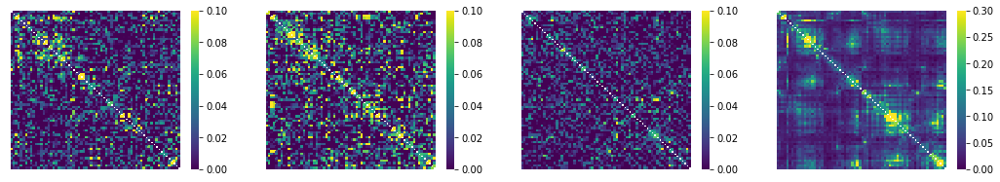

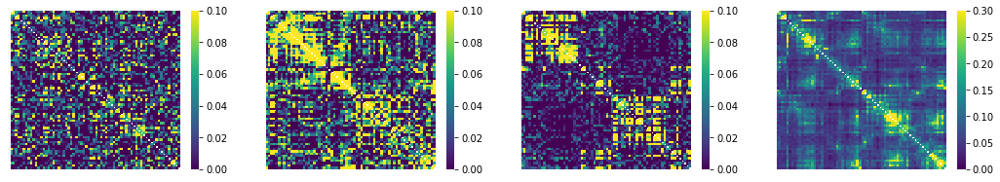

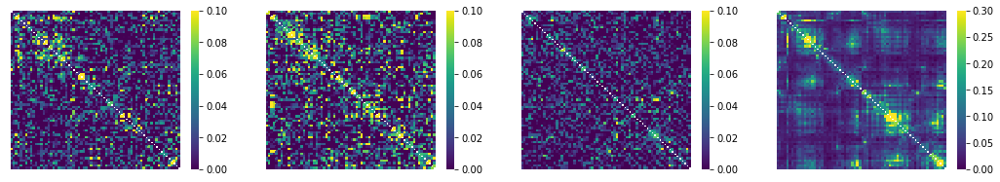

In [690]:
dat1_a_i0 = alphamat_Io_0.copy()
dat2_a_i0 = alphamat_Io_0p5.copy()
dat3_a_i0 = alphamat_Io_1p5.copy()
dat4_a_ed  = aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()

dat1_ut = np.triu(dat1,1)
dat2_ut = np.triu(dat2,1)
dat3_ut = np.triu(dat3,1)
dat4_ut = np.triu(dat4,1)

dat1_nzidx = np.abs(dat1_ut).ravel()>0
dat2_nzidx = np.abs(dat2_ut).ravel()>0
dat3_nzidx = np.abs(dat3_ut).ravel()>0
dat4_nzidx = np.abs(dat4_ut).ravel()>0

print '%s' %np.corrcoef(dat1.ravel()[dat1_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

print '%s' %np.corrcoef(dat2.ravel()[dat2_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

print '%s' %np.corrcoef(dat3.ravel()[dat3_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]


fig, ax = plt.subplots(ncols=4, figsize=(18,3))
a = ax[0]
sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(dat3,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(dat4,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.3,ax=a,xticklabels='',yticklabels='')








dat1 = betamat_Io_0.copy()
dat2 = betamat_Io_0p5.copy()
dat3 = betamat_Io_1p5.copy()
dat4 = aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()

dat1_ut = np.triu(dat1,1)
dat2_ut = np.triu(dat2,1)
dat3_ut = np.triu(dat3,1)
dat4_ut = np.triu(dat4,1)

dat1_nzidx = np.abs(dat1_ut).ravel()>0
dat2_nzidx = np.abs(dat2_ut).ravel()>0
dat3_nzidx = np.abs(dat3_ut).ravel()>0
dat4_nzidx = np.abs(dat4_ut).ravel()>0

print '%s' %np.corrcoef(dat1.ravel()[dat1_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

print '%s' %np.corrcoef(dat2.ravel()[dat2_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

print '%s' %np.corrcoef(dat3.ravel()[dat3_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]


fig, ax = plt.subplots(ncols=4, figsize=(18,3))
a = ax[0]
sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(dat3,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(dat4,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.3,ax=a,xticklabels='',yticklabels='')







dat1 = gammamat_Io_0.copy()
dat2 = gammamat_Io_0p5.copy()
dat3 = gammamat_Io_1p5.copy()
dat4 = aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()

dat1_ut = np.triu(dat1,1)
dat2_ut = np.triu(dat2,1)
dat3_ut = np.triu(dat3,1)
dat4_ut = np.triu(dat4,1)

dat1_nzidx = np.abs(dat1_ut).ravel()>0
dat2_nzidx = np.abs(dat2_ut).ravel()>0
dat3_nzidx = np.abs(dat3_ut).ravel()>0
dat4_nzidx = np.abs(dat4_ut).ravel()>0

print '%s' %np.corrcoef(dat1.ravel()[dat1_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

print '%s' %np.corrcoef(dat2.ravel()[dat2_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

print '%s' %np.corrcoef(dat3.ravel()[dat3_nzidx],
            dat4.ravel()[dat4_nzidx])[0,1]

fig, ax = plt.subplots(ncols=4, figsize=(18,3))
a = ax[0]
sns.heatmap(dat1,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(dat2,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(dat3,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.1,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(dat4,cmap='viridis',mask=np.eye(68),vmin=0.0,vmax=0.3,ax=a,xticklabels='',yticklabels='')

---

In [ ]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=0.5, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res2 = run_net_sim(**ssX_params)

res_aecs_2 =  aec(res2[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res2[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res2[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res2[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res2[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

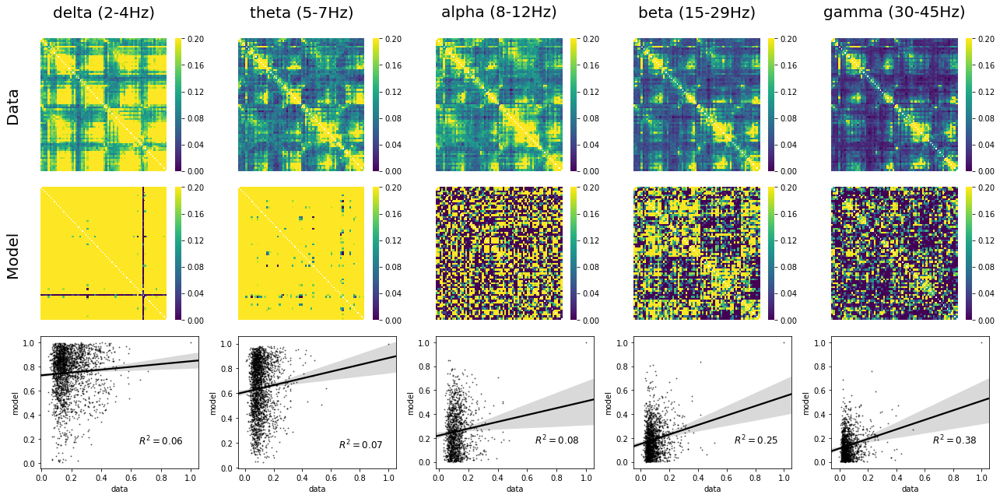

In [686]:
make_mat_plots(res_aecs_2,vmax=0.2)

complex64
Converting time column to int64...
CPU times: user 8min 31s, sys: 7min 17s, total: 15min 48s
Wall time: 4min 56s


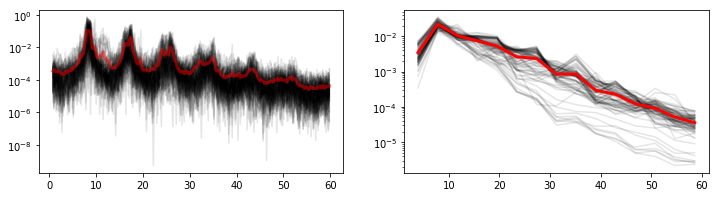

In [687]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=0.5, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 10., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res3 = run_net_sim(**ssX_params)

res_aecs_3 =  aec(res3[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res3[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res3[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res3[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res3[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

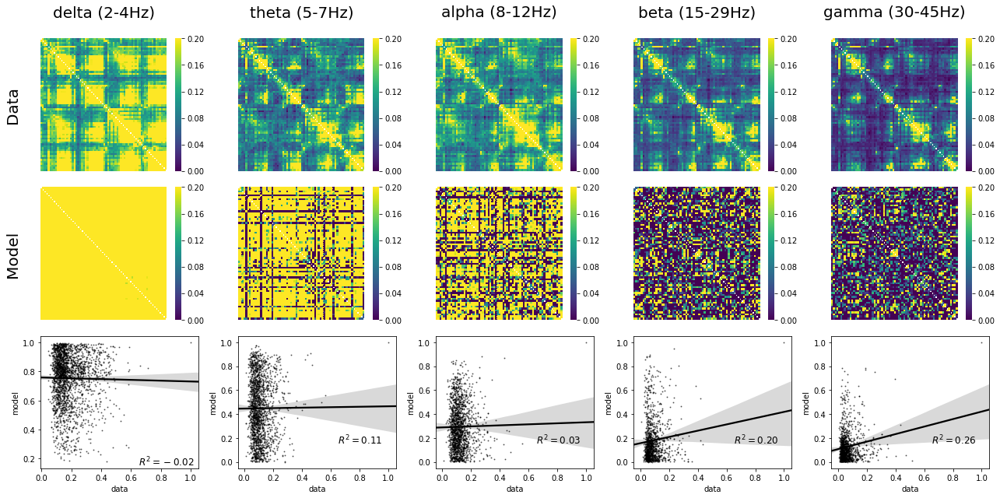

In [688]:
make_mat_plots(res_aecs_3,vmax=0.2)

complex64
Converting time column to int64...
CPU times: user 8min 58s, sys: 4min 51s, total: 13min 50s
Wall time: 5min 35s


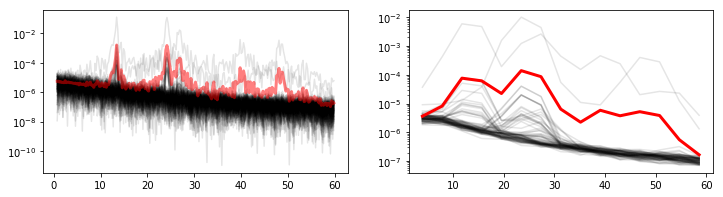

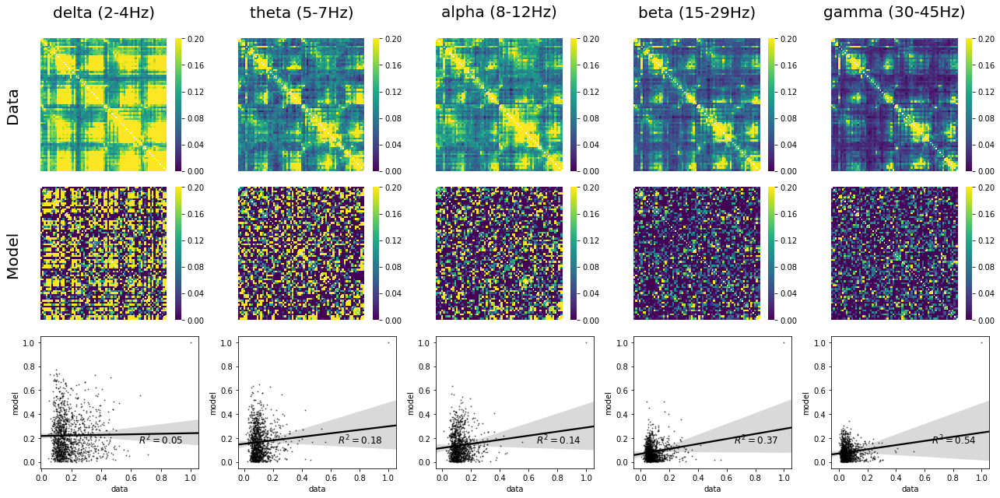

In [689]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=1.5, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 10., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res4 = run_net_sim(**ssX_params)

res_aecs_4 =  aec(res4[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res4[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res4[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res4[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res4[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)


make_mat_plots(res_aecs_4,vmax=0.2)

complex64
Converting time column to int64...
CPU times: user 8min 47s, sys: 6min 38s, total: 15min 25s
Wall time: 5min 15s


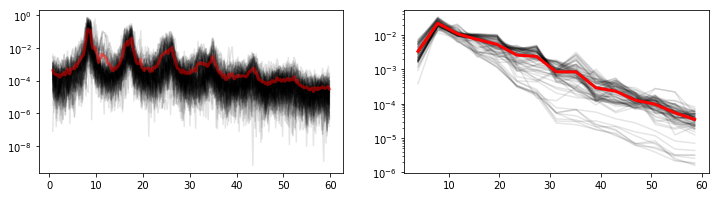

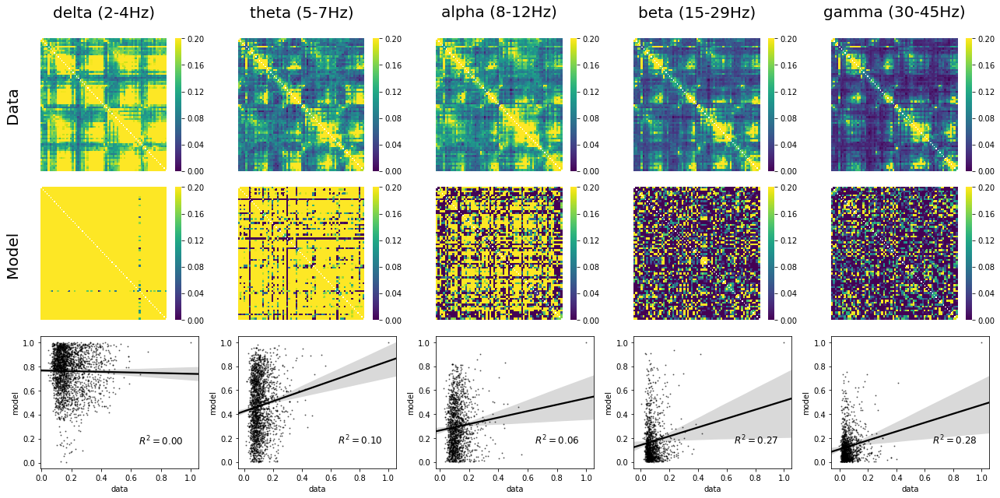

In [691]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=0.5, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 10., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res = run_net_sim(**ssX_params)

res_aecs =  aec(res[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)


make_mat_plots(res_aecs,vmax=0.2)

In [1]:
%%time

# this should give clean isolated gamma rhythms
ssX_params = dict(I_o=0.5, # 10.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T = 1024*20,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 10., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res = run_net_sim(**ssX_params)

res_aecs =  aec(res[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)


make_mat_plots(res_aecs,vmax=0.2)

NameError: name '_df_w' is not defined

complex64
Converting time column to int64...
CPU times: user 21min 45s, sys: 10min 28s, total: 32min 14s
Wall time: 10min 1s


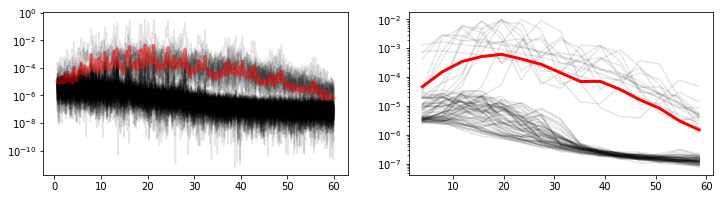

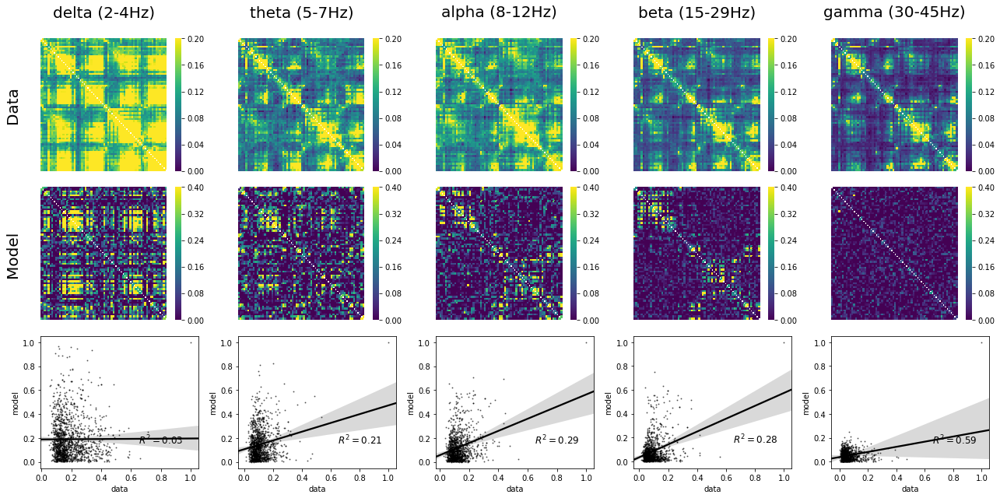

In [16]:
%%time

# good FC from high I_o and gamma rhythms

ssX_params = dict(I_o=1.5,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .0001,D_i= .0001,D_th = 0.0001,D_rtn = 0.0001,
            T=1024*10,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.5, a_i = 0.5, a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res_Io_1p5 = run_net_sim(**ssX_params)

res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_Io_1p5_aecs)

complex64
Converting time column to int64...
CPU times: user 5min 1s, sys: 3min 14s, total: 8min 16s
Wall time: 2min 38s
Parser   : 248 ms


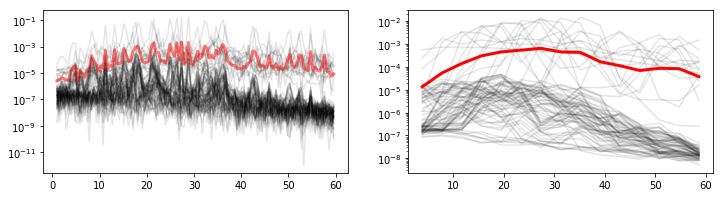

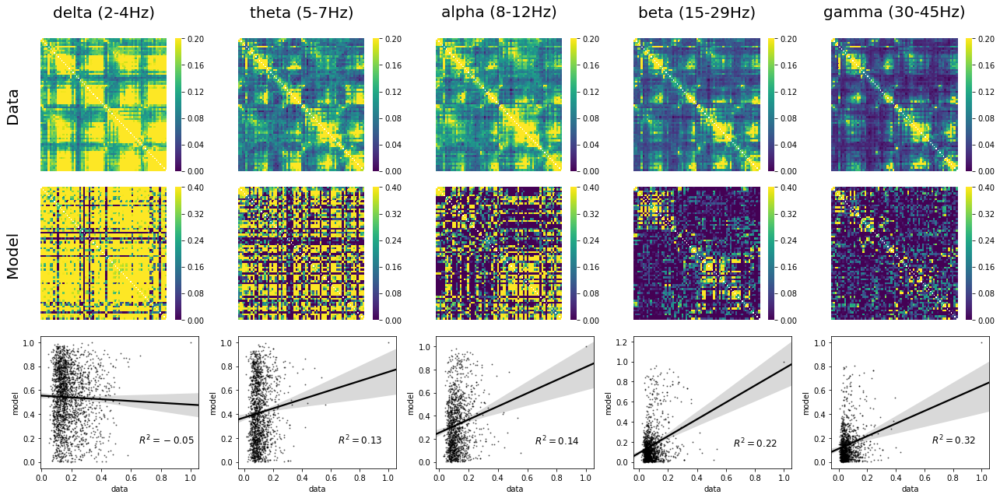

In [19]:
%%time

# good FC from high I_o and gamma rhythms

ssX_params = dict(I_o=1.5,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00001,D_i= .00001,D_th = 0.00001,D_rtn = 0.00001,
            T=1024*2,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.8, a_i = 0.7, 
            a_th=0.35, a_rtn=0.35, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res_Io_1p5 = run_net_sim(**ssX_params)

res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_Io_1p5_aecs)

complex64
Converting time column to int64...
CPU times: user 5min, sys: 2min 44s, total: 7min 44s
Wall time: 2min 39s


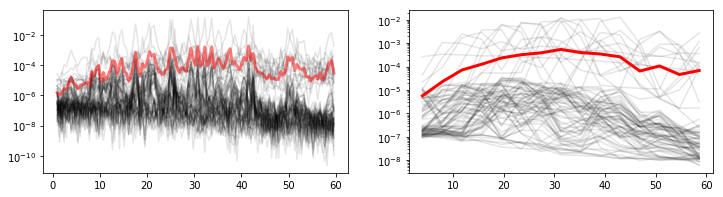

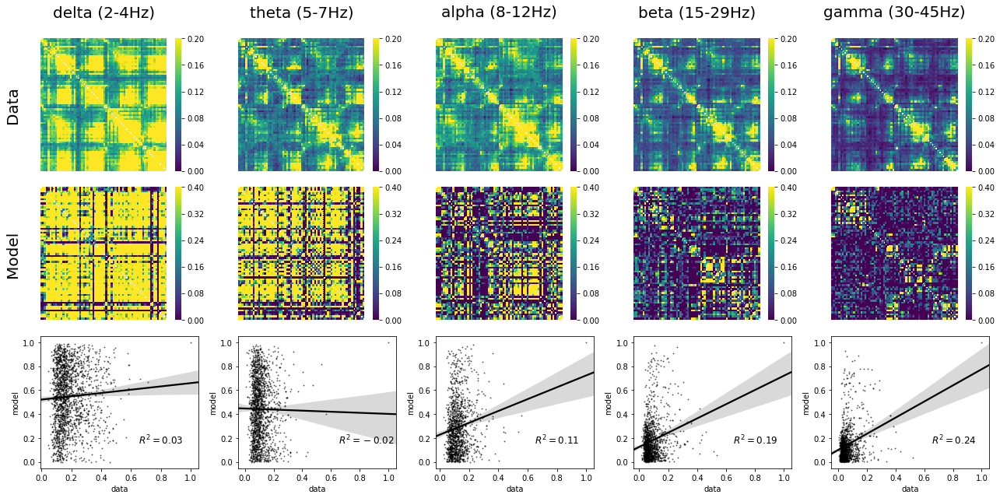

In [20]:
%%time

# good FC from high I_o and gamma rhythms

ssX_params = dict(I_o=1.5,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00001,D_i= .00001,D_th = 0.00001,D_rtn = 0.00001,
            T=1024*2,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.9, a_i = 0.9, 
            a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res_Io_1p5 = run_net_sim(**ssX_params)

res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_Io_1p5_aecs)

complex64
Converting time column to int64...
CPU times: user 21min 4s, sys: 11min 21s, total: 32min 26s
Wall time: 10min 4s


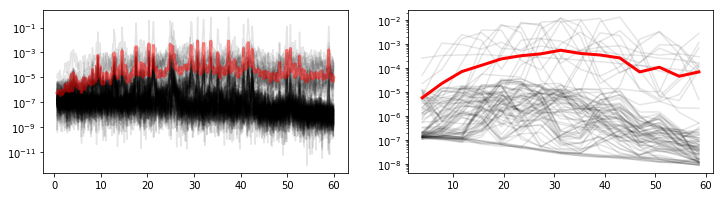

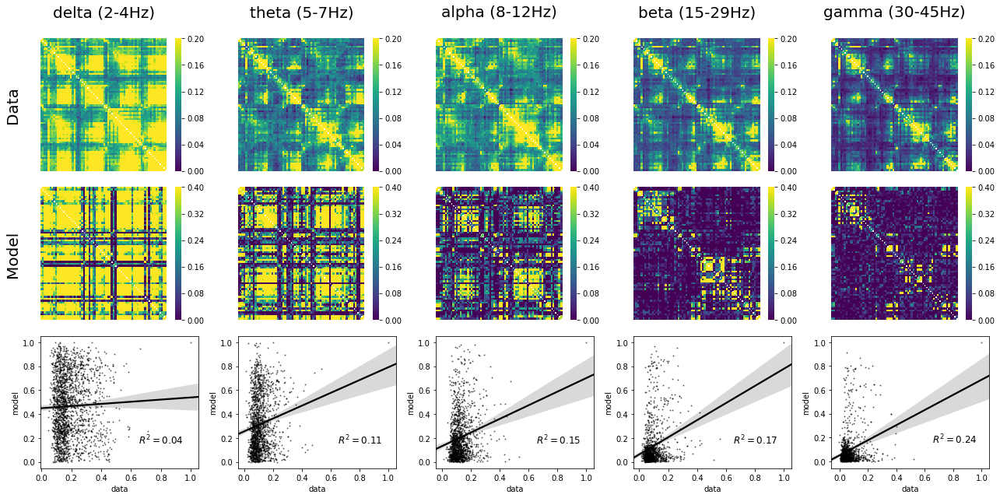

In [23]:
%%time

# good FC from high I_o and gamma rhythms

ssX_params = dict(I_o=1.5,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00001,D_i= .00001,D_th = 0.00001,D_rtn = 0.00001,
            T=1024*10,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.9, a_i = 0.9, 
            a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res_Io_1p5 = run_net_sim(**ssX_params)

res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_Io_1p5_aecs)

complex64
Converting time column to int64...
CPU times: user 5min 15s, sys: 3min 20s, total: 8min 36s
Wall time: 2min 56s


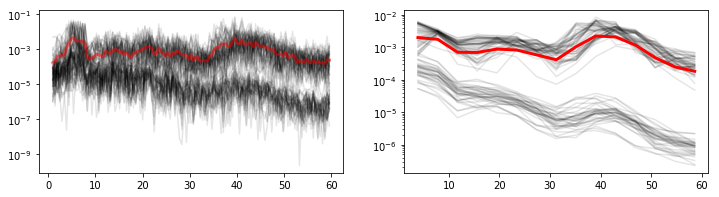

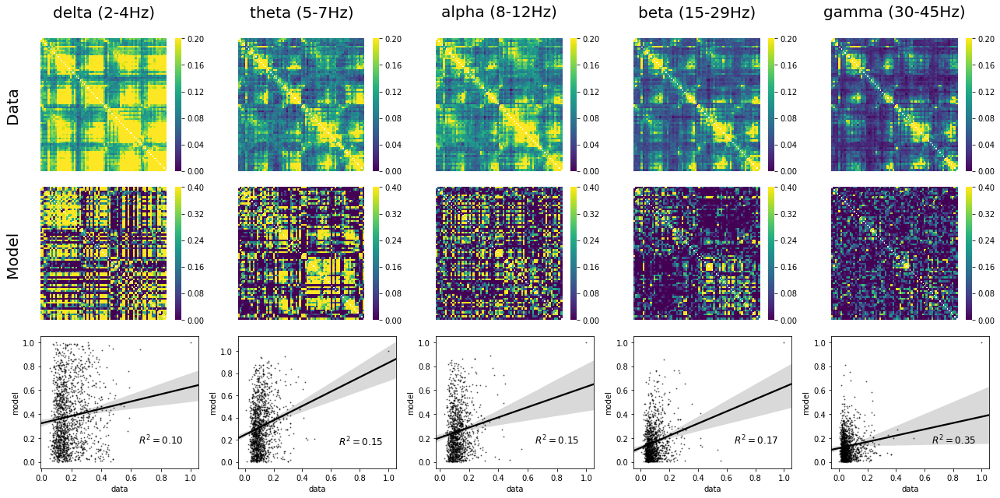

In [22]:
%%time

# good FC from high I_o and gamma rhythms

ssX_params = dict(I_o=1.0,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00001,D_i= .00001,D_th = 0.00001,D_rtn = 0.00001,
            T=1024*2,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.9, a_i = 0.9, 
            a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res_Io_1p5 = run_net_sim(**ssX_params)

res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_Io_1p5_aecs)

complex64
Converting time column to int64...
CPU times: user 5min 4s, sys: 3min 4s, total: 8min 8s
Wall time: 2min 47s


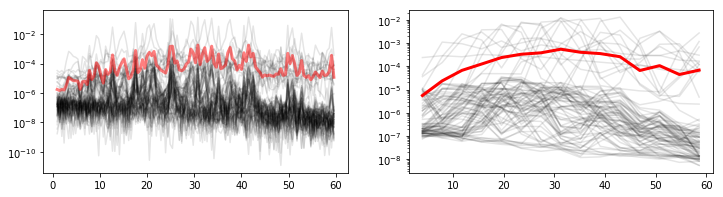

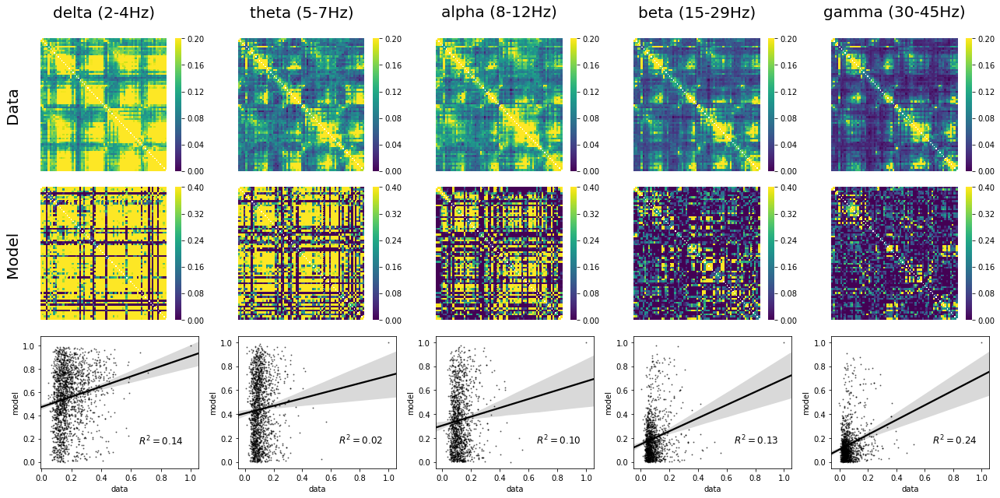

In [24]:
%%time

# good FC from high I_o and gamma rhythms

ssX_params = dict(I_o=1.5,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00001,D_i= .00001,D_th = 0.00001,D_rtn = 0.00001,
            T=1024*2,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.9, a_i = 0.9, 
            a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res_Io_1p5 = run_net_sim(**ssX_params)

res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_Io_1p5_aecs)

complex64
Converting time column to int64...
CPU times: user 21min 1s, sys: 10min 22s, total: 31min 24s
Wall time: 9min 47s
Parser   : 156 ms


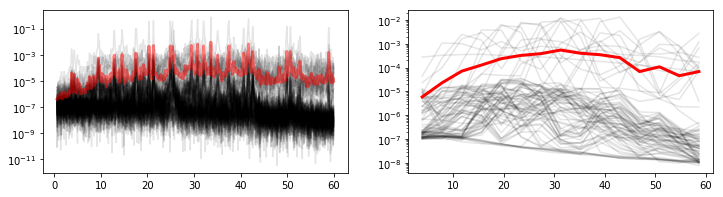

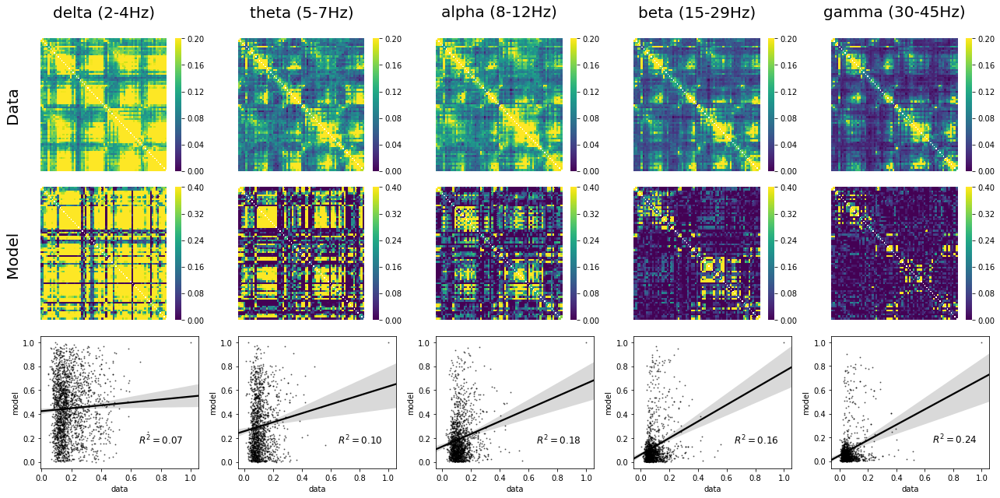

In [25]:
%%time

# good FC from high I_o and gamma rhythms

ssX_params = dict(I_o=1.5,
                  wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00001,D_i= .00001,D_th = 0.00001,D_rtn = 0.00001,
            T=1024*10,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.9, a_i = 0.9, 
            a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res_Io_1p5 = run_net_sim(**ssX_params)

res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_Io_1p5_aecs)

complex64
Converting time column to int64...
CPU times: user 21min 34s, sys: 10min 40s, total: 32min 14s
Wall time: 10min 1s


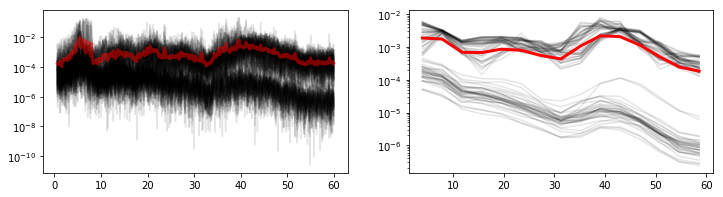

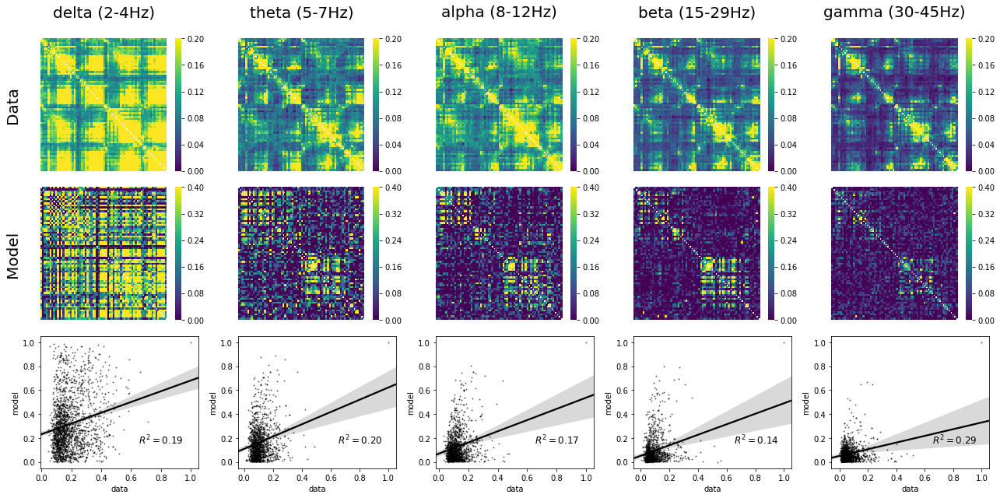

In [27]:
%%time

# good FC from high I_o and gamma rhythms

ssX_params = dict(I_o=1.0,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00001,D_i= .00001,D_th = 0.00001,D_rtn = 0.00001,
            T=1024*10,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.9, a_i = 0.9, 
            a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res_Io_1p5 = run_net_sim(**ssX_params)

res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_Io_1p5_aecs)

complex64
Converting time column to int64...
CPU times: user 21min 19s, sys: 11min 11s, total: 32min 30s
Wall time: 10min 3s


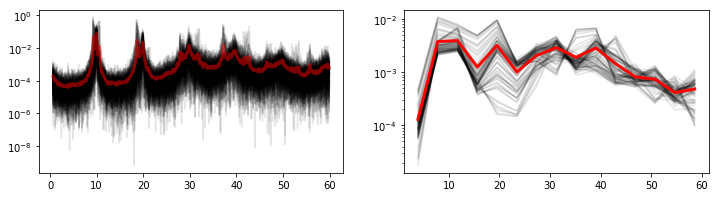

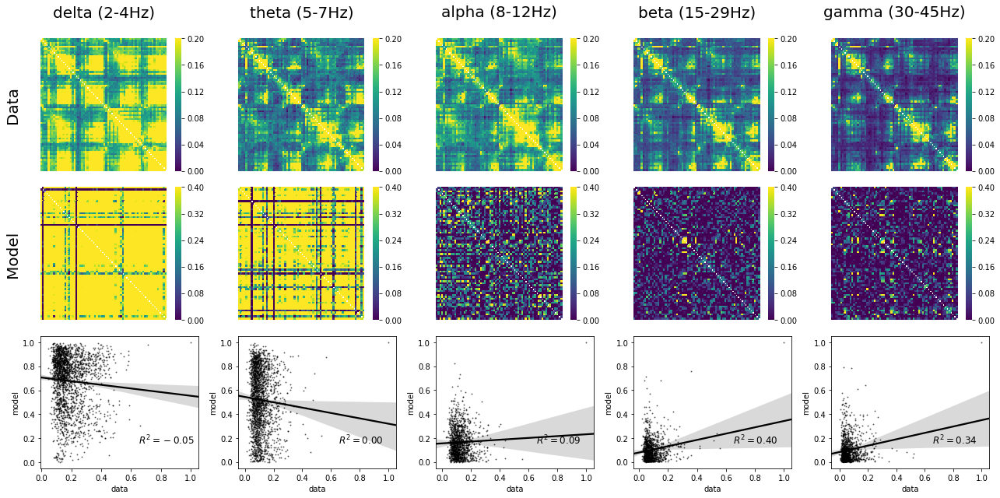

In [28]:
%%time

# good FC from high I_o and gamma rhythms

ssX_params = dict(I_o=0.5,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00001,D_i= .00001,D_th = 0.00001,D_rtn = 0.00001,
            T=1024*10,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.9, a_i = 0.9, 
            a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res_Io_1p5 = run_net_sim(**ssX_params)

res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_Io_1p5_aecs)

complex64
Converting time column to int64...
CPU times: user 21min 24s, sys: 10min 16s, total: 31min 41s
Wall time: 9min 46s


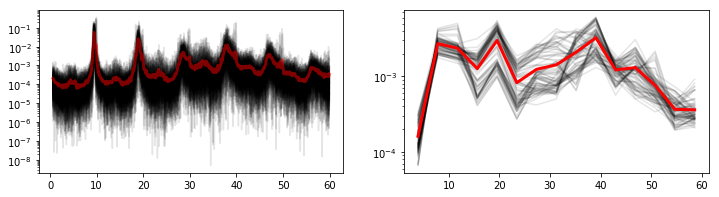

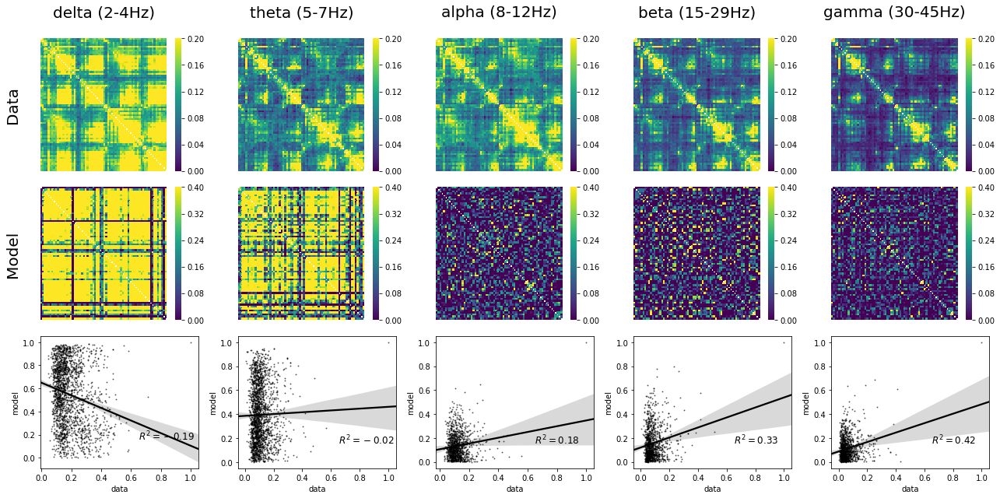

In [29]:
%%time

# good FC from high I_o and gamma rhythms

ssX_params = dict(I_o=0.,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00001,D_i= .00001,D_th = 0.00001,D_rtn = 0.00001,
            T=1024*10,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.9, a_i = 0.9, 
            a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res_Io_1p5 = run_net_sim(**ssX_params)

res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_Io_1p5_aecs)

complex64
Converting time column to int64...
CPU times: user 5min 9s, sys: 5min 1s, total: 10min 10s
Wall time: 3min 1s


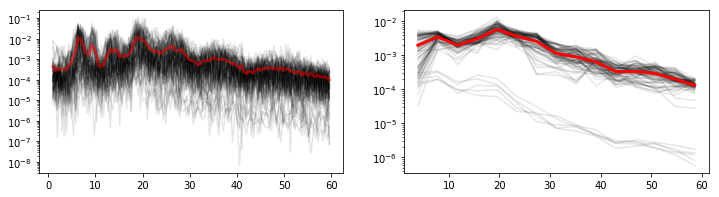

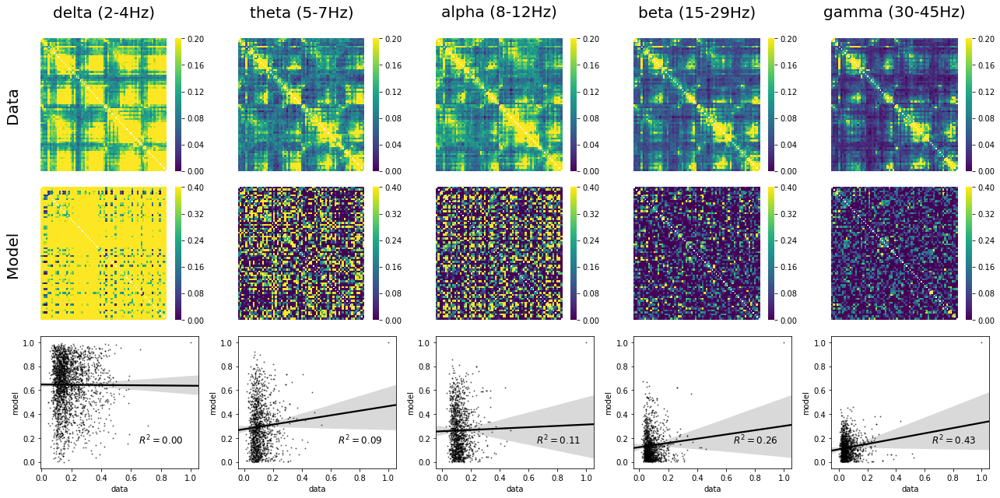

In [26]:
%%time

# good FC from high I_o and gamma rhythms

ssX_params = dict(I_o=1.0,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00001,D_i= .00001,D_th = 0.00001,D_rtn = 0.00001,
            T=1024*2,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.6, a_i = 0.7, 
            a_th=0.45, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res_Io_1p5 = run_net_sim(**ssX_params)

res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_Io_1p5_aecs)

In [ ]:
%%time

# good FC from high I_o and gamma rhythms

ssX_params = dict(I_o=1.5,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00001,D_i= .00001,D_th = 0.00001,D_rtn = 0.00001,
            T=1024*2,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.9, a_i = 0.9, 
            a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


res_Io_1p5 = run_net_sim(**ssX_params)

res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)

make_mat_plots(res_Io_1p5_aecs)

---


---


---

In [31]:
from copy import deepcopy

In [68]:
%%time

# good FC from high I_o and gamma rhythms

T = 1024*4

ssX_params = dict(I_o=None,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00001,D_i= .00001,D_th = 0.00001,D_rtn = 0.00001,
            T=T,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 7.5, # 10., # 1., #-0.9,
            a_e = 0.6, a_i = 0.6, 
            a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 0.
res_Io_0 = run_net_sim(**theseparams)
res_Io_0_aecs =  aec(res_Io_0[0]['e'].values.T.copy(),sfreq,freq_bands)

theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 0.5
res_Io_0p5 = run_net_sim(**theseparams)
res_Io_0p5_aecs =  aec(res_Io_0p5[0]['e'].values.T.copy(),sfreq,freq_bands)

theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 1.0
res_Io_1p0 = run_net_sim(**theseparams)
res_Io_1p0_aecs =  aec(res_Io_1p0[0]['e'].values.T.copy(),sfreq,freq_bands)

theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 1.5
res_Io_1p5 = run_net_sim(**theseparams)
res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


deltamat_Io_0 = res_Io_0_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_0 = res_Io_0_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_0 = res_Io_0_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_0 = res_Io_0_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_0 = res_Io_0_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_0p5 = res_Io_0p5_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_0p5 = res_Io_0p5_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_0p5 = res_Io_0p5_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_0p5 = res_Io_0p5_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_0p5 = res_Io_0p5_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_1p0 = res_Io_1p0_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_1p0 = res_Io_1p0_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_1p0 = res_Io_1p0_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_1p0 = res_Io_1p0_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_1p0 = res_Io_1p0_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_1p5 = res_Io_1p5_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_1p5 = res_Io_1p5_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_1p5 = res_Io_1p5_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_1p5 = res_Io_1p5_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_1p5 = res_Io_1p5_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]




deltamat_meg = aec_mean['delta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
thetamat_meg = aec_mean['theta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
alphamat_meg = aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
betamat_meg = aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
gammamat_meg = aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()


complex64
Converting time column to int64...
CPU times: user 36min 37s, sys: 23min 16s, total: 59min 54s
Wall time: 17min 59s


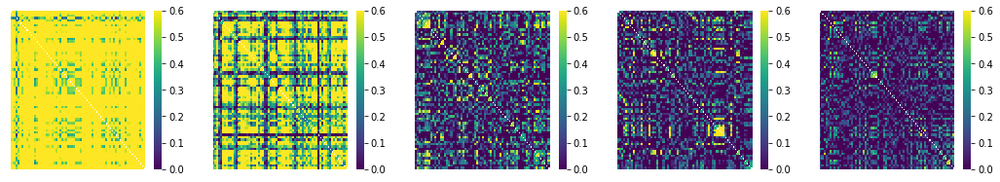

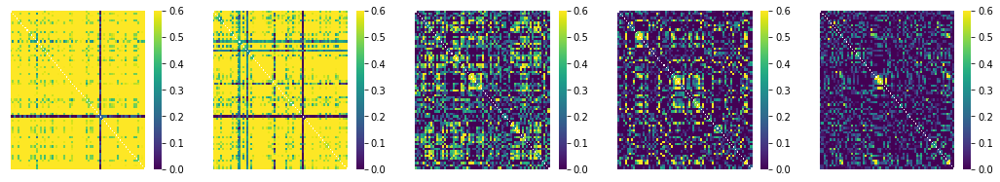

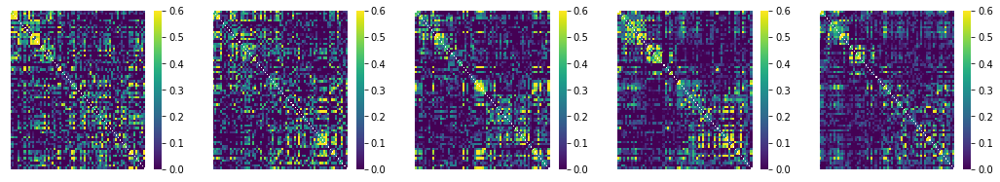

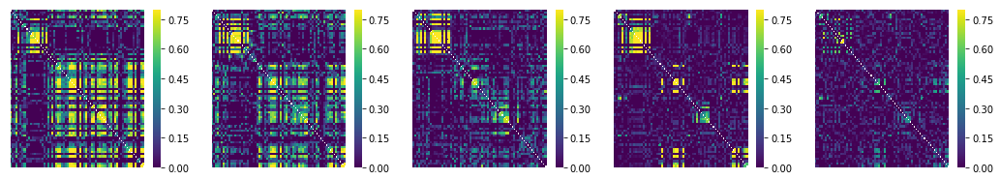

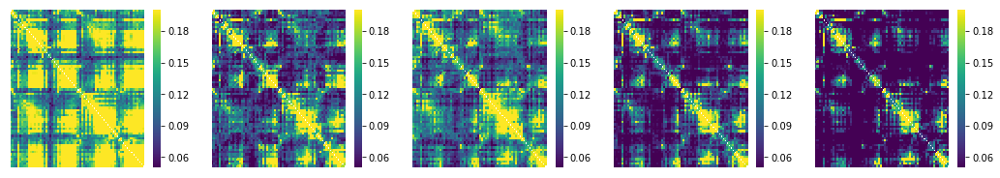

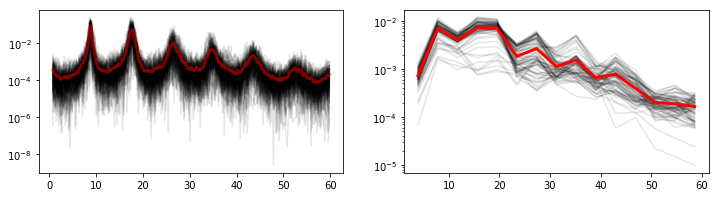

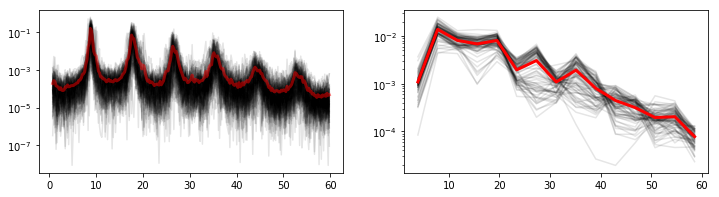

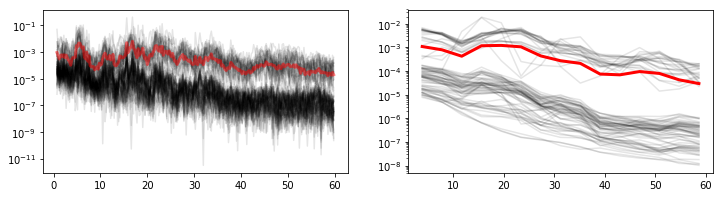

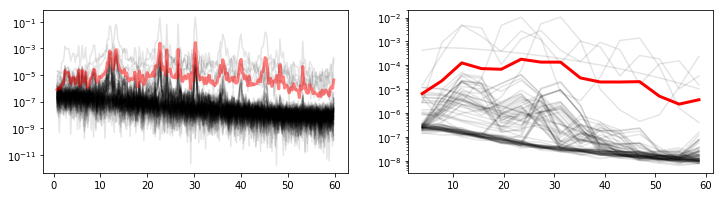

In [69]:




fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')



fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')



fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')


fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')





fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')










fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_0[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_0[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)




fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_0p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_0p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_0p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_0p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)



fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p0[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p0[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)



fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)




In [70]:
%%time

# good FC from high I_o and gamma rhythms

T = 1024*20

ssX_params = dict(I_o=None,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00001,D_i= .00001,D_th = 0.00001,D_rtn = 0.00001,
            T=T,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 7.5, # 10., # 1., #-0.9,
            a_e = 0.9, a_i = 0.9, 
            a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 0.
res_Io_0 = run_net_sim(**theseparams)
res_Io_0_aecs =  aec(res_Io_0[0]['e'].values.T.copy(),sfreq,freq_bands)

theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 0.5
res_Io_0p5 = run_net_sim(**theseparams)
res_Io_0p5_aecs =  aec(res_Io_0p5[0]['e'].values.T.copy(),sfreq,freq_bands)

theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 1.0
res_Io_1p0 = run_net_sim(**theseparams)
res_Io_1p0_aecs =  aec(res_Io_1p0[0]['e'].values.T.copy(),sfreq,freq_bands)

theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 1.5
res_Io_1p5 = run_net_sim(**theseparams)
res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


deltamat_Io_0 = res_Io_0_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_0 = res_Io_0_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_0 = res_Io_0_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_0 = res_Io_0_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_0 = res_Io_0_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_0p5 = res_Io_0p5_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_0p5 = res_Io_0p5_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_0p5 = res_Io_0p5_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_0p5 = res_Io_0p5_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_0p5 = res_Io_0p5_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_1p0 = res_Io_1p0_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_1p0 = res_Io_1p0_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_1p0 = res_Io_1p0_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_1p0 = res_Io_1p0_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_1p0 = res_Io_1p0_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_1p5 = res_Io_1p5_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_1p5 = res_Io_1p5_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_1p5 = res_Io_1p5_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_1p5 = res_Io_1p5_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_1p5 = res_Io_1p5_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]




deltamat_meg = aec_mean['delta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
thetamat_meg = aec_mean['theta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
alphamat_meg = aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
betamat_meg = aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
gammamat_meg = aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()


complex64
Converting time column to int64...
CPU times: user 2h 45min 49s, sys: 1h 37min 3s, total: 4h 22min 53s
Wall time: 1h 17min 16s


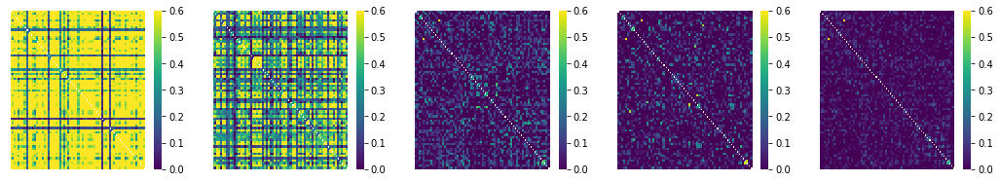

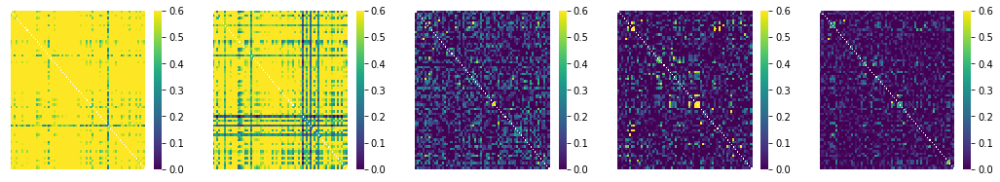

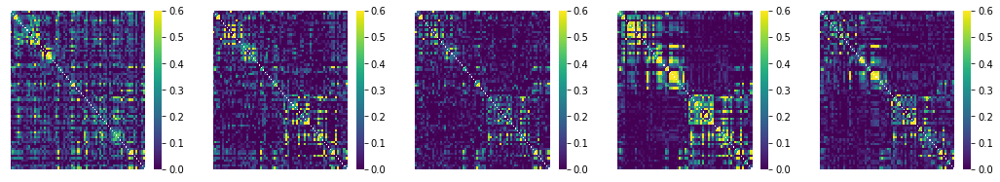

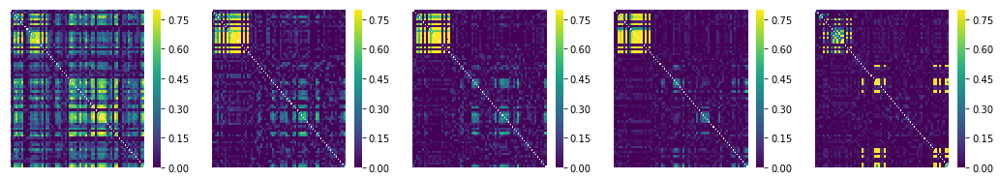

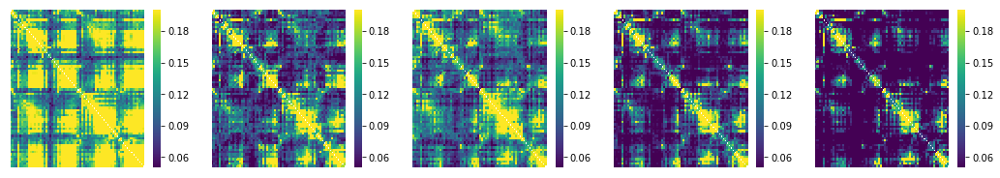

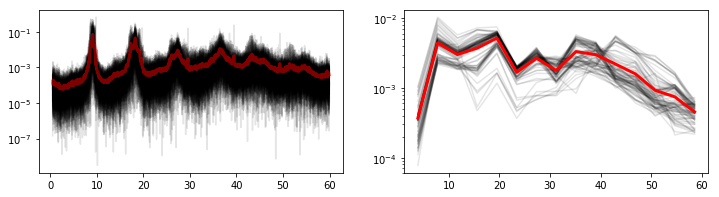

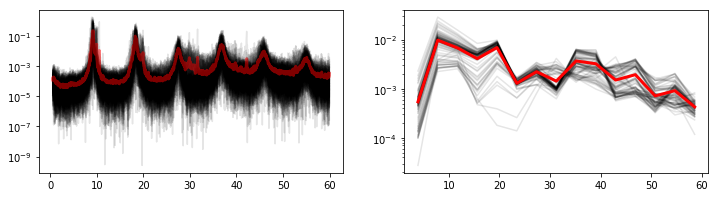

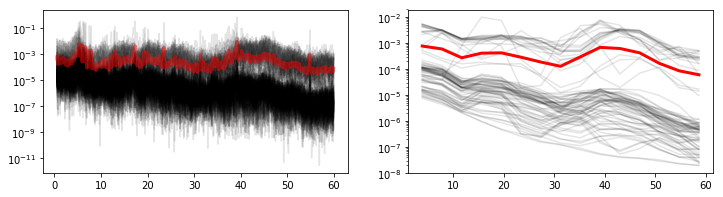

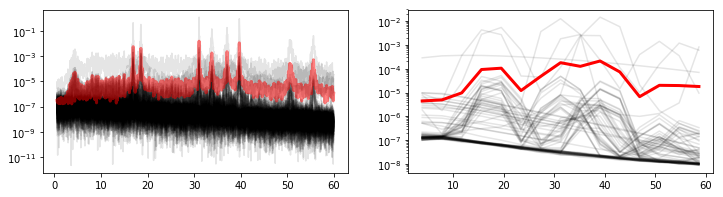

In [71]:




fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')



fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')



fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')


fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')





fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')










fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_0[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_0[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)




fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_0p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_0p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_0p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_0p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)



fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p0[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p0[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)



fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)




In [72]:
%%time

# good FC from high I_o and gamma rhythms

T = 1024*20

ssX_params = dict(I_o=None,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00001,D_i= .00001,D_th = 0.00001,D_rtn = 0.00001,
            T=T,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.9, a_i = 0.9, 
            a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 0.
res_Io_0 = run_net_sim(**theseparams)
res_Io_0_aecs =  aec(res_Io_0[0]['e'].values.T.copy(),sfreq,freq_bands)

theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 0.5
res_Io_0p5 = run_net_sim(**theseparams)
res_Io_0p5_aecs =  aec(res_Io_0p5[0]['e'].values.T.copy(),sfreq,freq_bands)

theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 1.0
res_Io_1p0 = run_net_sim(**theseparams)
res_Io_1p0_aecs =  aec(res_Io_1p0[0]['e'].values.T.copy(),sfreq,freq_bands)

theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 1.5
res_Io_1p5 = run_net_sim(**theseparams)
res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


deltamat_Io_0 = res_Io_0_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_0 = res_Io_0_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_0 = res_Io_0_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_0 = res_Io_0_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_0 = res_Io_0_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_0p5 = res_Io_0p5_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_0p5 = res_Io_0p5_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_0p5 = res_Io_0p5_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_0p5 = res_Io_0p5_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_0p5 = res_Io_0p5_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_1p0 = res_Io_1p0_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_1p0 = res_Io_1p0_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_1p0 = res_Io_1p0_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_1p0 = res_Io_1p0_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_1p0 = res_Io_1p0_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_1p5 = res_Io_1p5_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_1p5 = res_Io_1p5_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_1p5 = res_Io_1p5_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_1p5 = res_Io_1p5_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_1p5 = res_Io_1p5_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]




deltamat_meg = aec_mean['delta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
thetamat_meg = aec_mean['theta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
alphamat_meg = aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
betamat_meg = aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
gammamat_meg = aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()


complex64
Converting time column to int64...
CPU times: user 2h 44min 54s, sys: 1h 58min 40s, total: 4h 43min 34s
Wall time: 1h 20min 45s


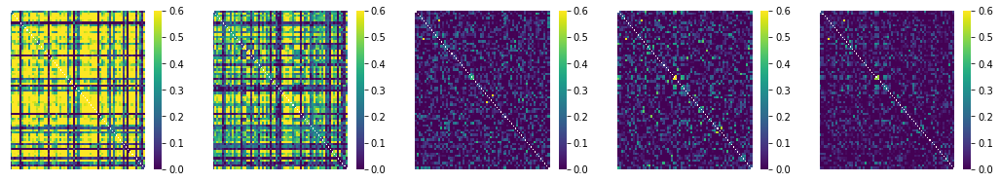

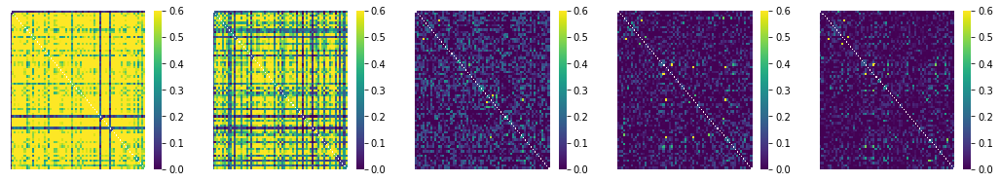

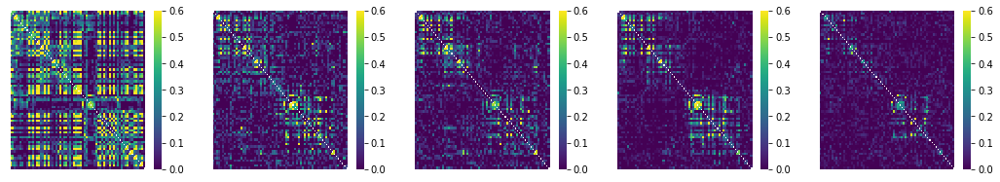

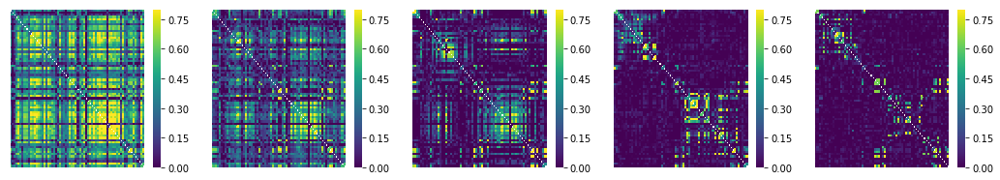

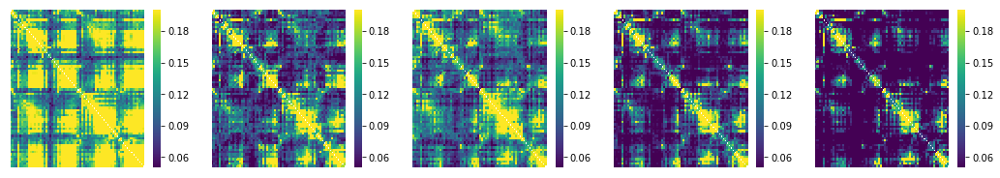

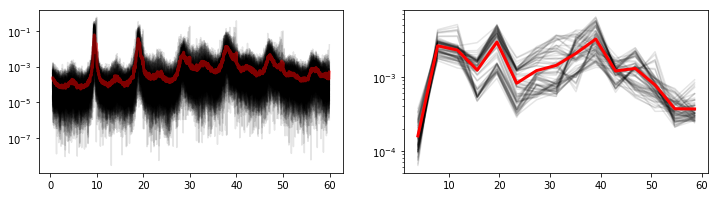

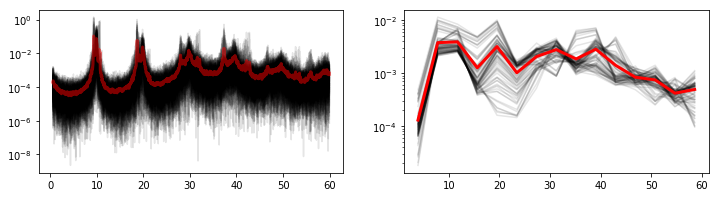

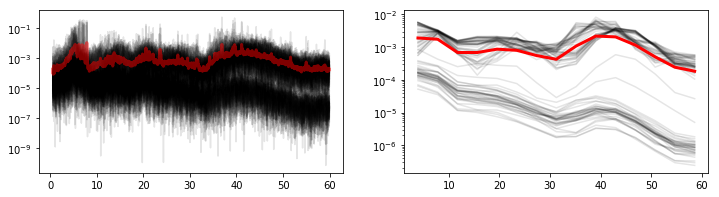

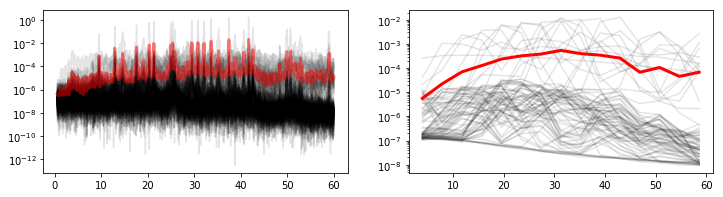

In [73]:




fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')



fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')



fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')


fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')





fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')










fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_0[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_0[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)




fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_0p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_0p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_0p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_0p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)



fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p0[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p0[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)



fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)




---


---


---

In [74]:
%%time

# good FC from high I_o and gamma rhythms

T = 1024*20

ssX_params = dict(I_o=None,
             wee = 1.4,wei = 1.4,wie = -3., wii = -0.5, # wie = -2.,wii = -0.5,
            wertn = 0.6,weth = .6,wthi = 0.2,wthe = 1.65,wrtnth = -2.,wthrtn = 2.,
            D_e = .00001,D_i= .00001,D_th = 0.00001,D_rtn = 0.00001,
            T=T,#T = 1024*4,# 20,
            P=1,Q = 1,Dt = 0.001,
            dt = 0.1,gain = 20.,threshold = 0.,Pi = 3.14159,
            g = 5., # 10., # 1., #-0.9,
            a_e = 0.9, a_i = 0.9, 
            a_th=0.25, a_rtn=0.25, # a_e = 0.3,a_i = 0.5,a_th = 0.2,a_rtn = 0.2,
            i_e = -0.35,i_i = -0.3,i_th = 0.5,i_rtn = -0.8,
            tau1  = 20.,tau2 = 5.,T_transient=1000,
            stim_freq=35.,stim_amp=0.,stim_type='sinewave',stim_pops=['e'],
            weights=_df_w.values,delays=_df_d.values,K=83,
             return_ts=True,compute_connectivity=True)#False)


theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 0.
res_Io_0 = run_net_sim(**theseparams)
res_Io_0_aecs =  aec(res_Io_0[0]['e'].values.T.copy(),sfreq,freq_bands)

theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 0.5
res_Io_0p5 = run_net_sim(**theseparams)
res_Io_0p5_aecs =  aec(res_Io_0p5[0]['e'].values.T.copy(),sfreq,freq_bands)

theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 1.0
res_Io_1p0 = run_net_sim(**theseparams)
res_Io_1p0_aecs =  aec(res_Io_1p0[0]['e'].values.T.copy(),sfreq,freq_bands)

theseparams = deepcopy(ssX_params)
theseparams['I_o'] = 1.5
res_Io_1p5 = run_net_sim(**theseparams)
res_Io_1p5_aecs =  aec(res_Io_1p5[0]['e'].values.T.copy(),sfreq,freq_bands)


deltamat_Io_0 = res_Io_0_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_0 = res_Io_0_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_0 = res_Io_0_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_0 = res_Io_0_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_0 = res_Io_0_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_0p5 = res_Io_0p5_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_0p5 = res_Io_0p5_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_0p5 = res_Io_0p5_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_0p5 = res_Io_0p5_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_0p5 = res_Io_0p5_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_1p0 = res_Io_1p0_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_1p0 = res_Io_1p0_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_1p0 = res_Io_1p0_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_1p0 = res_Io_1p0_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_1p0 = res_Io_1p0_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]

deltamat_Io_1p5 = res_Io_1p5_aecs[0]['delta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
thetamat_Io_1p5 = res_Io_1p5_aecs[0]['theta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
alphamat_Io_1p5 = res_Io_1p5_aecs[0]['alpha']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
betamat_Io_1p5 = res_Io_1p5_aecs[0]['beta']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]
gammamat_Io_1p5 = res_Io_1p5_aecs[0]['gamma']['aec'].values[l2k8_to_abey_idx,:][:,l2k8_to_abey_idx]




deltamat_meg = aec_mean['delta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
thetamat_meg = aec_mean['theta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
alphamat_meg = aec_mean['alpha'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
betamat_meg = aec_mean['beta'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()
gammamat_meg = aec_mean['gamma'][orig_to_abey_idx,:][:,orig_to_abey_idx].copy()


complex64
Converting time column to int64...
CPU times: user 2h 47min, sys: 1h 36min 54s, total: 4h 23min 55s
Wall time: 1h 17min 38s


In [75]:
final_mats = {}
for freq in freqs:
    for io in ['0', '0p5', '1p0', '1p5']:
        matname = '%smat_Io_%s' %(freq,io)
        exec 'final_mats[matname] = eval(matname).copy()'

    matname = '%smat_meg' %(freq)
    exec 'final_mats[matname] = eval(matname).copy()'
final_mats

{'alphamat_Io_0': array([[ 1.        ,  0.13201142, -0.02806112, ...,  0.02619645,
          0.18564772,  0.0453234 ],
        [ 0.13201142,  1.        ,  0.10697187, ..., -0.00133194,
         -0.21569955,  0.06316952],
        [-0.02806112,  0.10697187,  1.        , ...,  0.07433624,
         -0.20013144,  0.05844073],
        ...,
        [ 0.02619645, -0.00133194,  0.07433624, ...,  1.        ,
          0.04075973,  0.28407246],
        [ 0.18564772, -0.21569955, -0.20013144, ...,  0.04075973,
          1.        , -0.12919191],
        [ 0.0453234 ,  0.06316952,  0.05844073, ...,  0.28407246,
         -0.12919191,  1.        ]]),
 'alphamat_Io_0p5': array([[ 1.        ,  0.11731557,  0.0964874 , ..., -0.13811271,
         -0.03578321,  0.10275789],
        [ 0.11731557,  1.        ,  0.08145285, ...,  0.02328171,
         -0.01730128, -0.12706672],
        [ 0.0964874 ,  0.08145285,  1.        , ..., -0.04694689,
          0.09476491, -0.02164928],
        ...,
        [-0.138112

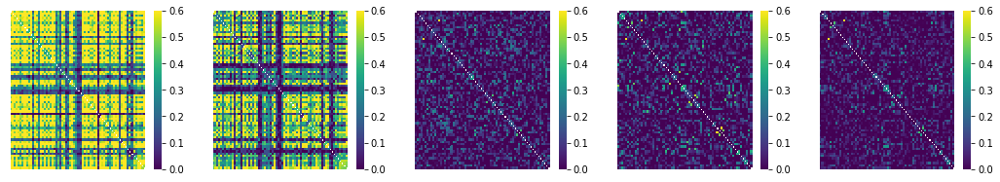

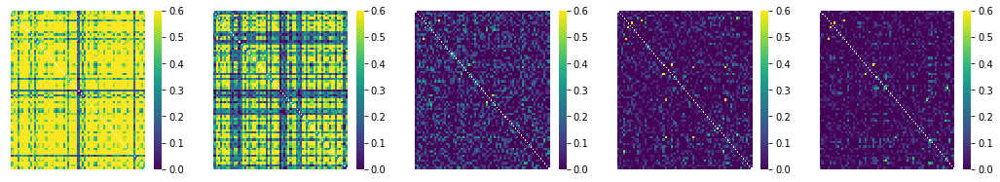

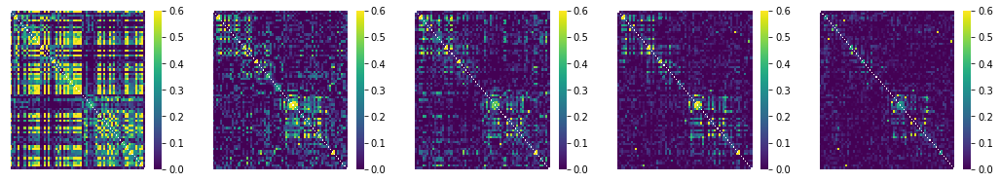

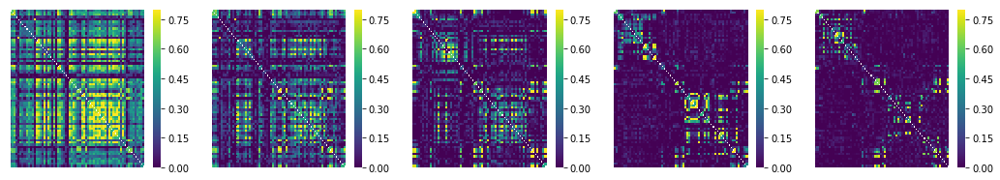

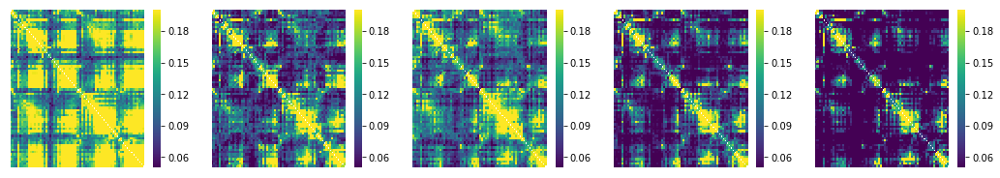

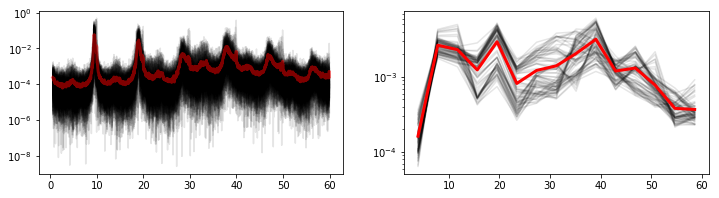

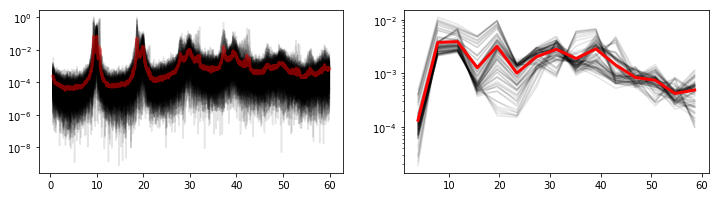

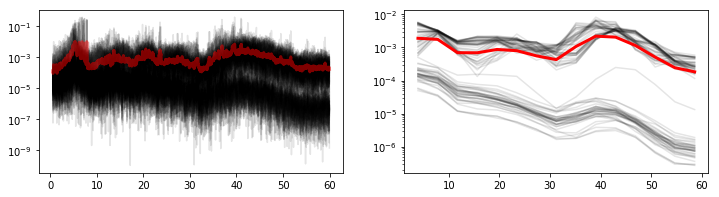

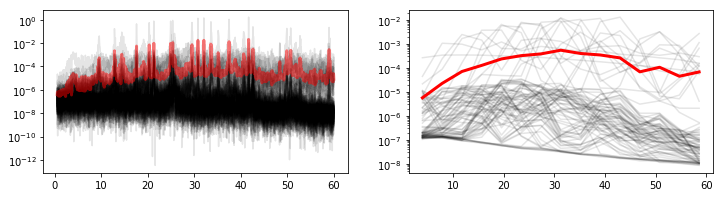

In [64]:




fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')



fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_0p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')



fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_1p0,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.6,ax=a,xticklabels='',yticklabels='')


fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')





fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.2,ax=a,xticklabels='',yticklabels='')










fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_0[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_0[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)




fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_0p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_0p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_0p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_0p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)



fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p0[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p0[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)



fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)




In [140]:
sns.set_style('dark')

vmin=0.05
vmax=0.4
for k in final_mats.keys():
    #k = 'gammamat_Io_1p5'
    v = final_mats[k].copy()

    fname = k + '__heatmap_vmin%s_vmax%s.png' %(vmin,vmax)

    fig, ax = plt.subplots(figsize=(6,4))
    sns.heatmap(v,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.4,ax=ax,xticklabels='',yticklabels='')
    plt.savefig(fname,transparent=True)
    plt.close()

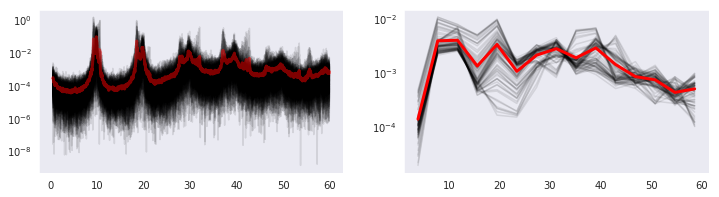

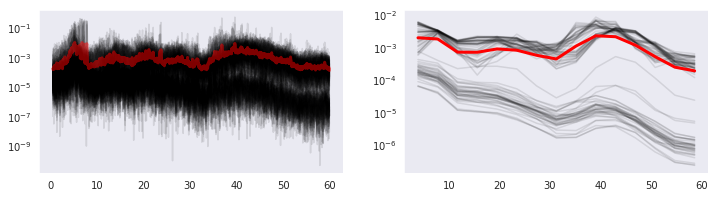

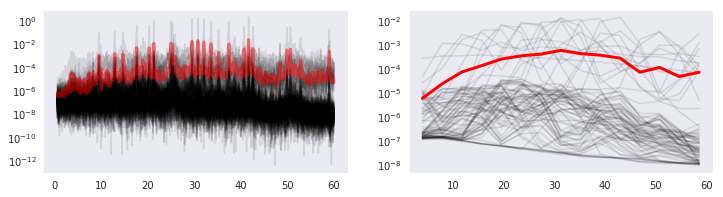

In [164]:


fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_0p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_0p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_0p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_0p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)



fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p0[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p0[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p0[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p0[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)



fig, ax = plt.subplots(ncols=2, figsize=(12,3))

res_Io_1p5[2]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[0],alpha=0.1)
res_Io_1p5[2]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[0],alpha=0.5,linewidth=3.)

res_Io_1p5[1]['e'].loc[0.5:60].plot(legend=False,logy=True,c='k',ax=ax[1],alpha=0.1)
res_Io_1p5[1]['e'].loc[0.5:60].mean(axis=1).plot(legend=False,logy=True,c='r',ax=ax[1],alpha=1.,linewidth=3.)



In [167]:
from mne.time_frequency import psd_welch,psd_multitaper

from mne.io import RawArray
from mne import create_info

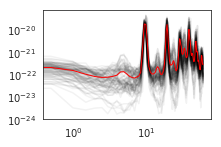

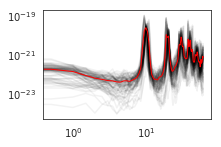

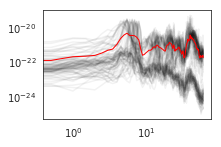

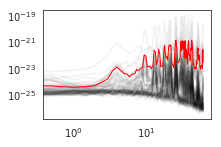

In [265]:
from mne.time_frequency import psd_welch,psd_multitaper

from mne.io import RawArray
from mne import create_info

def get_mne_psd(dat,fmin=0.,vmax=100.):
    
    #dat = df_all #     sim9a1[0]['e']
    nchan = dat.shape[1]# meg.shape[0]
    #ch_names  = ['%s_%s' %(a,b) for a,b in np.array(dat.columns)]
    ch_names = list(dat.columns.values.astype(str))
    #ch_names = list(dat.columns.values.astype(str))
    ch_types = ['mag' for _ in range(nchan)]
    raw = RawArray(dat.T.values/1e9, 
               create_info(ch_names,1e3/(dat.index[1] - dat.index[0]),ch_types),verbose=False)
    tmin = 0; tmax = raw.times[-1]
    #fmin,fmax = filt_freqs
    raw.filter(fmin,fmax)
    n_fft = min(np.diff(raw.time_as_index([tmin, tmax]))[0] + 1, 2048)
    # probably will return 2048
    psds,freqs = psd_welch(raw,n_fft=n_fft,fmin=fmin,fmax=fmax,verbose=False)
    df_wel = pd.DataFrame(psds.T,index=freqs)#blah[0].T,index=blah[1])
    #df_wel.columns = df_all.columns
    
    psds,freqs = psd_multitaper(raw,fmin=fmin,fmax=fmax,verbose=False)
    df_mt = pd.DataFrame(psds.T,index=freqs)#blah[0].T,index=blah[1])
    
    
    return df_wel,df_mt,raw

# MNE Plot
dat = res_Io_0[0]['e']
psds_Io_0 = get_mne_psd(dat)

dat = res_Io_0p5[0]['e']
psds_Io_0p5 = get_mne_psd(dat)

dat = res_Io_1p0[0]['e']
psds_Io_1p0 = get_mne_psd(dat)

dat = res_Io_1p5[0]['e']
psds_Io_1p5 = get_mne_psd(dat)

sns.set_style('white')

fname = 'res_Io_0_mnewelpsd.png'
fig, ax = plt.subplots(figsize=(3,2))
psds_Io_0[0].loc[:60].plot(legend=False,c='k', alpha=0.05,logy=True,ax=ax)
psds_Io_0[0].loc[:60].mean(axis=1).plot(legend=False,c='r',linewidth=1.,logy=True,logx=True,ax=ax)
plt.savefig(fname,transparent=True,bbox_inches='tight')
#plt.close()

fname = 'res_Io_0p5_mnewelpsd.png'
fig, ax = plt.subplots(figsize=(3,2))
psds_Io_0p5[0].loc[:60].plot(legend=False,c='k', alpha=0.05,logy=True,ax=ax)
psds_Io_0p5[0].loc[:60].mean(axis=1).plot(legend=False,c='r',linewidth=1.,logy=True,logx=True,ax=ax)
plt.savefig(fname,transparent=True,bbox_inches='tight')
#plt.close()

fname = 'res_Io_1p0_mnewelpsd.png'
fig, ax = plt.subplots(figsize=(3,2))
psds_Io_1p0[0].loc[:60].plot(legend=False,c='k', alpha=0.05,logy=True,ax=ax)
psds_Io_1p0[0].loc[:60].mean(axis=1).plot(legend=False,c='r',linewidth=1.,logy=True,logx=True,ax=ax)
plt.savefig(fname,transparent=True,bbox_inches='tight')
#plt.close()

fname = 'res_Io_1p5_mnewelpsd.png'
fig, ax = plt.subplots(figsize=(3,2))
psds_Io_1p5[0].loc[:60].plot(legend=False,c='k', alpha=0.05,logy=True,ax=ax)
psds_Io_1p5[0].loc[:60].mean(axis=1).plot(legend=False,c='r',linewidth=1.,logy=True,logx=True,ax=ax)
plt.savefig(fname,transparent=True,bbox_inches='tight')
#plt.close()

ok so final decision is: can't get good FC in alpha regime, so we stick with showing 
    
- Close up panels of best FC in gamma regime
- Full panels for all freqs of FC in gamma regime
- Example of FC changing with I_o and getting better from alpha to gamma, with power spectra
- Note somewhere (maybe only in discussion) that this is a bit of a wrinkle because the params for best fit power spectrum and best fit FC are not the same
- Indicate this is a job for future work: what is the dynamic between these two regimes. Perhaps there's a fluctuating I_o that gives both the power spectrum and the FC
- (...NOTE: can reproduce that with a stimulus to s population ?? ) 




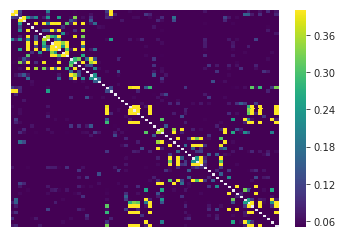

In [155]:
k = 'gammamat_Io_1p5'
v = final_mats[k].copy()

vmin=0.05
vmax=0.4

fname = k + '__heatmap_vmin%s_vmax%s.png' %(vmin,vmax)

fig, ax = plt.subplots(figsize=(6,4))
sns.heatmap(v,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.4,ax=ax,xticklabels='',yticklabels='')
plt.savefig(fname,transparent=True)

In [156]:
from IPython.display import Image

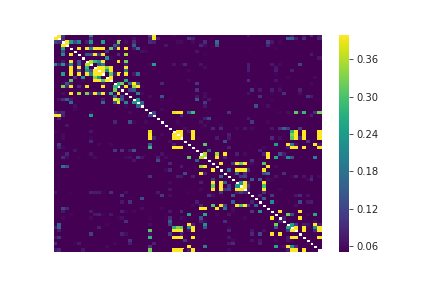

In [157]:
Image(fname)

---



---



---



---

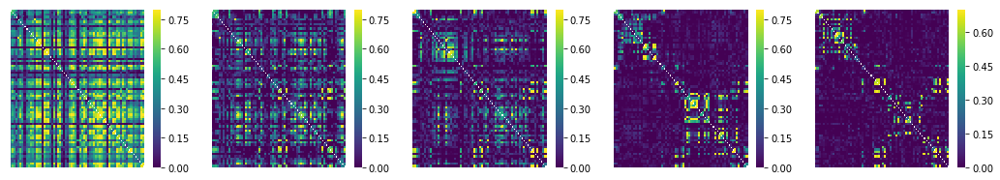

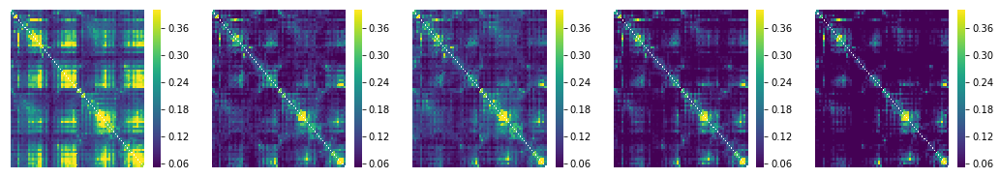

In [79]:
fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.8,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_Io_1p5,cmap='viridis',mask=np.eye(68),vmin=0.,vmax=0.7,ax=a,xticklabels='',yticklabels='')





fig, ax = plt.subplots(ncols=5, figsize=(18,3))
a = ax[0]
sns.heatmap(deltamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.4,ax=a,xticklabels='',yticklabels='')
a = ax[1]
sns.heatmap(thetamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.4,ax=a,xticklabels='',yticklabels='')
a = ax[2]
sns.heatmap(alphamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.4,ax=a,xticklabels='',yticklabels='')
a = ax[3]
sns.heatmap(betamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.4,ax=a,xticklabels='',yticklabels='')
a = ax[4]
sns.heatmap(gammamat_meg,cmap='viridis',mask=np.eye(68),vmin=0.05,vmax=0.4,ax=a,xticklabels='',yticklabels='')


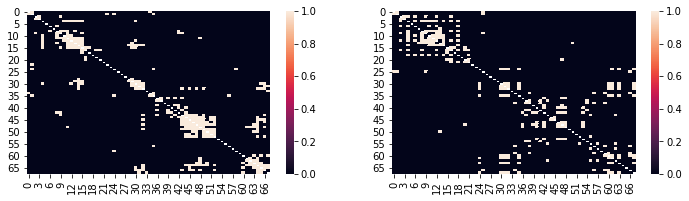

In [95]:
fig, ax = plt.subplots(ncols=2, figsize=(12,3))

sns.heatmap(np.abs(gammamat_meg)>0.15,ax=ax[0],mask=np.eye(68))
sns.heatmap(np.abs(gammamat_Io_1p5)>0.2,ax=ax[1],mask=np.eye(68))

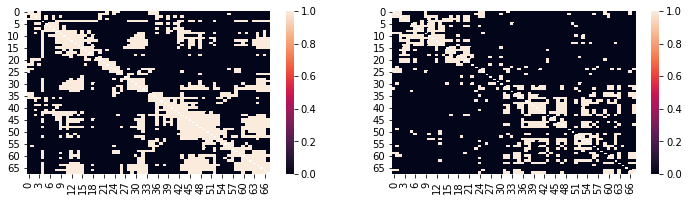

In [126]:
fig, ax = plt.subplots(ncols=2, figsize=(12,3))
sns.heatmap(np.abs(betamat_meg)>0.1,ax=ax[0],mask=np.eye(68))
sns.heatmap(np.abs(betamat_Io_1p5)>0.1,ax=ax[1],mask=np.eye(68))

In [127]:
mulmat = (np.eye(68) * -1 ) + 1

dat1 = gammamat_meg*mulmat
dat2 = gammamat_Io_1p5*mulmat

dat1_a = np.abs(dat1)
dat2_a = np.abs(dat2)

dat1_r = dat1.ravel()
dat2_r = dat2.ravel()

dat1_ar = dat1_a.ravel()
dat2_ar = dat2_a.ravel()

thr = 0.
idx = (dat1_ar>thr ) * (dat2_ar>thr)
print np.corrcoef(dat1_ar[idx],dat2_ar[idx])[0,1]

thr = 0.1
idx = (dat1_ar>thr ) * (dat2_ar>thr)
print np.corrcoef(dat1_ar[idx],dat2_ar[idx])[0,1]

0.24208829959850348
0.2592961211202308


In [128]:
mulmat = (np.eye(68) * -1 ) + 1

dat1 = betamat_meg*mulmat
dat2 = betamat_Io_1p5*mulmat

dat1_a = np.abs(dat1)
dat2_a = np.abs(dat2)

dat1_r = dat1.ravel()
dat2_r = dat2.ravel()

dat1_ar = dat1_a.ravel()
dat2_ar = dat2_a.ravel()

thr = 0.
idx = (dat1_ar>thr ) * (dat2_ar>thr)
print np.corrcoef(dat1_ar[idx],dat2_ar[idx])[0,1]

thr = 0.1
idx = (dat1_ar>thr ) * (dat2_ar>thr)
print np.corrcoef(dat1_ar[idx],dat2_ar[idx])[0,1]

0.23630369881435034
0.12593445177833582


In [ ]:
mulmat = (np.eye(68) * -1 ) + 1

dat1 = gammamat_meg*mulmat
dat2 = gammamat_Io_1p5*mulmat

dat1_a = np.abs(dat1)
dat2_a = np.abs(dat2)

dat1_r = dat1.ravel()
dat2_r = dat2.ravel()

dat1_ar = dat1_a.ravel()
dat2_ar = dat2_a.ravel()

thr = 0.
idx = (dat1_ar>thr ) * (dat2_ar>thr)
print np.corrcoef(dat1_ar[idx],dat2_ar[idx])[0,1]

thr = 0.1
idx = (dat1_ar>thr ) * (dat2_ar>thr)
print np.corrcoef(dat1_ar[idx],dat2_ar[idx])[0,1]

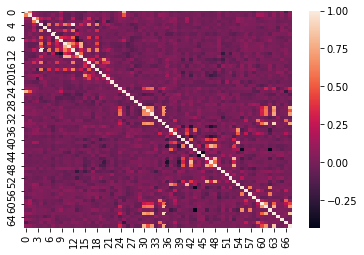

In [81]:
sns.heatmap(gammamat_Io_1p5)